# Import Libraries

In [4]:
pip install pmdarima


[notice] A new release of pip is available: 23.2 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [5]:
pip install prophet

Note: you may need to restart the kernel to use updated packages.Requirement already satisfied: prophet in c:\users\deira aisya\appdata\local\programs\python\python310\lib\site-packages (1.1.7)




[notice] A new release of pip is available: 23.2 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pmdarima import auto_arima
from sklearn.linear_model import LinearRegression
from prophet import Prophet

# Import Dataset

In [12]:
df = pd.read_csv('C:\\Users\\Deira Aisya\\UGM\\gamadata-2\\Full_Data_Garis_Kemiskinan_2004_2024_with_External_Features.csv')

In [13]:
df

,Unnamed: 0,Provinsi,Tahun,Garis Kemiskinan,Garis Kemiskinan Makanan Perkotaan Semester 1,Garis Kemiskinan Makanan Perkotaan Semester 2,Garis Kemiskinan Makanan Perdesaan Semester 1,Garis Kemiskinan Makanan Perdesaan Semester 2,Garis Kemiskinan Makanan Total Semester 1,Garis Kemiskinan Makanan Total Semester 2,...,Net Ekspor Triwulan II,Net Ekspor Triwulan III,Net Ekspor Triwulan IV,Net Ekspor Tahunan,PDRB Triwulan I,PDRB Triwulan II,PDRB Triwulan III,PDRB Triwulan IV,PDRB Tahunan,UMP
0,0,ACEH,2004,129615.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,550000.0
1,1,SUMATERA UTARA,2004,122615.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,537000.0
2,2,SUMATERA BARAT,2004,144704.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,480000.0
3,3,RIAU,2004,179589.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,476900.0
4,4,JAMBI,2004,129805.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,425000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
709,709,SULAWESI BARAT,2024,454879.0,360512.0,367828.0,350870.0,354319.0,352739.0,356950.0,...,1513.06,1533.84,377.63,4594.40,14869.16,16250.04,16197.37,16898.31,64214.88,NaN
710,710,MALUKU,2024,713503.0,521836.0,548623.0,525301.0,533738.0,523830.0,540629.0,...,-4388.17,-3753.47,-5961.56,-17153.28,14888.16,15469.46,15953.73,16334.89,62646.24,NaN
711,711,MALUKU UTARA,2024,604460.0,475521.0,497282.0,459804.0,484025.0,464529.0,487852.0,...,1578.01,222.48,2549.04,6014.60,21097.87,23578.50,22513.12,28598.18,95787.67,NaN
712,712,PAPUA BARAT,2024,793804.0,662195.0,679970.0,557986.0,573162.0,591923.0,609768.0,...,11419.74,12043.43,10824.70,42052.15,15877.08,20181.37,20234.18,19884.86,76177.48,NaN


# Notes: Only use data when the year is more than or equal to 2015

In [14]:
# Make a new daaframe with only the years after or equal to 2015
used_df = df[df['Tahun'] >= 2015]

In [15]:
used_df

,Unnamed: 0,Provinsi,Tahun,Garis Kemiskinan,Garis Kemiskinan Makanan Perkotaan Semester 1,Garis Kemiskinan Makanan Perkotaan Semester 2,Garis Kemiskinan Makanan Perdesaan Semester 1,Garis Kemiskinan Makanan Perdesaan Semester 2,Garis Kemiskinan Makanan Total Semester 1,Garis Kemiskinan Makanan Total Semester 2,...,Net Ekspor Triwulan II,Net Ekspor Triwulan III,Net Ekspor Triwulan IV,Net Ekspor Tahunan,PDRB Triwulan I,PDRB Triwulan II,PDRB Triwulan III,PDRB Triwulan IV,PDRB Tahunan,UMP
374,374,ACEH,2015,390150.0,293697.0,302128.0,297479.0,306737.0,296406.0,305428.0,...,-6688.63,-8125.71,-13927.70,-34383.20,31092.87,31845.82,33151.68,33002.30,129092.66,1900000.0
375,375,SUMATERA UTARA,2015,347953.0,261677.0,273271.0,266143.0,284650.0,263932.0,279015.0,...,5338.53,6187.52,3118.79,20944.25,138293.39,140489.04,145786.37,147153.21,571722.01,1625000.0
376,376,SUMATERA BARAT,2015,384277.0,288410.0,301356.0,293768.0,313294.0,291641.0,308554.0,...,1130.31,518.55,-2492.10,1643.72,43174.34,44338.45,45989.01,46450.18,179951.98,1615000.0
377,377,RIAU,2015,399211.0,280361.0,288956.0,302422.0,318195.0,293851.0,306835.0,...,48856.04,51018.91,50696.09,198789.13,154380.32,159365.88,167070.69,171944.73,652761.63,1878000.0
378,378,JAMBI,2015,343935.0,297507.0,308379.0,247652.0,258946.0,262791.0,273957.0,...,8972.03,6830.35,5784.45,30539.83,36898.73,38497.41,39560.45,40109.07,155065.66,1710000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
709,709,SULAWESI BARAT,2024,454879.0,360512.0,367828.0,350870.0,354319.0,352739.0,356950.0,...,1513.06,1533.84,377.63,4594.40,14869.16,16250.04,16197.37,16898.31,64214.88,NaN
710,710,MALUKU,2024,713503.0,521836.0,548623.0,525301.0,533738.0,523830.0,540629.0,...,-4388.17,-3753.47,-5961.56,-17153.28,14888.16,15469.46,15953.73,16334.89,62646.24,NaN
711,711,MALUKU UTARA,2024,604460.0,475521.0,497282.0,459804.0,484025.0,464529.0,487852.0,...,1578.01,222.48,2549.04,6014.60,21097.87,23578.50,22513.12,28598.18,95787.67,NaN
712,712,PAPUA BARAT,2024,793804.0,662195.0,679970.0,557986.0,573162.0,591923.0,609768.0,...,11419.74,12043.43,10824.70,42052.15,15877.08,20181.37,20234.18,19884.86,76177.48,NaN


In [16]:
used_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 340 entries, 374 to 713
Data columns (total 63 columns):
 #   Column                                             Non-Null Count  Dtype  
---  ------                                             --------------  -----  
 0   Unnamed: 0                                         340 non-null    int64  
 1   Provinsi                                           340 non-null    object 
 2   Tahun                                              340 non-null    int64  
 3   Garis Kemiskinan                                   340 non-null    float64
 4   Garis Kemiskinan Makanan Perkotaan Semester 1      340 non-null    float64
 5   Garis Kemiskinan Makanan Perkotaan Semester 2      340 non-null    float64
 6   Garis Kemiskinan Makanan Perdesaan Semester 1      340 non-null    float64
 7   Garis Kemiskinan Makanan Perdesaan Semester 2      340 non-null    float64
 8   Garis Kemiskinan Makanan Total Semester 1          340 non-null    float64
 9   Garis Kemiski

In [17]:
used_df = used_df.drop(columns=["Unnamed: 0"])

In [18]:
used_df

,Provinsi,Tahun,Garis Kemiskinan,Garis Kemiskinan Makanan Perkotaan Semester 1,Garis Kemiskinan Makanan Perkotaan Semester 2,Garis Kemiskinan Makanan Perdesaan Semester 1,Garis Kemiskinan Makanan Perdesaan Semester 2,Garis Kemiskinan Makanan Total Semester 1,Garis Kemiskinan Makanan Total Semester 2,Garis Kemiskinan Non Makanan Perkotaan Semester 1,...,Net Ekspor Triwulan II,Net Ekspor Triwulan III,Net Ekspor Triwulan IV,Net Ekspor Tahunan,PDRB Triwulan I,PDRB Triwulan II,PDRB Triwulan III,PDRB Triwulan IV,PDRB Tahunan,UMP
374,ACEH,2015,390150.0,293697.0,302128.0,297479.0,306737.0,296406.0,305428.0,116717.0,...,-6688.63,-8125.71,-13927.70,-34383.20,31092.87,31845.82,33151.68,33002.30,129092.66,1900000.0
375,SUMATERA UTARA,2015,347953.0,261677.0,273271.0,266143.0,284650.0,263932.0,279015.0,102643.0,...,5338.53,6187.52,3118.79,20944.25,138293.39,140489.04,145786.37,147153.21,571722.01,1625000.0
376,SUMATERA BARAT,2015,384277.0,288410.0,301356.0,293768.0,313294.0,291641.0,308554.0,117925.0,...,1130.31,518.55,-2492.10,1643.72,43174.34,44338.45,45989.01,46450.18,179951.98,1615000.0
377,RIAU,2015,399211.0,280361.0,288956.0,302422.0,318195.0,293851.0,306835.0,124441.0,...,48856.04,51018.91,50696.09,198789.13,154380.32,159365.88,167070.69,171944.73,652761.63,1878000.0
378,JAMBI,2015,343935.0,297507.0,308379.0,247652.0,258946.0,262791.0,273957.0,108566.0,...,8972.03,6830.35,5784.45,30539.83,36898.73,38497.41,39560.45,40109.07,155065.66,1710000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
709,SULAWESI BARAT,2024,454879.0,360512.0,367828.0,350870.0,354319.0,352739.0,356950.0,99300.0,...,1513.06,1533.84,377.63,4594.40,14869.16,16250.04,16197.37,16898.31,64214.88,NaN
710,MALUKU,2024,713503.0,521836.0,548623.0,525301.0,533738.0,523830.0,540629.0,202296.0,...,-4388.17,-3753.47,-5961.56,-17153.28,14888.16,15469.46,15953.73,16334.89,62646.24,NaN
711,MALUKU UTARA,2024,604460.0,475521.0,497282.0,459804.0,484025.0,464529.0,487852.0,166963.0,...,1578.01,222.48,2549.04,6014.60,21097.87,23578.50,22513.12,28598.18,95787.67,NaN
712,PAPUA BARAT,2024,793804.0,662195.0,679970.0,557986.0,573162.0,591923.0,609768.0,259955.0,...,11419.74,12043.43,10824.70,42052.15,15877.08,20181.37,20234.18,19884.86,76177.48,NaN


# Fixing Anomaly In Garis Kemiskinan Makanan Semester 2

In [19]:
semester2_cols = [col for col in used_df.columns if "Garis Kemiskinan Makanan" in col and "Semester 2" in col]

for prov in used_df['Provinsi'].unique():
    for col in semester2_cols:
        val_2022 = used_df.loc[
            (used_df['Provinsi'] == prov) & (used_df['Tahun'] == 2022), col
        ].values
        val_2024 = used_df.loc[
            (used_df['Provinsi'] == prov) & (used_df['Tahun'] == 2024), col
        ].values
        if len(val_2022) > 0 and len(val_2024) > 0:
            midpoint = (val_2022[0] + val_2024[0]) / 2
            used_df.loc[
                (used_df['Provinsi'] == prov) & (used_df['Tahun'] > 2022) & (used_df['Tahun'] < 2024), col
            ] = midpoint

# Handling Missing Values

In [20]:
used_df.isnull().sum()

Provinsi                                           0
Tahun                                              0
Garis Kemiskinan                                   0
Garis Kemiskinan Makanan Perkotaan Semester 1      0
Garis Kemiskinan Makanan Perkotaan Semester 2      0
                                                ... 
PDRB Triwulan II                                   0
PDRB Triwulan III                                  0
PDRB Triwulan IV                                   0
PDRB Tahunan                                       0
UMP                                              170
Length: 62, dtype: int64

## UMP

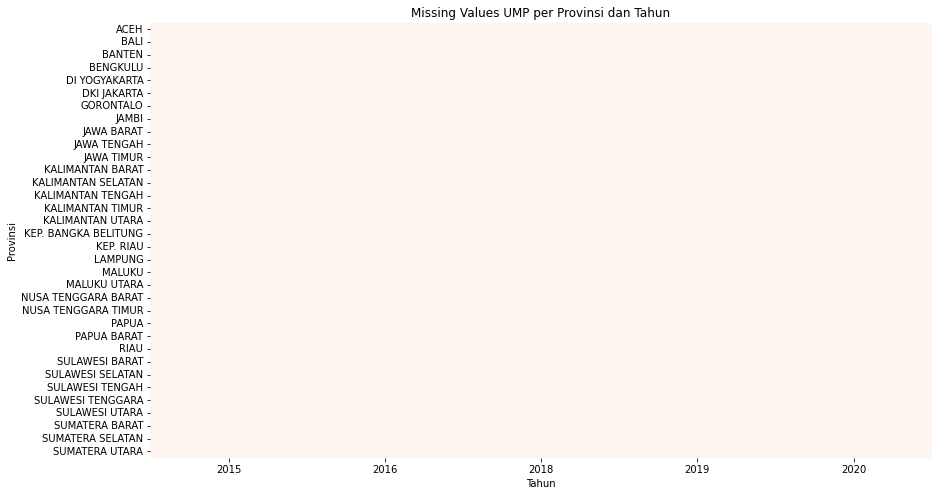

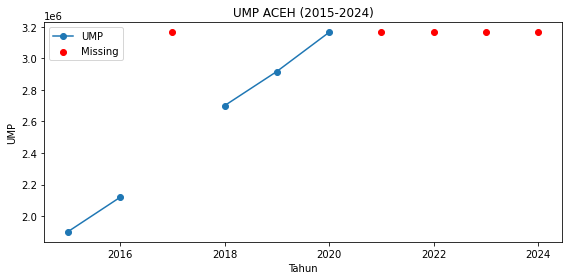

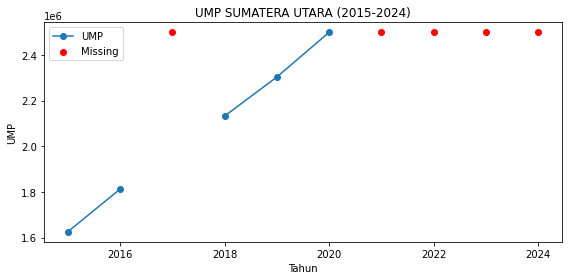

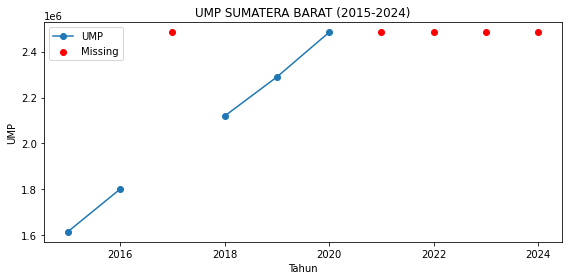

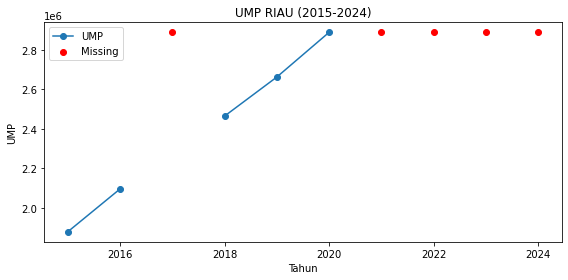

...

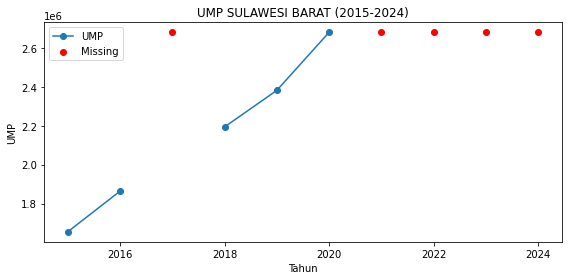

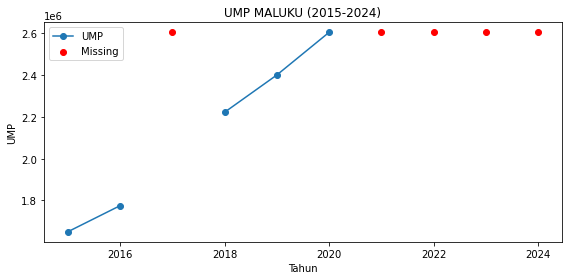

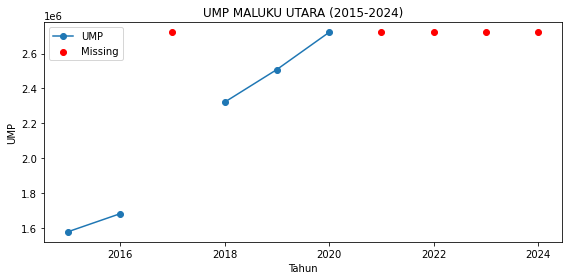

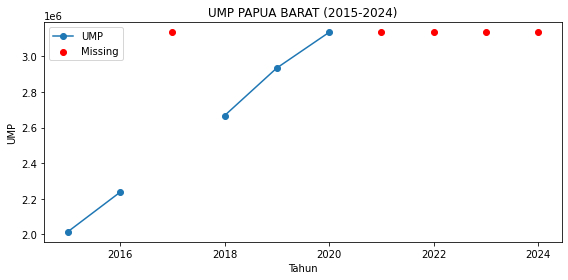

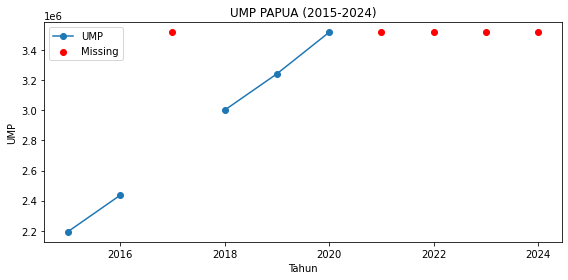

In [21]:
import matplotlib.pyplot as plt
import seaborn as sns

# Ganti 'UMP' dengan nama kolom UMP yang sesuai di dataset kamu
ump_cols = [col for col in used_df.columns if 'UMP' in col]

# --- 1. Heatmap missing values UMP per provinsi dan tahun ---
plt.figure(figsize=(14, 8))
ump_pivot = used_df.pivot_table(index='Provinsi', columns='Tahun', values=ump_cols[0])
sns.heatmap(ump_pivot.isnull(), cmap='Reds', cbar=False)
plt.title('Missing Values UMP per Provinsi dan Tahun')
plt.xlabel('Tahun')
plt.ylabel('Provinsi')
plt.show()

# --- 2. Lineplot UMP per provinsi, highlight missing ---
for prov in used_df['Provinsi'].unique():
    df_prov = used_df[used_df['Provinsi'] == prov]
    plt.figure(figsize=(8, 4))
    plt.plot(df_prov['Tahun'], df_prov[ump_cols[0]], marker='o', label='UMP')
    # Highlight missing
    missing_years = df_prov[df_prov[ump_cols[0]].isna()]['Tahun']
    plt.scatter(missing_years, [df_prov[ump_cols[0]].max()]*len(missing_years), color='red', label='Missing', zorder=5)
    plt.title(f'UMP {prov} (2015-2024)')
    plt.xlabel('Tahun')
    plt.ylabel('UMP')
    plt.legend()
    plt.tight_layout()
    plt.show()

In [22]:
# Imputasi UMP yang hilang (misal tahun 2017) dengan midpoint antara tahun sebelumnya dan sesudahnya, per provinsi
ump_cols = [col for col in used_df.columns if 'UMP' in col]

for ump_col in ump_cols:
    for prov in used_df['Provinsi'].unique():
        # Cek tahun yang missing
        df_prov = used_df[used_df['Provinsi'] == prov]
        missing_years = df_prov[df_prov[ump_col].isna()]['Tahun']
        for year in missing_years:
            prev_year = year - 1
            next_year = year + 1
            prev_val = df_prov[df_prov['Tahun'] == prev_year][ump_col].values
            next_val = df_prov[df_prov['Tahun'] == next_year][ump_col].values
            if len(prev_val) > 0 and len(next_val) > 0 and not np.isnan(prev_val[0]) and not np.isnan(next_val[0]):
                midpoint = (prev_val[0] + next_val[0]) / 2
                used_df.loc[(used_df['Provinsi'] == prov) & (used_df['Tahun'] == year), ump_col] = midpoint

In [23]:
ump_cols = [col for col in used_df.columns if 'UMP' in col]

for ump_col in ump_cols:
    for prov in used_df['Provinsi'].unique():
        df_prov = used_df[used_df['Provinsi'] == prov].sort_values('Tahun')
        # Data UMP yang sudah ada (sebelum 2021)
        df_train = df_prov[(df_prov['Tahun'] < 2021) & (~df_prov[ump_col].isna())]
        if len(df_train) > 3:
            y_train = df_train[ump_col].values
            model = auto_arima(y_train, d=1, seasonal=False, suppress_warnings=True, stepwise=True)
            n_forecast = 2024 - 2020
            forecast = model.predict(n_periods=n_forecast)
            tahun_prediksi = np.arange(2021, 2025)
            for i, year in enumerate(tahun_prediksi):
                mask = (used_df['Provinsi'] == prov) & (used_df['Tahun'] == year)
                if used_df.loc[mask, ump_col].isna().any():
                    used_df.loc[mask, ump_col] = forecast[i]

### Indeks Keparahan

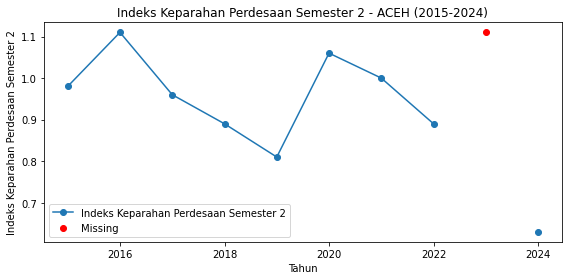

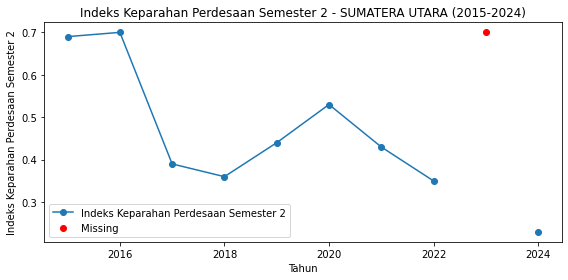

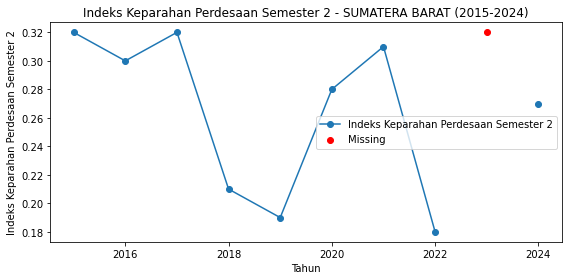

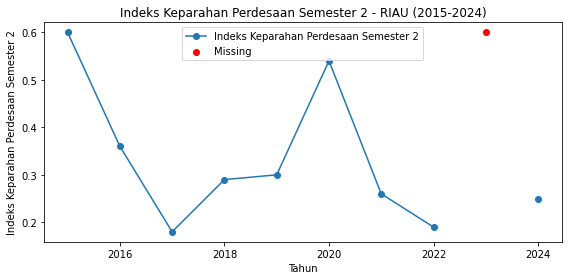

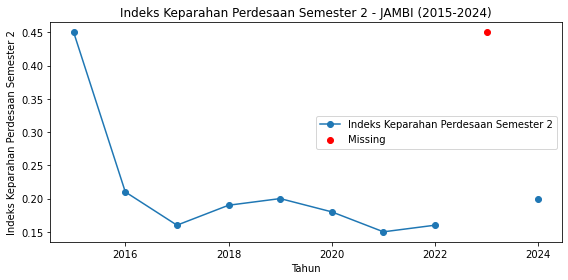

...

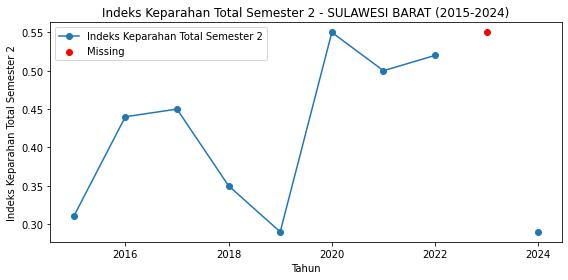

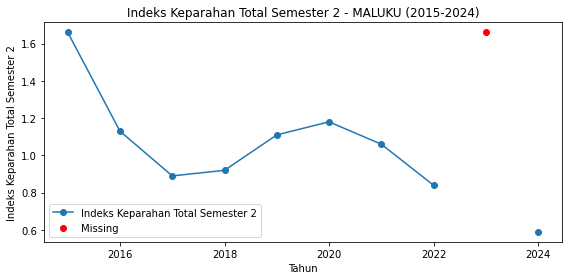

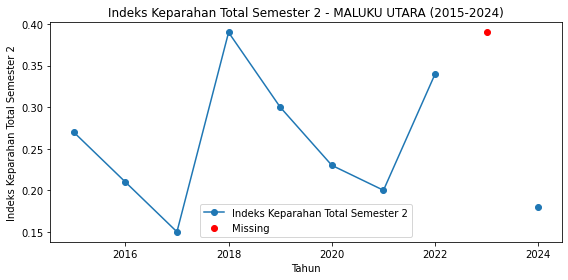

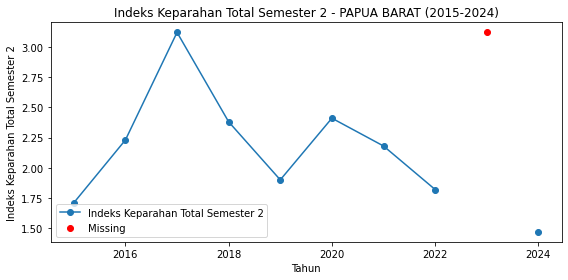

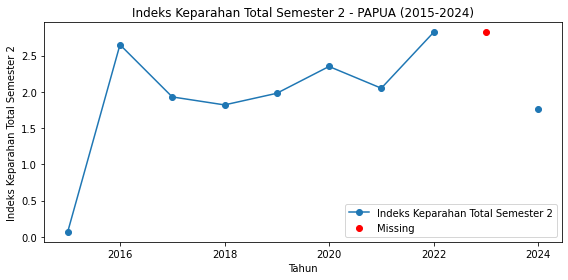

In [24]:
import matplotlib.pyplot as plt

# Daftar kolom yang ingin divisualisasikan
cols = [
    'Indeks Keparahan Perdesaan Semester 2',
    'Indeks Keparahan Perkotaan Semester 2',
    'Indeks Keparahan Total Semester 2'
]

for col in cols:
    for prov in used_df['Provinsi'].unique():
        df_prov = used_df[used_df['Provinsi'] == prov]
        plt.figure(figsize=(8, 4))
        plt.plot(df_prov['Tahun'], df_prov[col], marker='o', label=col)
        # Highlight missing
        missing_years = df_prov[df_prov[col].isna()]['Tahun']
        plt.scatter(missing_years, [df_prov[col].max()]*len(missing_years), color='red', label='Missing', zorder=5)
        plt.title(f'{col} - {prov} (2015-2024)')
        plt.xlabel('Tahun')
        plt.ylabel(col)
        plt.legend()
        plt.tight_layout()
        plt.show()

In [25]:
cols = [
    'Indeks Keparahan Perdesaan Semester 2',
    'Indeks Keparahan Perkotaan Semester 2',
    'Indeks Keparahan Total Semester 2'
]

for col in cols:
    for prov in used_df['Provinsi'].unique():
        df_prov = used_df[used_df['Provinsi'] == prov]
        missing_years = df_prov[df_prov[col].isna()]['Tahun']
        for year in missing_years:
            # Khusus Perdesaan & DKI JAKARTA, isi 0
            if col == 'Indeks Keparahan Perdesaan Semester 2' and prov.upper() == 'DKI JAKARTA':
                used_df.loc[(used_df['Provinsi'] == prov) & (used_df['Tahun'] == year), col] = 0
            else:
                prev_year = year - 1
                next_year = year + 1
                prev_val = df_prov[df_prov['Tahun'] == prev_year][col].values
                next_val = df_prov[df_prov['Tahun'] == next_year][col].values
                if len(prev_val) > 0 and len(next_val) > 0 and not np.isnan(prev_val[0]) and not np.isnan(next_val[0]):
                    midpoint = (prev_val[0] + next_val[0]) / 2
                    used_df.loc[(used_df['Provinsi'] == prov) & (used_df['Tahun'] == year), col] = midpoint

In [26]:
used_df.isnull().sum()

Provinsi                                         0
Tahun                                            0
Garis Kemiskinan                                 0
Garis Kemiskinan Makanan Perkotaan Semester 1    0
Garis Kemiskinan Makanan Perkotaan Semester 2    0
                                                ..
PDRB Triwulan II                                 0
PDRB Triwulan III                                0
PDRB Triwulan IV                                 0
PDRB Tahunan                                     0
UMP                                              0
Length: 62, dtype: int64

In [27]:
used_df.loc[
    (used_df['Provinsi'].str.upper() == 'DKI JAKARTA') &
    (used_df['Indeks Keparahan Perdesaan Semester 1'].isna()),
    'Indeks Keparahan Perdesaan Semester 1'
] = 0

### Garis Kemiskinan

In [28]:
cols = [
    "Garis Kemiskinan Non Makanan Perdesaan Semester 1",
    "Garis Kemiskinan Non Makanan Perdesaan Semester 2"
]

for col in cols:
    missing = used_df[used_df[col].isnull()][["Provinsi", "Tahun"]]
    print(f"Missing values for {col}:")
    print(missing)
    print("="*50)

Missing values for Garis Kemiskinan Non Makanan Perdesaan Semester 1:
        Provinsi  Tahun
384  DKI JAKARTA   2015
418  DKI JAKARTA   2016
452  DKI JAKARTA   2017
486  DKI JAKARTA   2018
520  DKI JAKARTA   2019
554  DKI JAKARTA   2020
588  DKI JAKARTA   2021
622  DKI JAKARTA   2022
656  DKI JAKARTA   2023
690  DKI JAKARTA   2024
Missing values for Garis Kemiskinan Non Makanan Perdesaan Semester 2:
        Provinsi  Tahun
384  DKI JAKARTA   2015
418  DKI JAKARTA   2016
452  DKI JAKARTA   2017
486  DKI JAKARTA   2018
520  DKI JAKARTA   2019
554  DKI JAKARTA   2020
588  DKI JAKARTA   2021
622  DKI JAKARTA   2022
656  DKI JAKARTA   2023
690  DKI JAKARTA   2024


In [29]:
for col in [
    "Garis Kemiskinan Non Makanan Perdesaan Semester 1",
    "Garis Kemiskinan Non Makanan Perdesaan Semester 2"
]:
    used_df.loc[
        (used_df['Provinsi'].str.upper() == 'DKI JAKARTA') & (used_df[col].isna()),
        col
    ] = 0

## Visualization All Columns by Province and Year

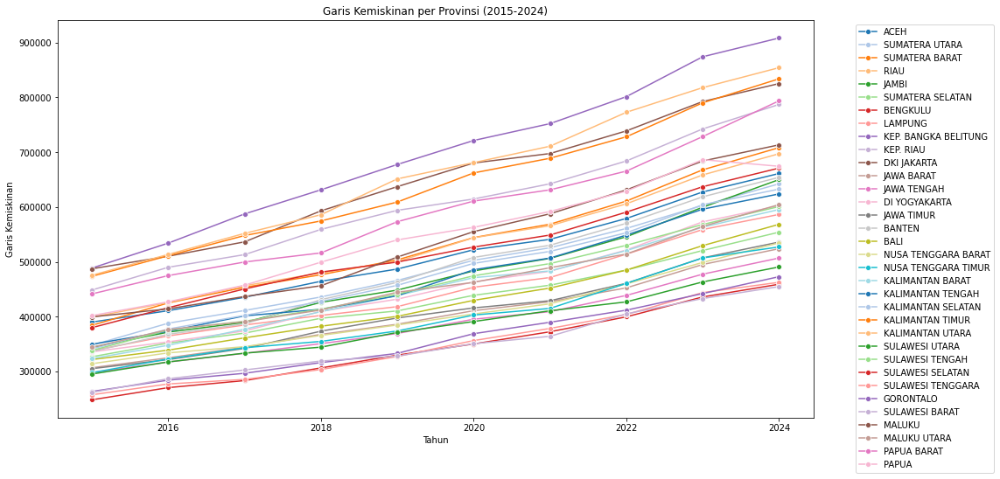

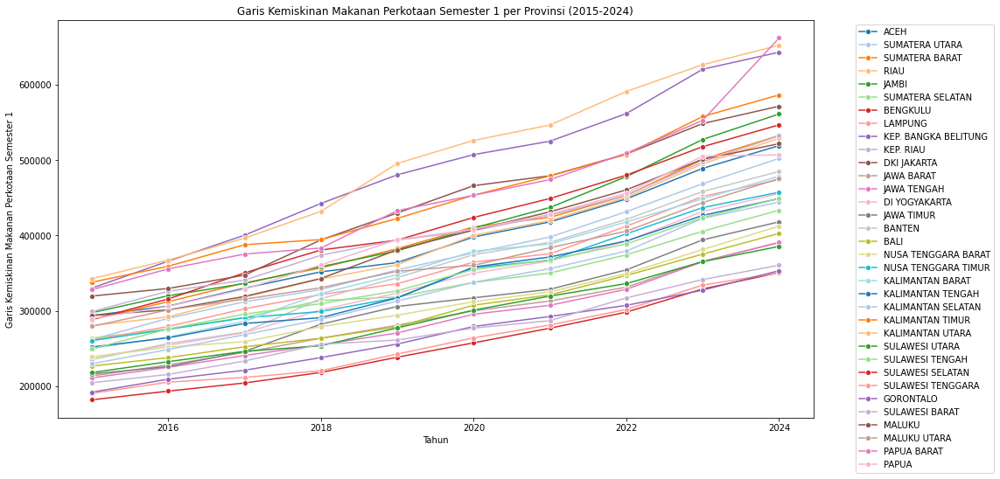

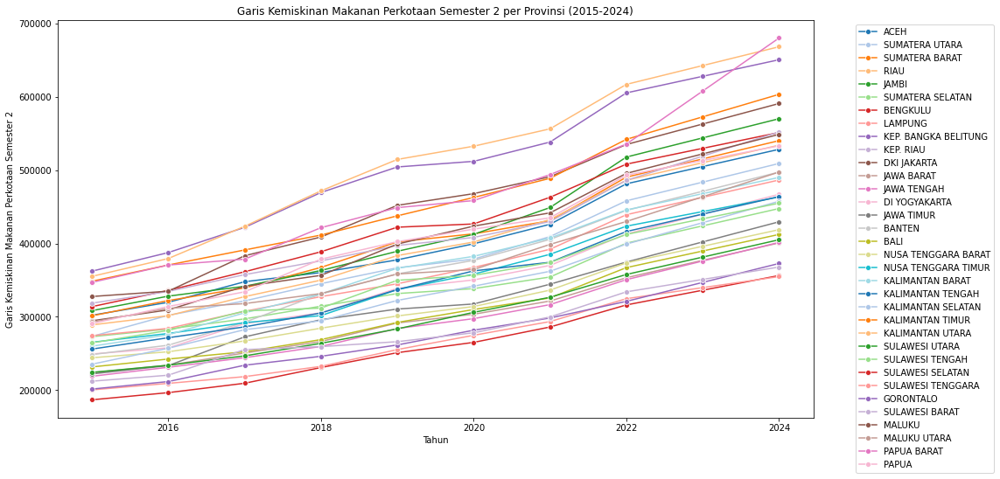

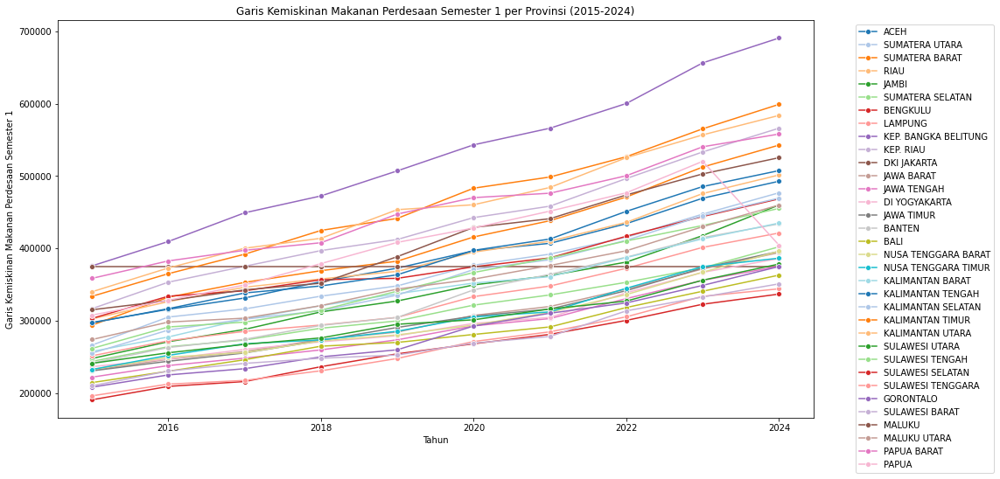

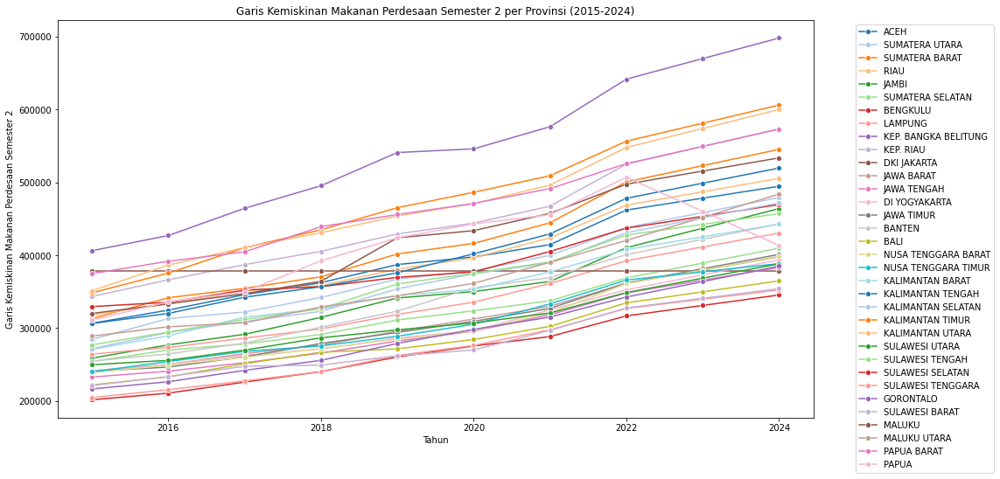

...

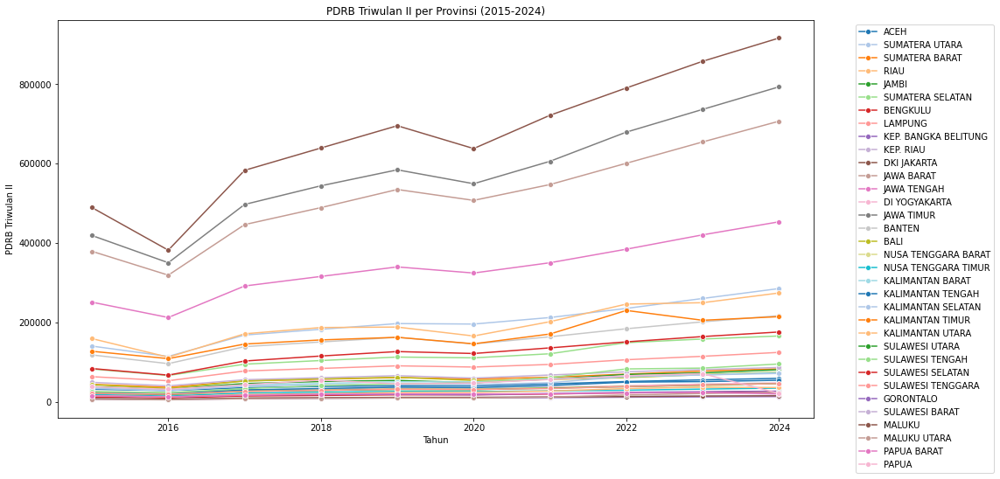

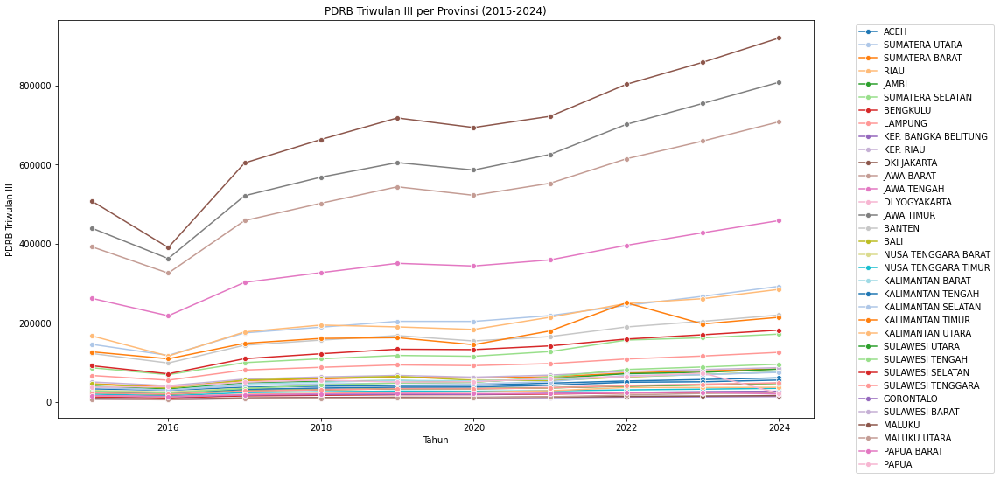

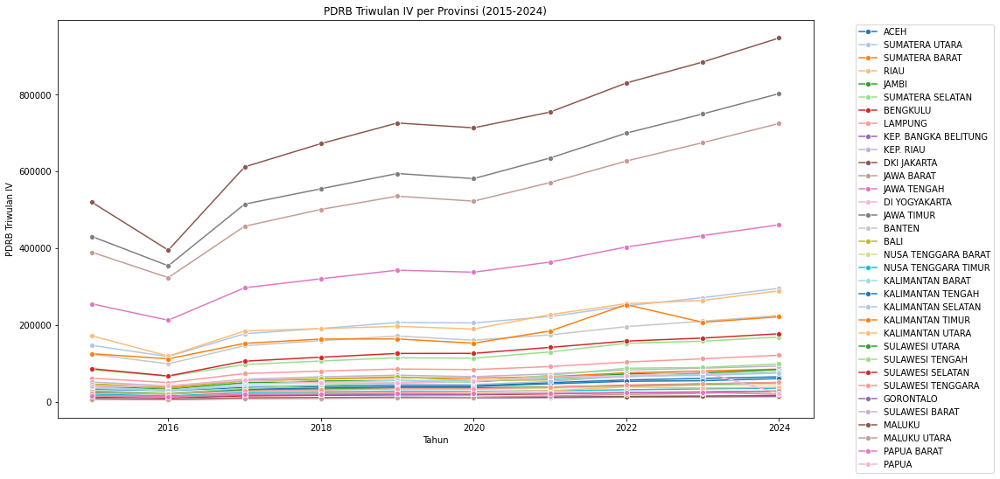

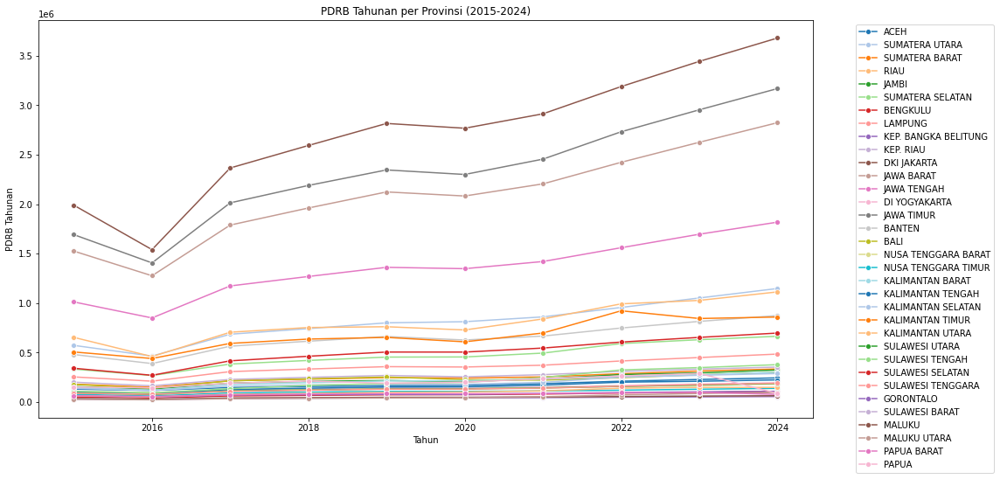

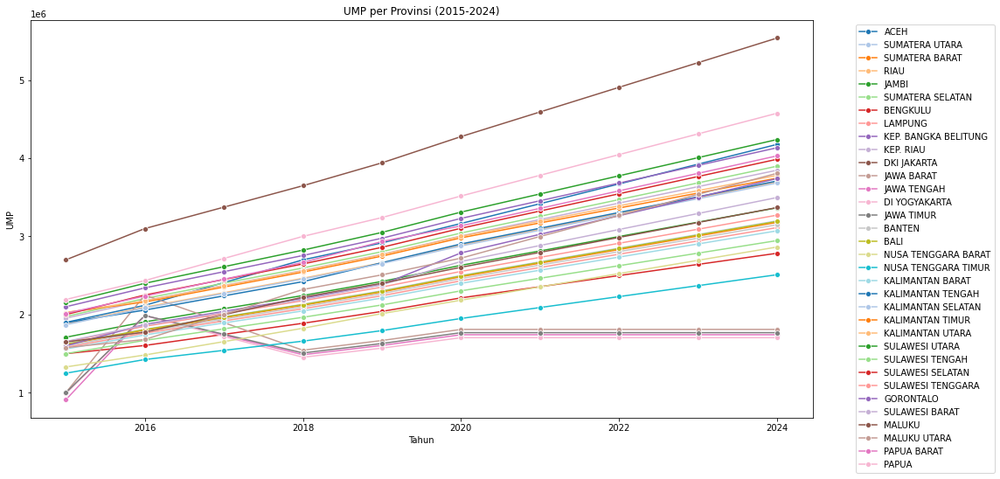

In [30]:
# Visualisasi semua kolom numerik (kecuali Provinsi dan Tahun) per provinsi

exclude_cols = ["Provinsi", "Tahun"]
num_cols = [col for col in used_df.columns if col not in exclude_cols]

for col in num_cols:
    plt.figure(figsize=(16, 8))
    palette = sns.color_palette("tab20", n_colors=used_df["Provinsi"].nunique())
    sns.lineplot(
        data=used_df,
        x="Tahun",
        y=col,
        hue="Provinsi",
        marker="o",
        palette=palette
    )
    plt.title(f"{col} per Provinsi (2015-2024)")
    plt.ylabel(col)
    plt.xlabel("Tahun")
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

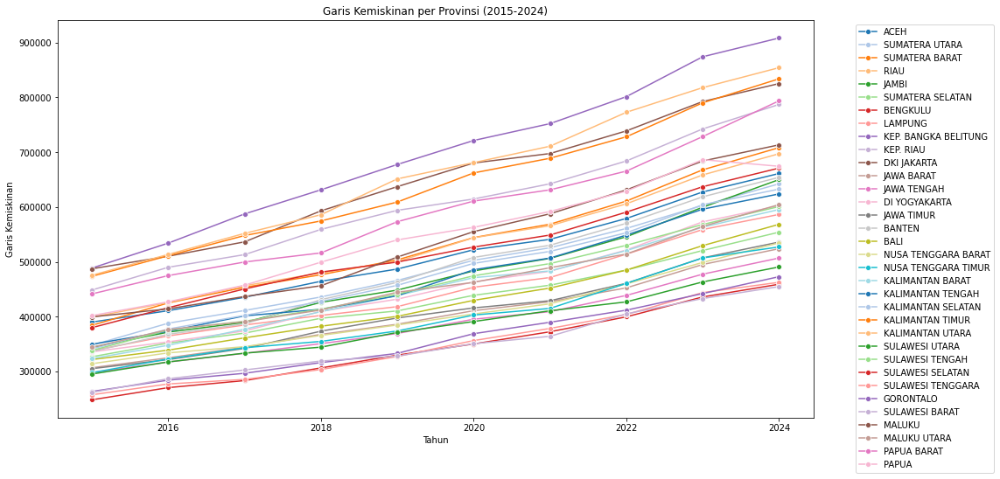

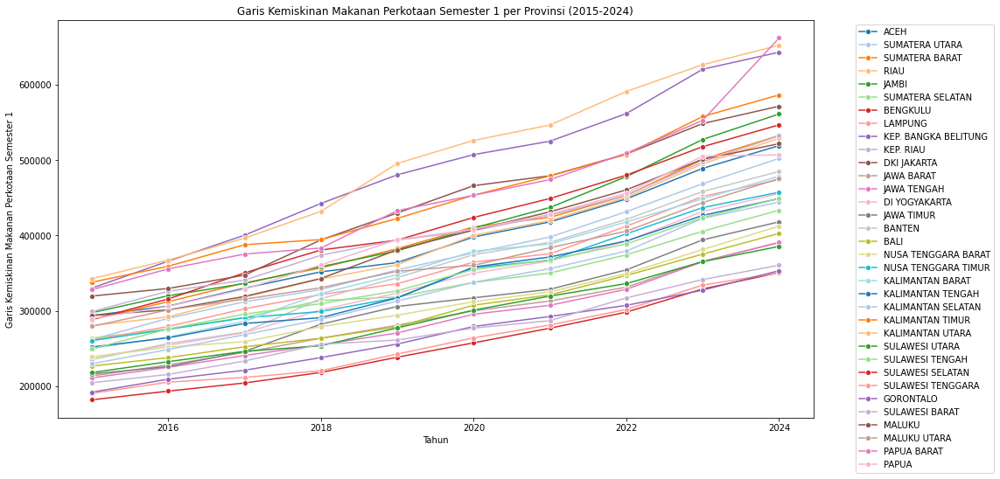

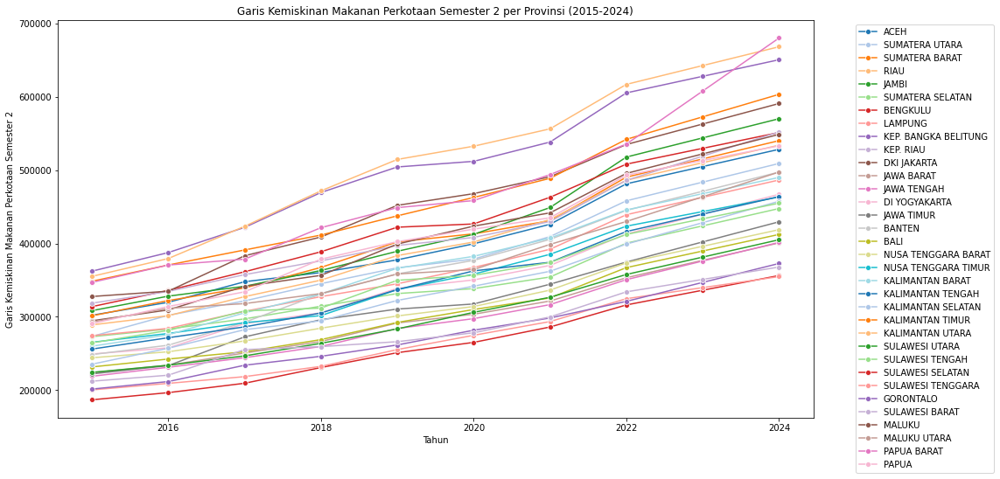

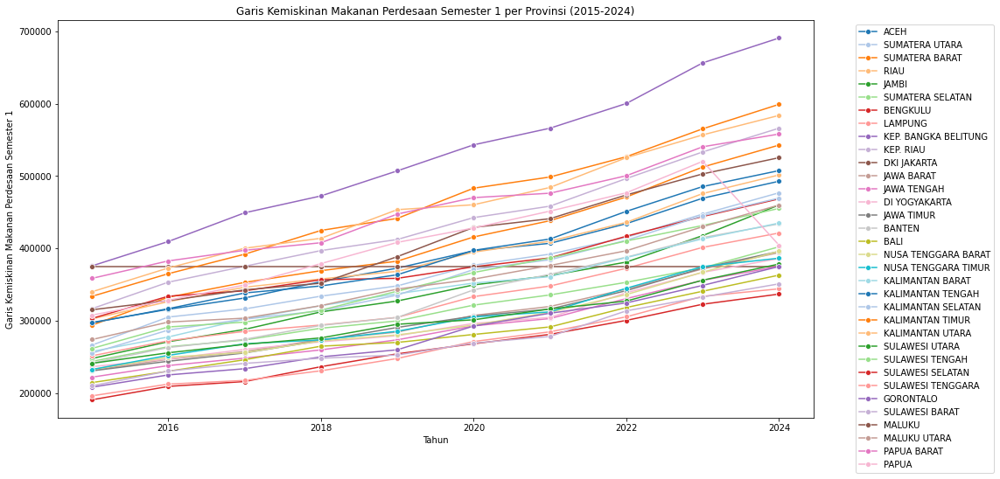

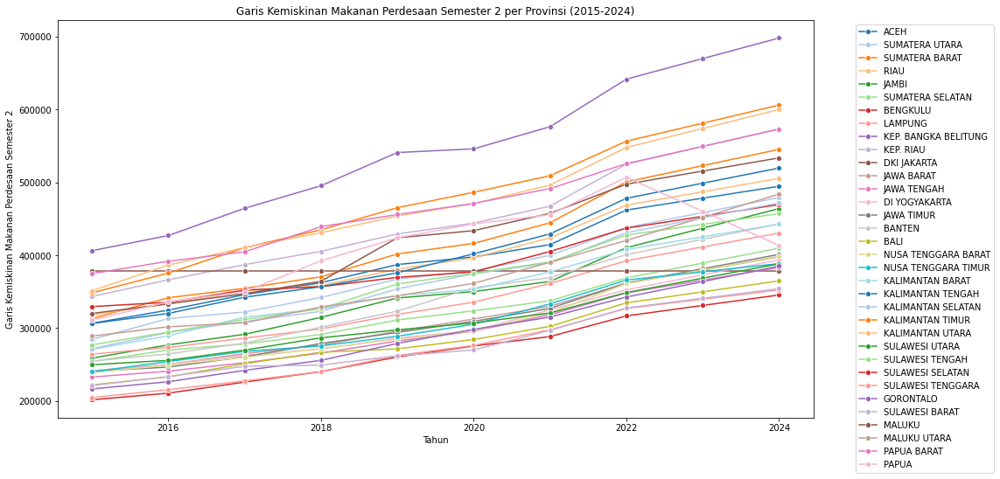

...

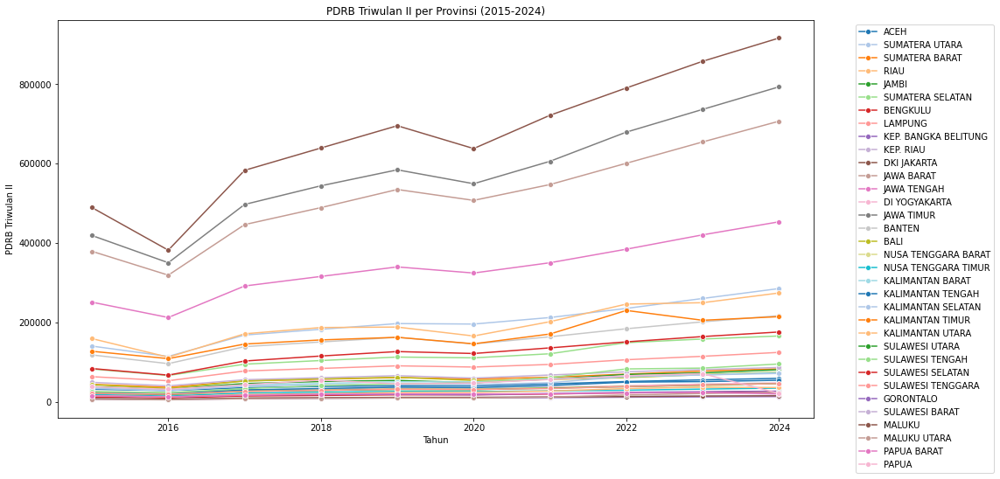

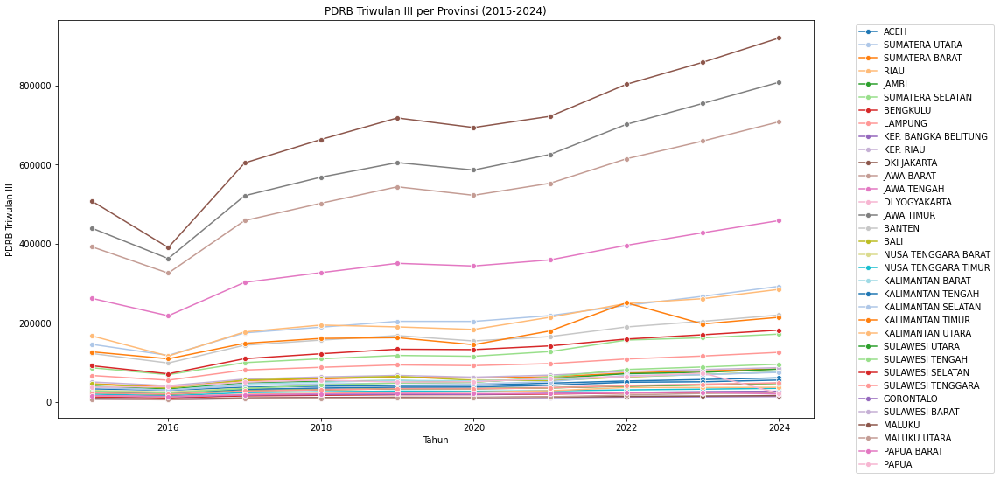

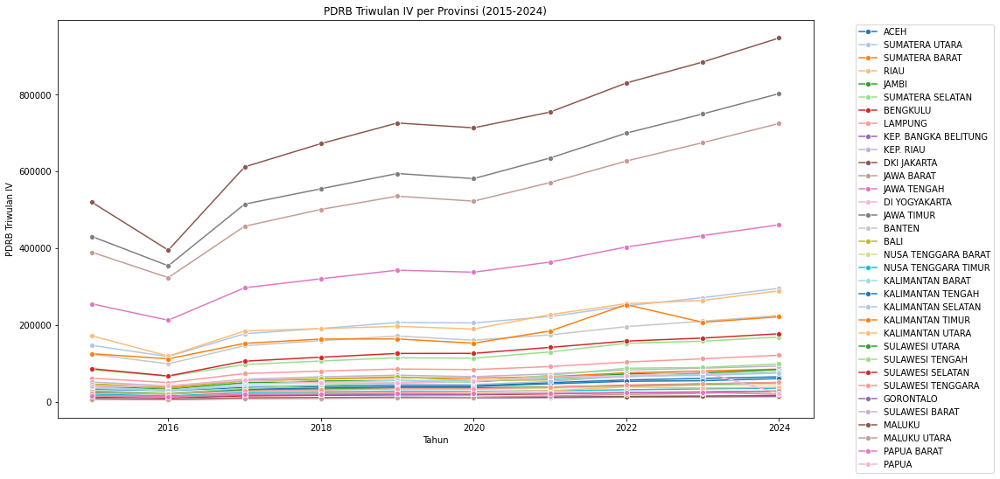

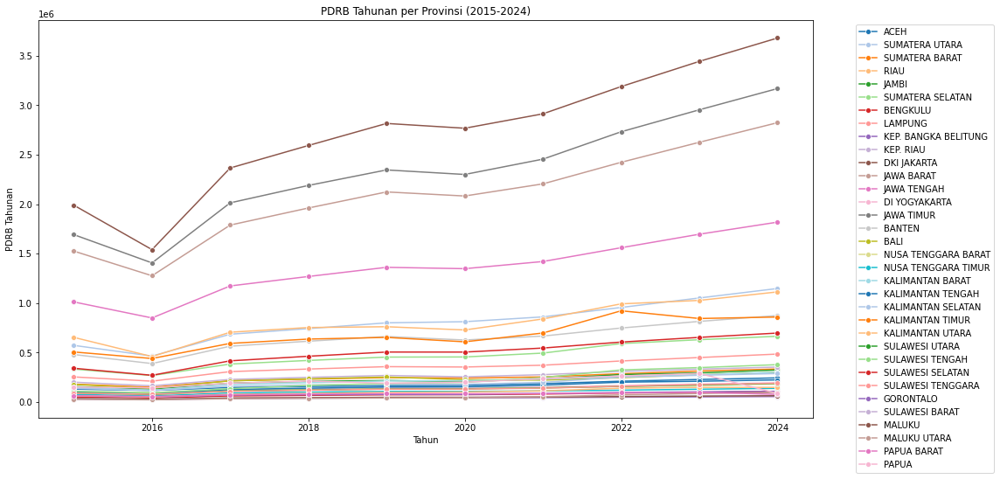

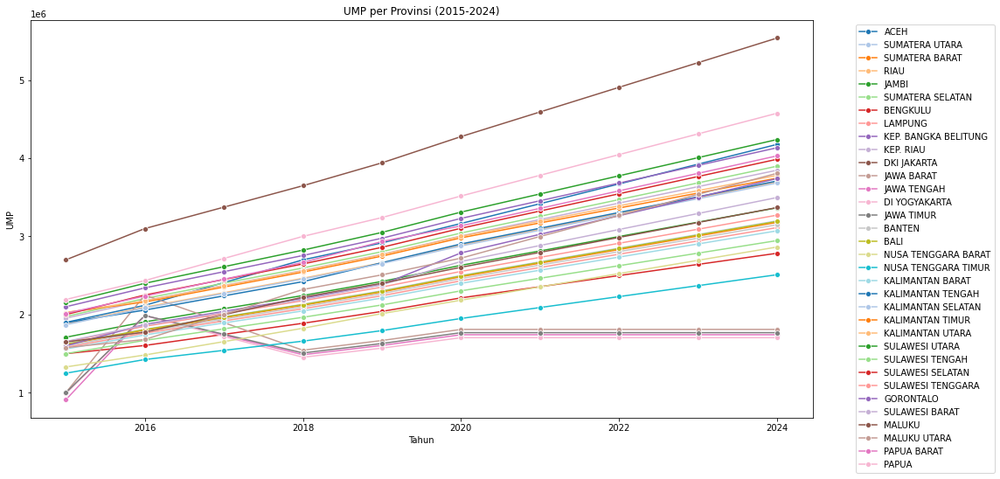

In [31]:
# Visualisasi semua kolom numerik (kecuali Provinsi dan Tahun) per provinsi

exclude_cols = ["Provinsi", "Tahun"]
num_cols = [col for col in used_df.columns if col not in exclude_cols]

for col in num_cols:
    plt.figure(figsize=(16, 8))
    palette = sns.color_palette("tab20", n_colors=used_df["Provinsi"].nunique())
    sns.lineplot(
        data=used_df,
        x="Tahun",
        y=col,
        hue="Provinsi",
        marker="o",
        palette=palette
    )
    plt.title(f"{col} per Provinsi (2015-2024)")
    plt.ylabel(col)
    plt.xlabel("Tahun")
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

## Forecasting with Auto ARIMA (Univariate, Using Tahun Only)

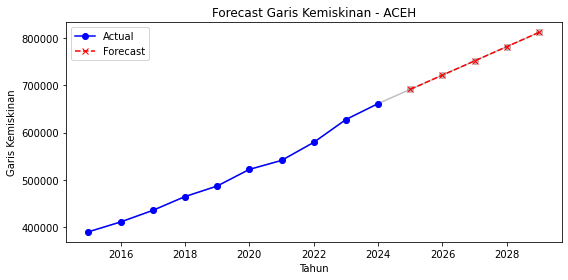

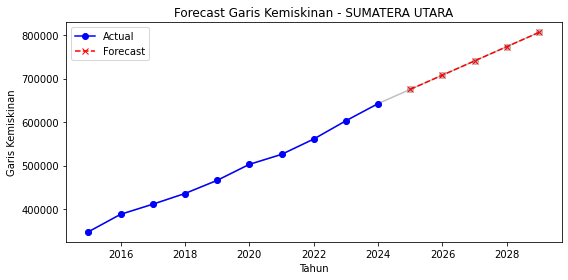

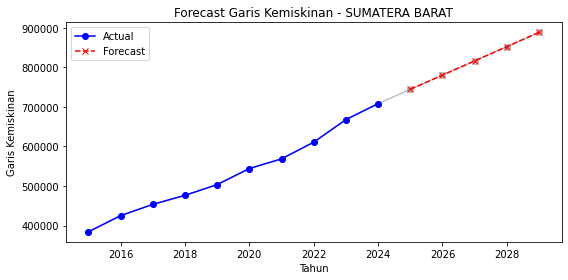

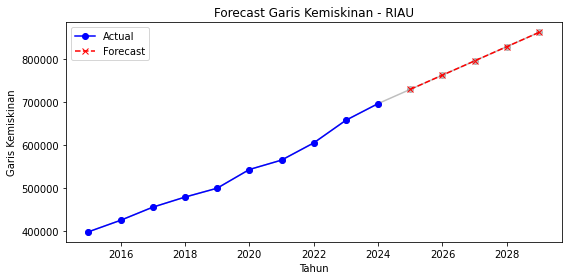

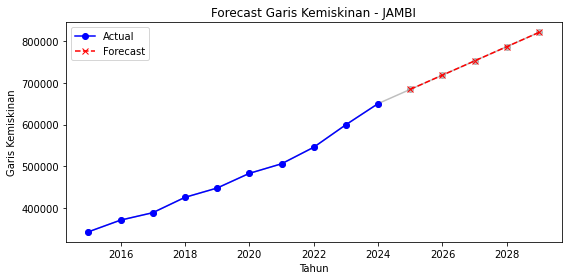

...

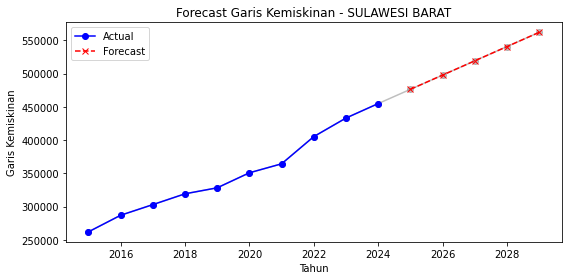

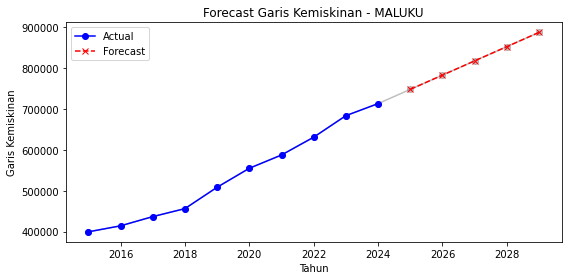

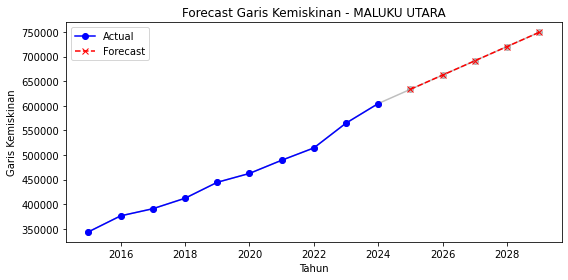

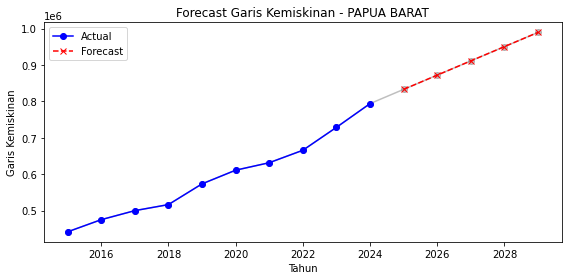

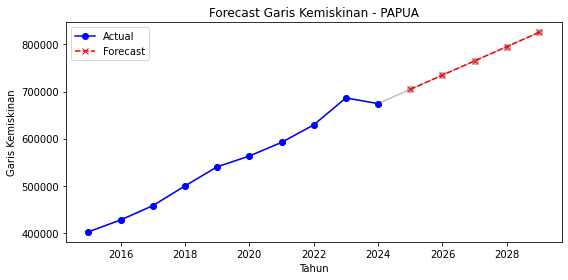

In [32]:
forecast_horizon = 5

provinsi_list = used_df['Provinsi'].unique()
forecast_results = {}

for prov in provinsi_list:
    data_prov = used_df[used_df['Provinsi'] == prov].sort_values('Tahun')
    series = data_prov['Garis Kemiskinan'].values

    model = auto_arima(series, d=1, seasonal=False, suppress_warnings=True, stepwise=True)
    forecast = model.predict(n_periods=forecast_horizon)
    forecast_results[prov] = forecast

    # Gabungkan data actual dan forecast untuk plot nyambung
    tahun_actual = data_prov['Tahun'].values
    tahun_forecast = np.arange(tahun_actual[-1] + 1, tahun_actual[-1] + 1 + forecast_horizon)
    tahun_all = np.concatenate([tahun_actual, tahun_forecast])
    series_all = np.concatenate([series, forecast])

    plt.figure(figsize=(8, 4))
    # Plot seluruh garis (actual + forecast)
    plt.plot(tahun_all, series_all, marker='o', color='gray', alpha=0.5, label='_nolegend_')
    # Plot actual
    plt.plot(tahun_actual, series, marker='o', color='blue', label='Actual')
    # Plot forecast
    plt.plot(tahun_forecast, forecast, marker='x', linestyle='--', color='red', label='Forecast')
    plt.title(f'Forecast Garis Kemiskinan - {prov}')
    plt.xlabel('Tahun')
    plt.ylabel('Garis Kemiskinan')
    plt.legend()
    plt.tight_layout()
    plt.show()

with open("forecasting_with_autoarima_result.txt", "w") as f:
    for prov, forecast in forecast_results.items():
        tahun_terakhir = used_df[used_df['Provinsi'] == prov]['Tahun'].max()
        for i, nilai in enumerate(forecast):
            tahun_prediksi = tahun_terakhir + 1 + i
            f.write(f"{prov} {tahun_prediksi} = {nilai:.2f}\n")

In [33]:
for prov, forecast in forecast_results.items():
    print(f"\n{prov}")
    tahun_terakhir = used_df[used_df['Provinsi'] == prov]['Tahun'].max()
    for i, nilai in enumerate(forecast):
        tahun_prediksi = tahun_terakhir + 1 + i
        print(f"{tahun_prediksi} = {nilai:.2f}")


ACEH
2025 = 691346.67
2026 = 721466.33
2027 = 751586.00
2028 = 781705.67
2029 = 811825.33

SUMATERA UTARA
2025 = 675141.89
2026 = 707860.78
2027 = 740579.67
2028 = 773298.56
2029 = 806017.44

SUMATERA BARAT
2025 = 744431.44
2026 = 780446.89
2027 = 816462.33
2028 = 852477.78
2029 = 888493.22

RIAU
2025 = 730416.56
2026 = 763537.11
2027 = 796657.67
2028 = 829778.22
2029 = 862898.78

JAMBI
2025 = 684135.00
2026 = 718155.00
2027 = 752175.00
2028 = 786195.00
2029 = 820215.00

SUMATERA SELATAN
2025 = 579451.67
2026 = 604706.33
2027 = 629961.00
2028 = 655215.67
2029 = 680470.33

BENGKULU
2025 = 703435.67
2026 = 735776.33
2027 = 768117.00
2028 = 800457.67
2029 = 832798.33

LAMPUNG
2025 = 614168.22
2026 = 641785.44
2027 = 669402.67
2028 = 697019.89
2029 = 724637.11

KEP. BANGKA BELITUNG
2025 = 955029.89
2026 = 1001662.78
2027 = 1048295.67
2028 = 1094928.56
2029 = 1141561.44

KEP. RIAU
2025 = 824828.67
2026 = 862446.33
2027 = 900064.00
2028 = 937681.67
2029 = 975299.33

DKI JAKARTA
2025 = 86283

## Forecasting with Linear Regression (Univariate, Using Tahun Only)

Since the Garis Kemiskinan data is seems to be linear (not a perfect linear because there are some fluctuations, but mostly are linear), we can use linear regression.

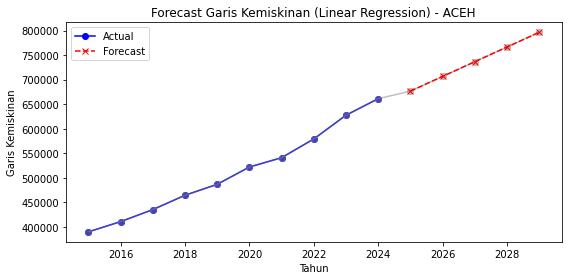

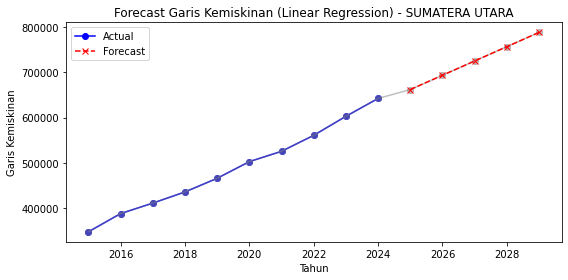

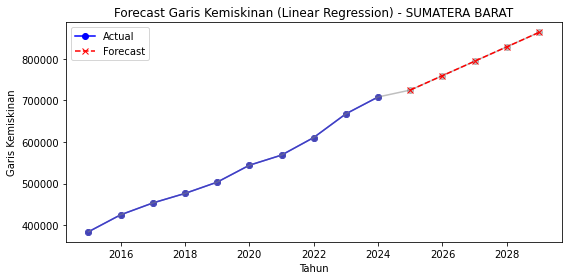

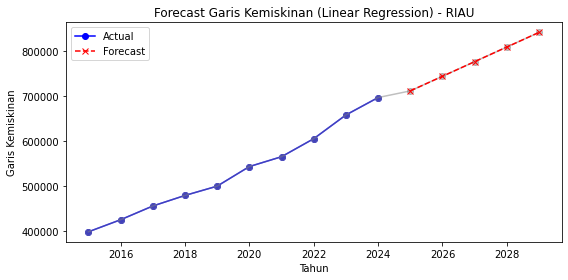

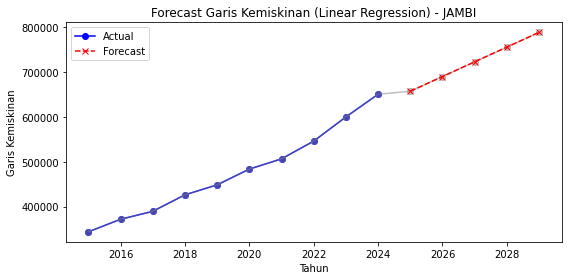

...

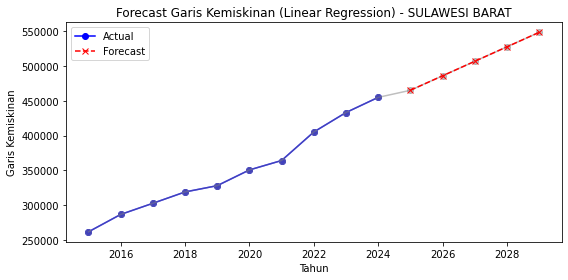

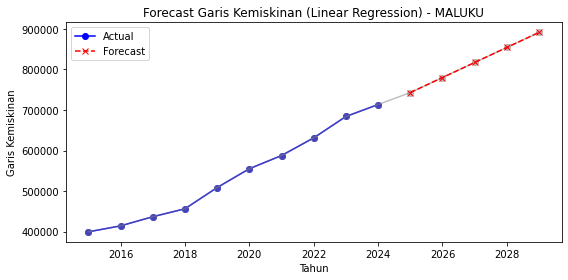

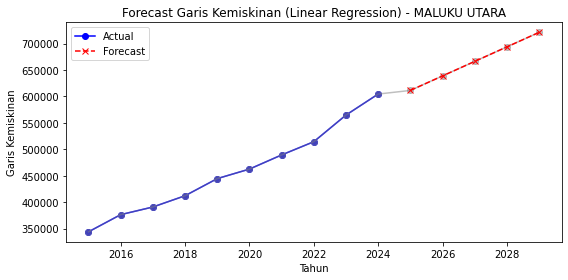

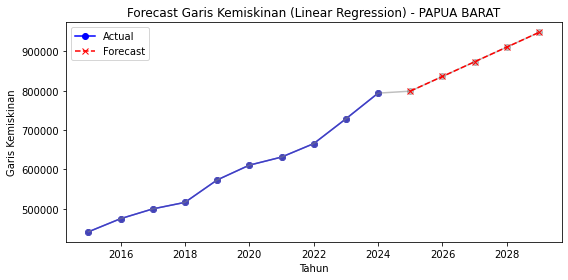

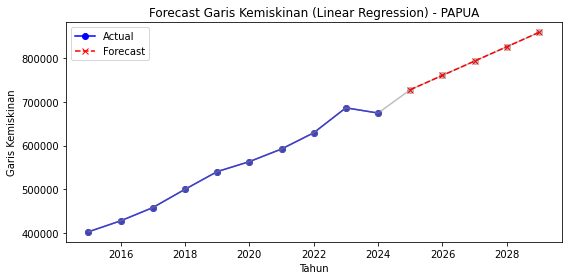

In [34]:
forecast_horizon = 5
provinsi_list = used_df['Provinsi'].unique()
forecast_results_lr = {}

for prov in provinsi_list:
    data_prov = used_df[used_df['Provinsi'] == prov].sort_values('Tahun')
    X = data_prov['Tahun'].values.reshape(-1, 1)
    y = data_prov['Garis Kemiskinan'].values

    model = LinearRegression()
    model.fit(X, y)

    tahun_terakhir = X[-1, 0]
    tahun_forecast = np.arange(tahun_terakhir + 1, tahun_terakhir + 1 + forecast_horizon).reshape(-1, 1)
    forecast = model.predict(tahun_forecast)
    forecast_results_lr[prov] = forecast

    plt.figure(figsize=(8, 4))
    plt.plot(X.flatten(), y, marker='o', color='blue', label='Actual')
    plt.plot(
        np.concatenate([X.flatten(), tahun_forecast.flatten()]),
        np.concatenate([y, forecast]),
        marker='o', color='gray', alpha=0.5, label='_nolegend_'
    )
    plt.plot(tahun_forecast.flatten(), forecast, marker='x', linestyle='--', color='red', label='Forecast')
    plt.title(f'Forecast Garis Kemiskinan (Linear Regression) - {prov}')
    plt.xlabel('Tahun')
    plt.ylabel('Garis Kemiskinan')
    plt.legend()
    plt.tight_layout()
    plt.show()

with open("forecasting_with_linearregression_result.txt", "w") as f:
    for prov, forecast in forecast_results_lr.items():
        tahun_terakhir = used_df[used_df['Provinsi'] == prov]['Tahun'].max()
        for i, nilai in enumerate(forecast):
            tahun_prediksi = tahun_terakhir + 1 + i
            f.write(f"{prov} {tahun_prediksi} = {nilai:.2f}\n")

In [35]:
with open("forecasting_with_linearregression_result.txt", "r") as f:
    print(f.read())

ACEH 2025 = 676575.87
ACEH 2026 = 706510.68
ACEH 2027 = 736445.49
ACEH 2028 = 766380.30
ACEH 2029 = 796315.12
SUMATERA UTARA 2025 = 662082.07
SUMATERA UTARA 2026 = 693649.13
SUMATERA UTARA 2027 = 725216.20
SUMATERA UTARA 2028 = 756783.27
SUMATERA UTARA 2029 = 788350.33
SUMATERA BARAT 2025 = 725036.73
SUMATERA BARAT 2026 = 759706.39
SUMATERA BARAT 2027 = 794376.05
SUMATERA BARAT 2028 = 829045.72
SUMATERA BARAT 2029 = 863715.38
RIAU 2025 = 712059.20
RIAU 2026 = 744541.35
RIAU 2027 = 777023.49
RIAU 2028 = 809505.64
RIAU 2029 = 841987.78
JAMBI 2025 = 656807.80
JAMBI 2026 = 689577.65
JAMBI 2027 = 722347.51
JAMBI 2028 = 755117.36
JAMBI 2029 = 787887.22
SUMATERA SELATAN 2025 = 565030.93
SUMATERA SELATAN 2026 = 589342.98
SUMATERA SELATAN 2027 = 613655.02
SUMATERA SELATAN 2028 = 637967.06
SUMATERA SELATAN 2029 = 662279.10
BENGKULU 2025 = 690148.73
BENGKULU 2026 = 721027.68
BENGKULU 2027 = 751906.64
BENGKULU 2028 = 782785.59
BENGKULU 2029 = 813664.54
LAMPUNG 2025 = 598793.00
LAMPUNG 2026 = 62597

## Forecasting with Prophet (Univariate, Using Tahun Only)

18:49:38 - cmdstanpy - INFO - Chain [1] start processing
18:49:38 - cmdstanpy - INFO - Chain [1] done processing


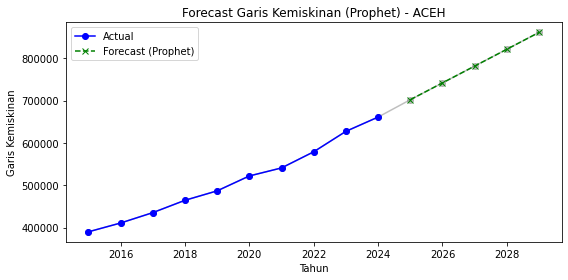

18:49:39 - cmdstanpy - INFO - Chain [1] start processing
18:49:39 - cmdstanpy - INFO - Chain [1] done processing


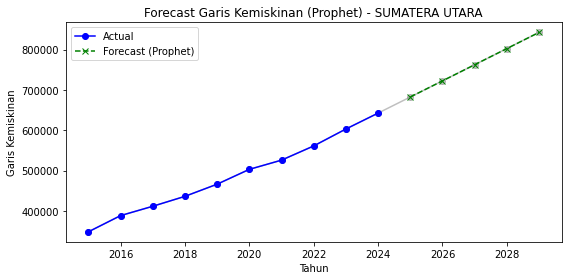

18:49:40 - cmdstanpy - INFO - Chain [1] start processing
18:49:40 - cmdstanpy - INFO - Chain [1] done processing


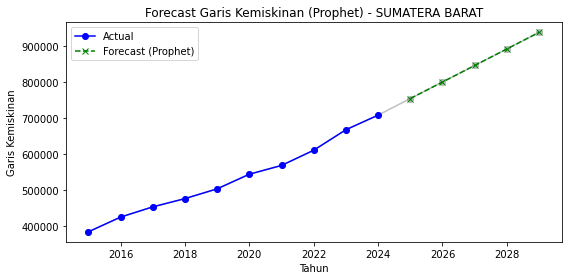

18:49:41 - cmdstanpy - INFO - Chain [1] start processing
18:49:41 - cmdstanpy - INFO - Chain [1] done processing


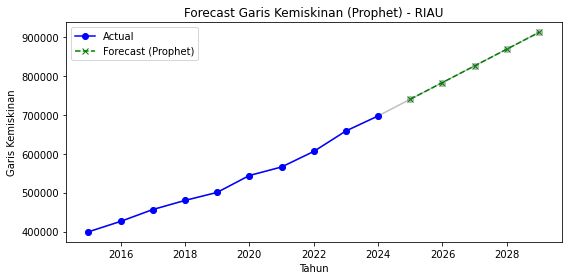

18:49:42 - cmdstanpy - INFO - Chain [1] start processing
18:49:42 - cmdstanpy - INFO - Chain [1] done processing


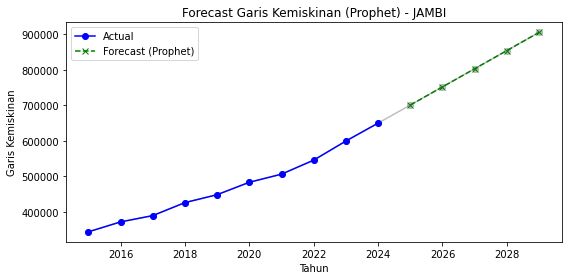

18:49:43 - cmdstanpy - INFO - Chain [1] start processing
18:49:43 - cmdstanpy - INFO - Chain [1] done processing


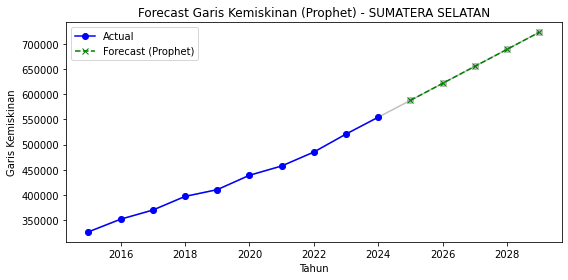

18:49:44 - cmdstanpy - INFO - Chain [1] start processing
18:49:44 - cmdstanpy - INFO - Chain [1] done processing


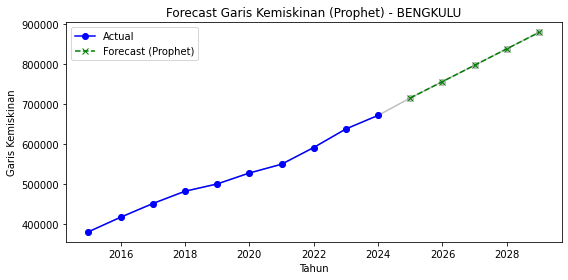

18:49:45 - cmdstanpy - INFO - Chain [1] start processing
18:49:45 - cmdstanpy - INFO - Chain [1] done processing


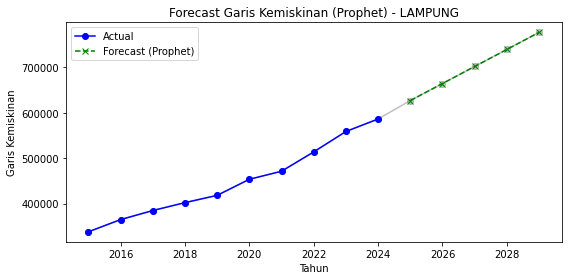

18:49:45 - cmdstanpy - INFO - Chain [1] start processing
18:49:45 - cmdstanpy - INFO - Chain [1] done processing


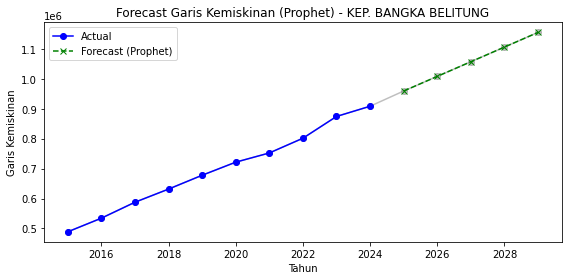

18:49:46 - cmdstanpy - INFO - Chain [1] start processing
18:49:46 - cmdstanpy - INFO - Chain [1] done processing


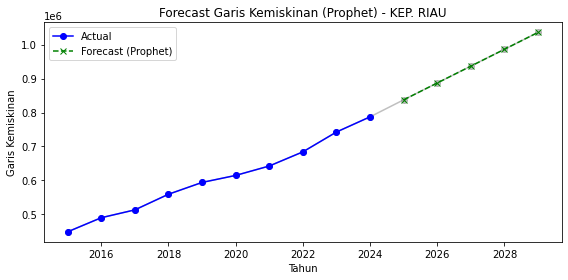

18:49:47 - cmdstanpy - INFO - Chain [1] start processing
18:49:47 - cmdstanpy - INFO - Chain [1] done processing


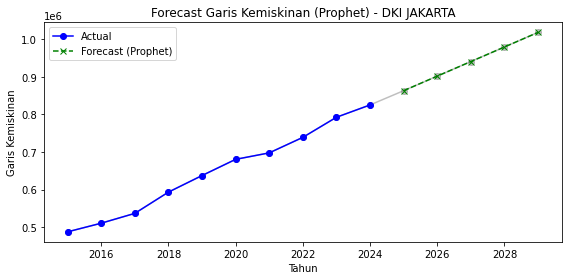

18:49:47 - cmdstanpy - INFO - Chain [1] start processing
18:49:47 - cmdstanpy - INFO - Chain [1] done processing


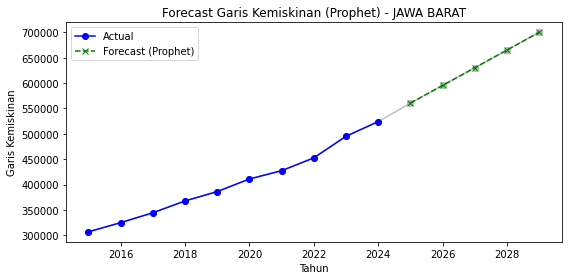

18:49:48 - cmdstanpy - INFO - Chain [1] start processing
18:49:48 - cmdstanpy - INFO - Chain [1] done processing


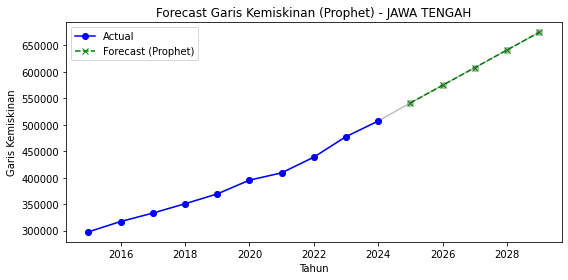

18:49:49 - cmdstanpy - INFO - Chain [1] start processing
18:49:49 - cmdstanpy - INFO - Chain [1] done processing


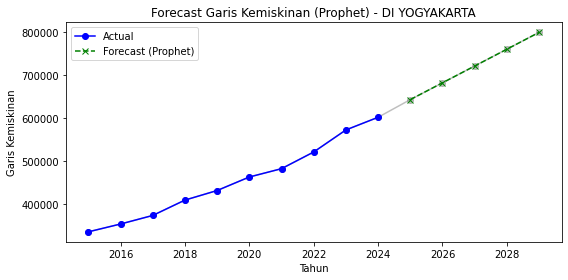

18:49:49 - cmdstanpy - INFO - Chain [1] start processing
18:49:49 - cmdstanpy - INFO - Chain [1] done processing


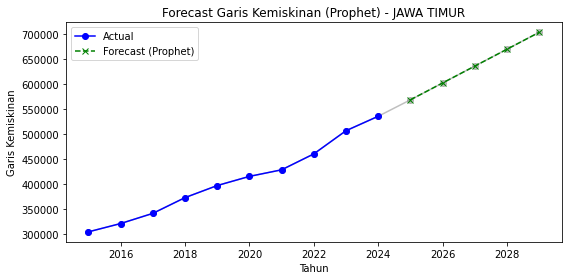

18:49:50 - cmdstanpy - INFO - Chain [1] start processing
18:49:50 - cmdstanpy - INFO - Chain [1] done processing


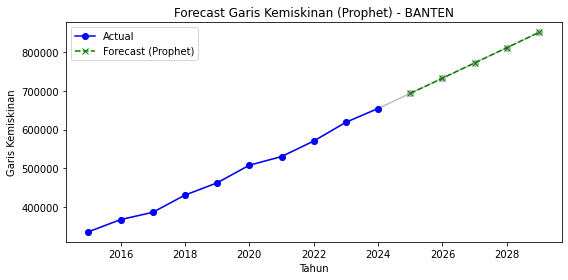

18:49:50 - cmdstanpy - INFO - Chain [1] start processing
18:49:51 - cmdstanpy - INFO - Chain [1] done processing


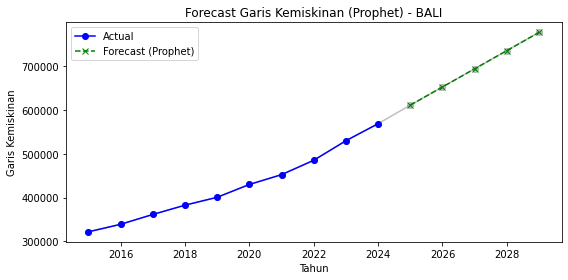

18:49:51 - cmdstanpy - INFO - Chain [1] start processing
18:49:51 - cmdstanpy - INFO - Chain [1] done processing


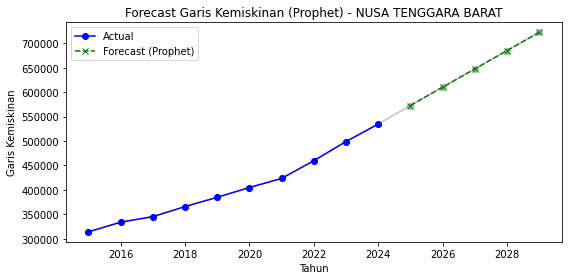

18:49:52 - cmdstanpy - INFO - Chain [1] start processing
18:49:52 - cmdstanpy - INFO - Chain [1] done processing


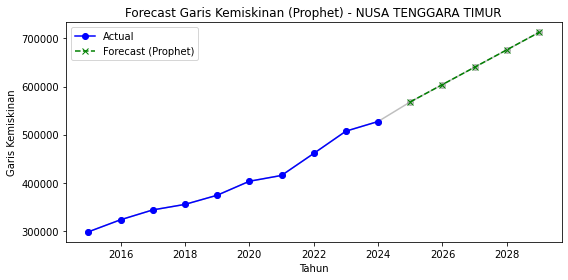

18:49:52 - cmdstanpy - INFO - Chain [1] start processing
18:49:52 - cmdstanpy - INFO - Chain [1] done processing


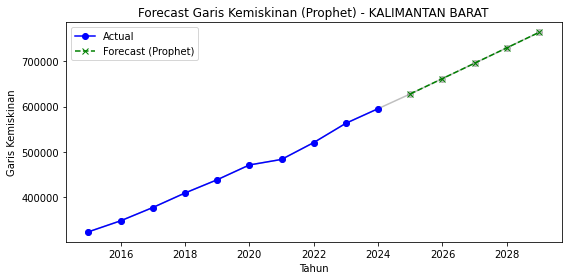

18:49:53 - cmdstanpy - INFO - Chain [1] start processing
18:49:53 - cmdstanpy - INFO - Chain [1] done processing


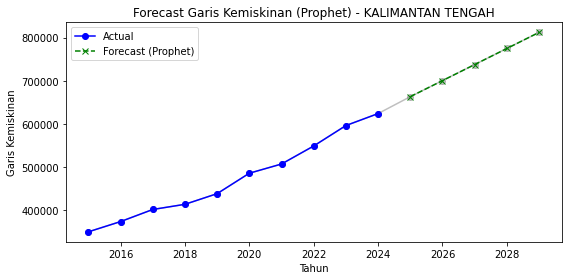

18:49:53 - cmdstanpy - INFO - Chain [1] start processing
18:49:54 - cmdstanpy - INFO - Chain [1] done processing


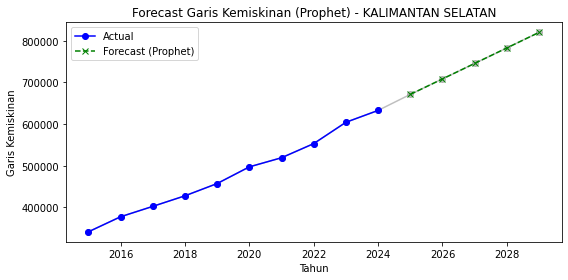

18:49:54 - cmdstanpy - INFO - Chain [1] start processing
18:49:54 - cmdstanpy - INFO - Chain [1] done processing


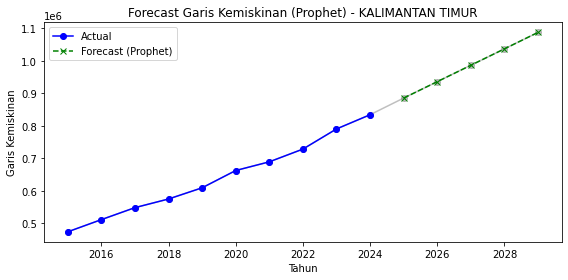

18:49:55 - cmdstanpy - INFO - Chain [1] start processing
18:49:55 - cmdstanpy - INFO - Chain [1] done processing


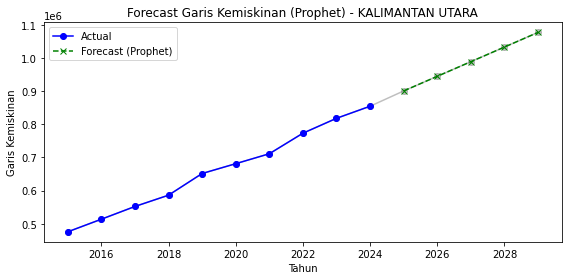

18:49:55 - cmdstanpy - INFO - Chain [1] start processing
18:49:55 - cmdstanpy - INFO - Chain [1] done processing


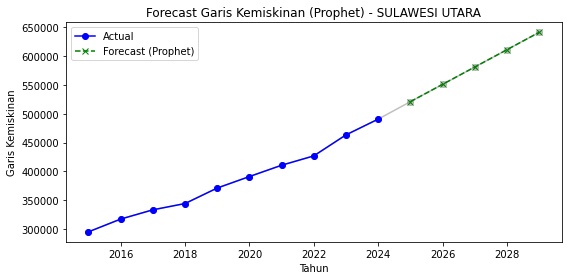

18:49:56 - cmdstanpy - INFO - Chain [1] start processing
18:49:56 - cmdstanpy - INFO - Chain [1] done processing


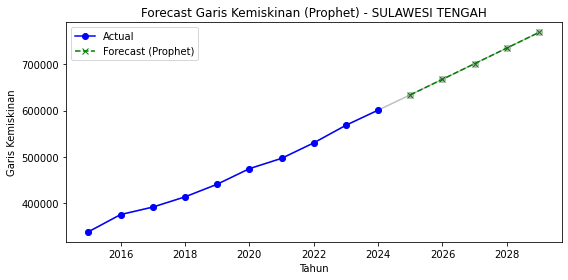

18:49:57 - cmdstanpy - INFO - Chain [1] start processing
18:49:57 - cmdstanpy - INFO - Chain [1] done processing


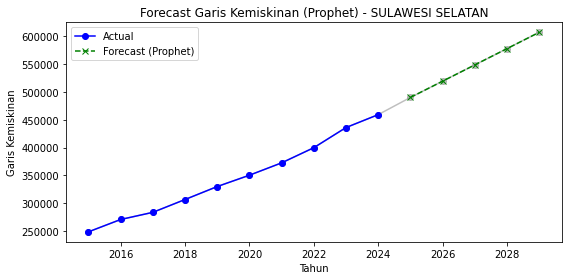

18:49:57 - cmdstanpy - INFO - Chain [1] start processing
18:49:57 - cmdstanpy - INFO - Chain [1] done processing


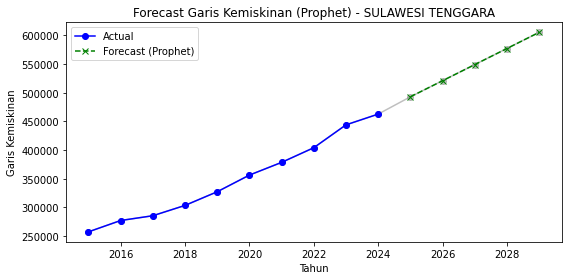

18:49:58 - cmdstanpy - INFO - Chain [1] start processing
18:49:58 - cmdstanpy - INFO - Chain [1] done processing


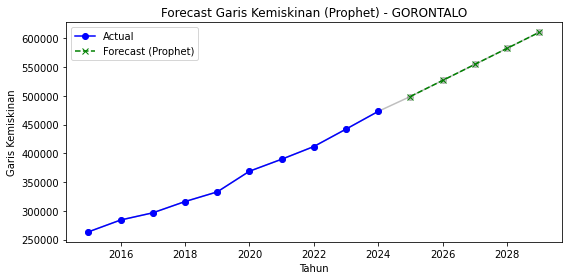

18:49:59 - cmdstanpy - INFO - Chain [1] start processing
18:49:59 - cmdstanpy - INFO - Chain [1] done processing


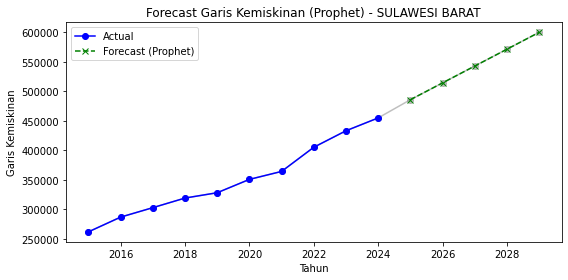

18:49:59 - cmdstanpy - INFO - Chain [1] start processing
18:49:59 - cmdstanpy - INFO - Chain [1] done processing


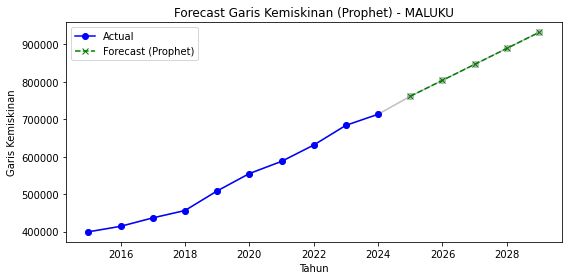

18:50:00 - cmdstanpy - INFO - Chain [1] start processing
18:50:00 - cmdstanpy - INFO - Chain [1] done processing


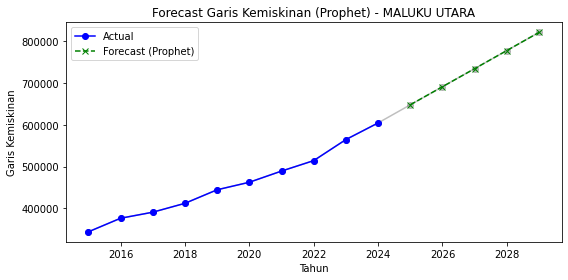

18:50:01 - cmdstanpy - INFO - Chain [1] start processing
18:50:01 - cmdstanpy - INFO - Chain [1] done processing


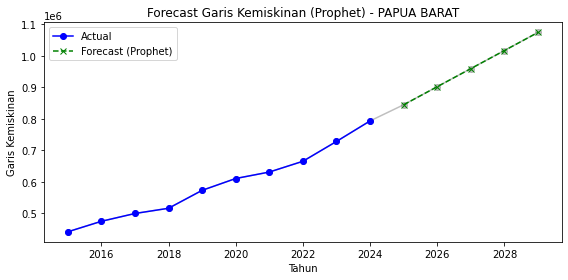

18:50:01 - cmdstanpy - INFO - Chain [1] start processing
18:50:02 - cmdstanpy - INFO - Chain [1] done processing


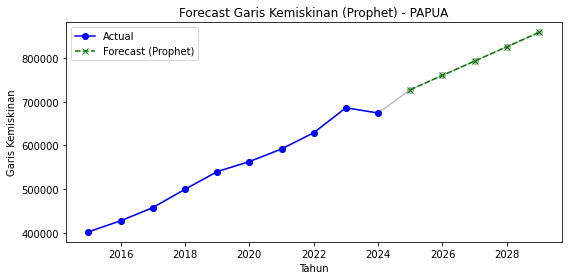

In [36]:
forecast_horizon = 5
provinsi_list = used_df['Provinsi'].unique()
forecast_results_prophet = {}

for prov in provinsi_list:
    # Prepare training data for Prophet (2015-2024)
    data_prov = used_df[used_df['Provinsi'] == prov].sort_values('Tahun')
    df_train = data_prov[['Tahun', 'Garis Kemiskinan']].rename(columns={'Tahun': 'ds', 'Garis Kemiskinan': 'y'})
    # Prophet expects 'ds' as datetime
    df_train['ds'] = pd.to_datetime(df_train['ds'], format='%Y')
    
    # Fit Prophet model
    model = Prophet(yearly_seasonality=False, daily_seasonality=False, weekly_seasonality=False)
    model.fit(df_train)
    
    # Create future dataframe for 5 years ahead
    last_year = data_prov['Tahun'].max()
    future_years = np.arange(last_year + 1, last_year + 1 + forecast_horizon)
    future = pd.DataFrame({'ds': pd.to_datetime(future_years, format='%Y')})
    
    # Forecast
    forecast = model.predict(future)
    forecast_values = forecast['yhat'].values
    forecast_results_prophet[prov] = forecast_values

    # Combine actual and forecast for plotting
    tahun_actual = data_prov['Tahun'].values
    series_actual = data_prov['Garis Kemiskinan'].values
    tahun_forecast = future_years
    tahun_all = np.concatenate([tahun_actual, tahun_forecast])
    series_all = np.concatenate([series_actual, forecast_values])

    plt.figure(figsize=(8, 4))
    plt.plot(tahun_all, series_all, marker='o', color='gray', alpha=0.5, label='_nolegend_')
    plt.plot(tahun_actual, series_actual, marker='o', color='blue', label='Actual')
    plt.plot(tahun_forecast, forecast_values, marker='x', linestyle='--', color='green', label='Forecast (Prophet)')
    plt.title(f'Forecast Garis Kemiskinan (Prophet) - {prov}')
    plt.xlabel('Tahun')
    plt.ylabel('Garis Kemiskinan')
    plt.legend()
    plt.tight_layout()
    plt.show()

# Save forecast results to a text file
with open("forecasting_with_prophet_result.txt", "w") as f:
    for prov, forecast in forecast_results_prophet.items():
        tahun_terakhir = used_df[used_df['Provinsi'] == prov]['Tahun'].max()
        for i, nilai in enumerate(forecast):
            tahun_prediksi = tahun_terakhir + 1 + i
            f.write(f"{prov} {tahun_prediksi} = {nilai:.2f}\n")

In [37]:
with open("forecasting_with_prophet_result.txt", "r") as f:
    print(f.read())

ACEH 2025 = 702255.65
ACEH 2026 = 742002.69
ACEH 2027 = 781749.73
ACEH 2028 = 821496.77
ACEH 2029 = 861352.70
SUMATERA UTARA 2025 = 682351.36
SUMATERA UTARA 2026 = 722406.40
SUMATERA UTARA 2027 = 762461.45
SUMATERA UTARA 2028 = 802516.49
SUMATERA UTARA 2029 = 842681.27
SUMATERA BARAT 2025 = 754502.77
SUMATERA BARAT 2026 = 800435.98
SUMATERA BARAT 2027 = 846369.19
SUMATERA BARAT 2028 = 892302.40
SUMATERA BARAT 2029 = 938361.46
RIAU 2025 = 740282.28
RIAU 2026 = 783240.93
RIAU 2027 = 826199.58
RIAU 2028 = 869158.24
RIAU 2029 = 912234.58
JAMBI 2025 = 700990.13
JAMBI 2026 = 752136.11
JAMBI 2027 = 803282.09
JAMBI 2028 = 854428.06
JAMBI 2029 = 905714.17
SUMATERA SELATAN 2025 = 587543.70
SUMATERA SELATAN 2026 = 621266.00
SUMATERA SELATAN 2027 = 654988.29
SUMATERA SELATAN 2028 = 688710.59
SUMATERA SELATAN 2029 = 722525.28
BENGKULU 2025 = 714560.53
BENGKULU 2026 = 755523.97
BENGKULU 2027 = 796487.42
BENGKULU 2028 = 837450.86
BENGKULU 2029 = 878526.53
LAMPUNG 2025 = 627152.02
LAMPUNG 2026 = 66468

## Forecasting with Prophet (Multivariate) + Xgboost (NOT FIXED MASIH NGACO)

In [38]:
# 1. Add rows for years 2025-2029 for each province
all_years = list(range(2015, 2030))
all_provinces = used_df['Provinsi'].unique()
full_rows = []

for prov in all_provinces:
    for year in all_years:
        full_rows.append({'Provinsi': prov, 'Tahun': year})

full_df = pd.DataFrame(full_rows)
full_df = full_df.merge(used_df, on=['Provinsi', 'Tahun'], how='left')

# 2. Create rolling mean and lag features for each numeric column
exclude_cols = ["Provinsi", "Tahun", "Garis Kemiskinan"]
num_cols = [col for col in used_df.columns if col not in exclude_cols]

# Rolling mean features
for window in [1, 2, 3]:
    rolled = full_df.groupby("Provinsi")[num_cols].rolling(window=window, min_periods=1).mean().reset_index(level=0, drop=True)
    rolled.columns = [f"{col}_rollmean_{window}" for col in rolled.columns]
    full_df = pd.concat([full_df, rolled], axis=1)

# Lag features
for lag in [1, 2, 3]:
    lagged = full_df.groupby("Provinsi")[num_cols].shift(lag)
    lagged.columns = [f"{col}_lag_{lag}" for col in lagged.columns]
    full_df = pd.concat([full_df, lagged], axis=1)

# 3. Fill missing values in original features (2025-2029) with rolling mean 3 years
for col in num_cols:
    mask_missing = full_df[col].isna() & (full_df['Tahun'] >= 2025)
    full_df.loc[mask_missing, col] = full_df.loc[mask_missing, f"{col}_rollmean_3"]

# 4. Prepare features for XGBoost (original + rolling mean + lag)
feature_cols = []
for col in num_cols:
    feature_cols.append(col)
    feature_cols += [f"{col}_rollmean_{w}" for w in [1,2,3]]
    feature_cols += [f"{col}_lag_{l}" for l in [1,2,3]]
feature_cols.append('Tahun')

# 5. Predict Garis Kemiskinan for 2025-2029 using XGBoost per province
from sklearn.model_selection import train_test_split

for prov in all_provinces:
    df_prov = full_df[full_df['Provinsi'] == prov].copy()
    train = df_prov[df_prov['Garis Kemiskinan'].notna()]
    test = df_prov[df_prov['Tahun'] >= 2025]
    X_train = train[feature_cols]
    y_train = train['Garis Kemiskinan']
    X_test = test[feature_cols]

    model = XGBRegressor(n_estimators=100, random_state=42)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    # Update predictions in the dataframe
    full_df.loc[(full_df['Provinsi'] == prov) & (full_df['Tahun'] >= 2025), 'Garis Kemiskinan'] = y_pred

# 6. Visualization of the results
import matplotlib.pyplot as plt

for prov in all_provinces:
    df_prov = full_df[full_df['Provinsi'] == prov].sort_values('Tahun')
    tahun = df_prov['Tahun'].values
    garis = df_prov['Garis Kemiskinan'].values
    plt.figure(figsize=(8, 4))
    plt.plot(tahun, garis, marker='o', color='gray', alpha=0.5, label='Actual+Forecast')
    plt.plot(tahun[tahun <= 2024], garis[tahun <= 2024], marker='o', color='blue', label='Actual')
    plt.plot(tahun[tahun >= 2025], garis[tahun >= 2025], marker='x', linestyle='--', color='red', label='Forecast (XGBoost)')
    plt.title(f'Forecast Garis Kemiskinan (XGBoost) - {prov}')
    plt.xlabel('Year')
    plt.ylabel('Garis Kemiskinan')
    plt.legend()
    plt.tight_layout()
    plt.show()

NameError: name 'XGBRegressor' is not defined

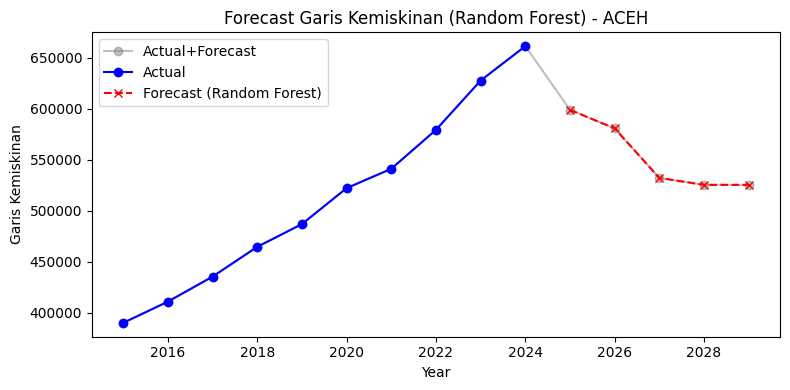

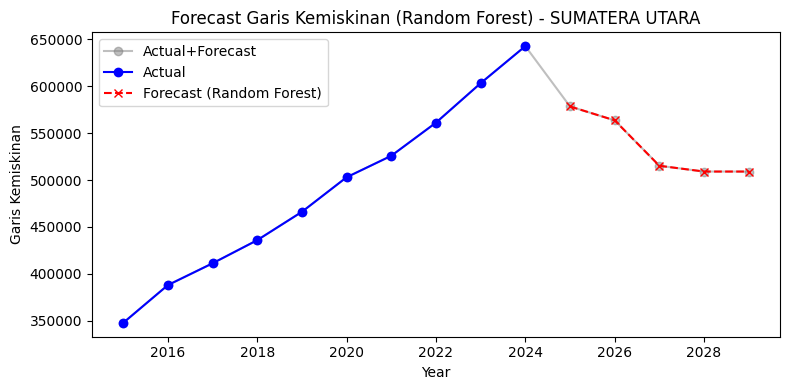

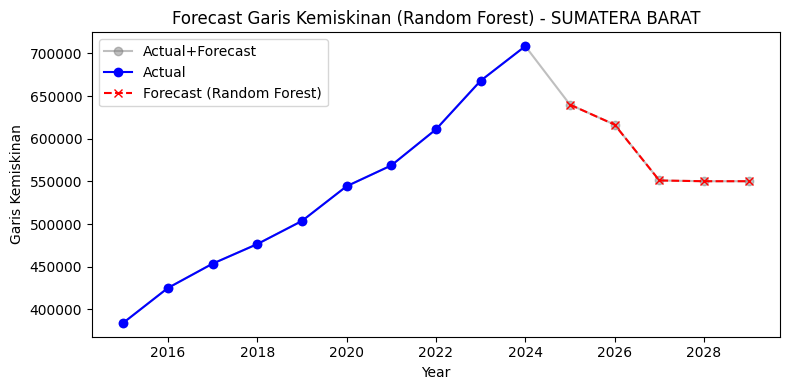

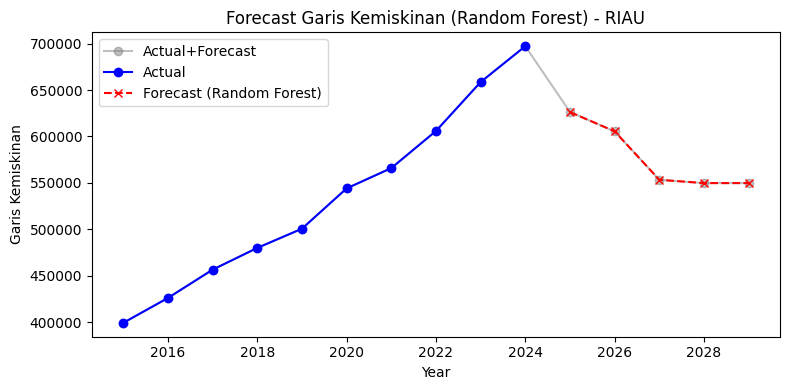

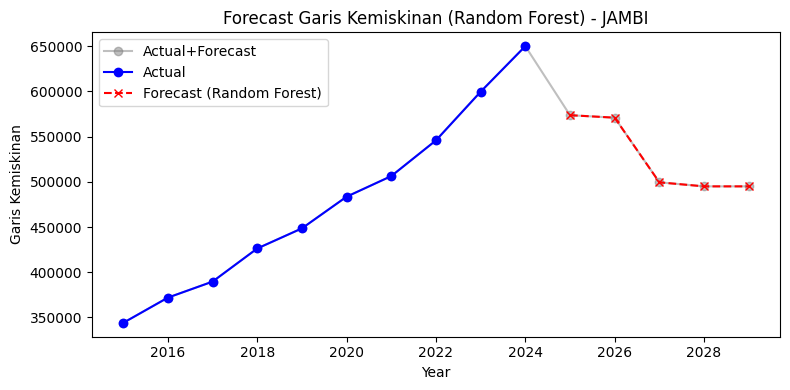

...

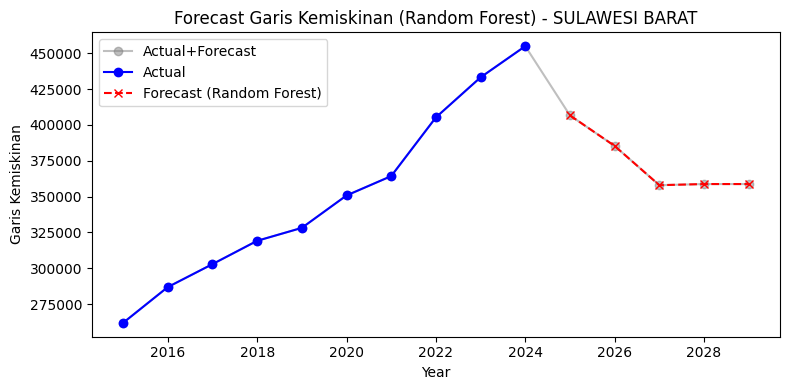

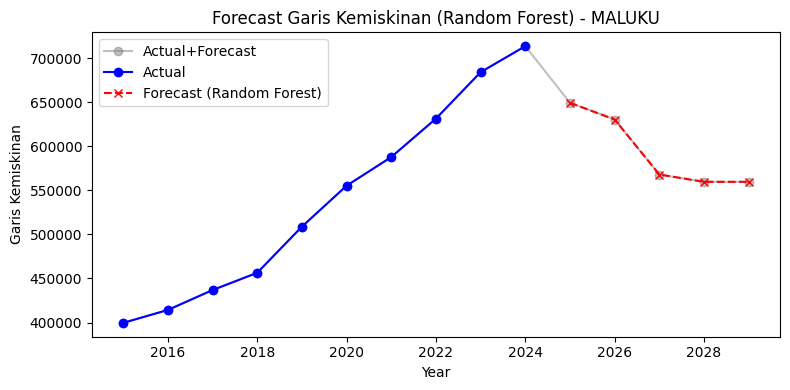

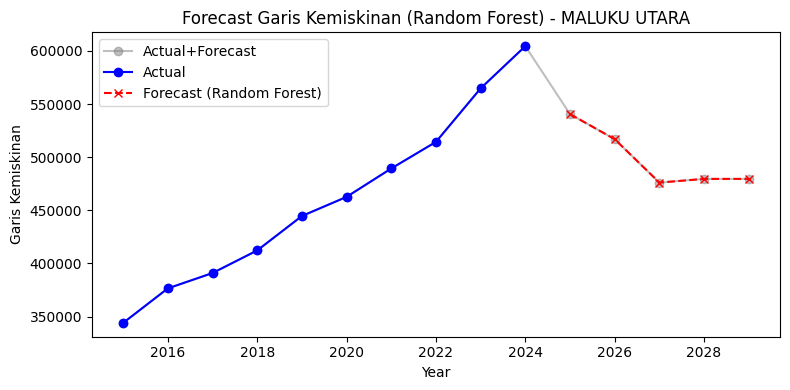

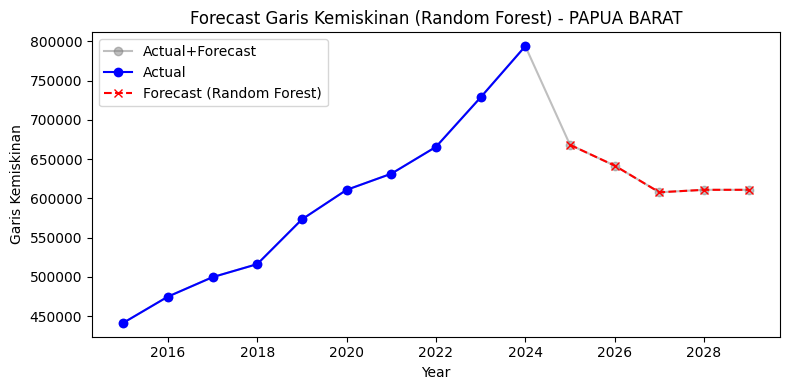

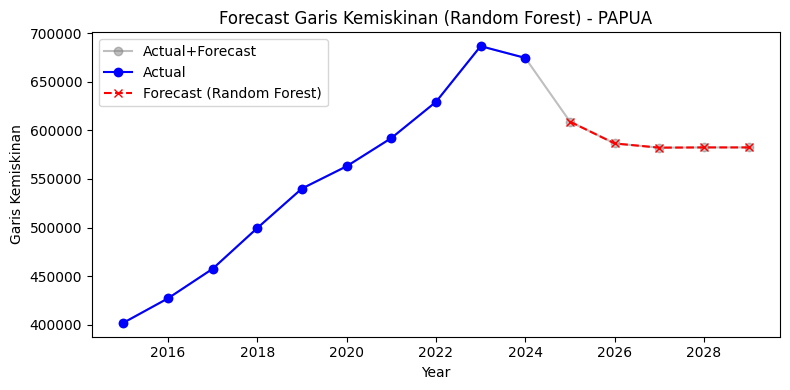

In [ ]:
from sklearn.ensemble import RandomForestRegressor

# 1. Add rows for years 2025-2029 for each province
all_years = list(range(2015, 2030))
all_provinces = used_df['Provinsi'].unique()
full_rows = []

for prov in all_provinces:
    for year in all_years:
        full_rows.append({'Provinsi': prov, 'Tahun': year})

full_df = pd.DataFrame(full_rows)
full_df = full_df.merge(used_df, on=['Provinsi', 'Tahun'], how='left')

# 2. Create rolling mean and lag features for each numeric column
exclude_cols = ["Provinsi", "Tahun", "Garis Kemiskinan"]
num_cols = [col for col in used_df.columns if col not in exclude_cols]

# Rolling mean features
for window in [1, 2, 3]:
    rolled = full_df.groupby("Provinsi")[num_cols].rolling(window=window, min_periods=1).mean().reset_index(level=0, drop=True)
    rolled.columns = [f"{col}_rollmean_{window}" for col in rolled.columns]
    full_df = pd.concat([full_df, rolled], axis=1)

# Lag features
for lag in [1, 2, 3]:
    lagged = full_df.groupby("Provinsi")[num_cols].shift(lag)
    lagged.columns = [f"{col}_lag_{lag}" for col in lagged.columns]
    full_df = pd.concat([full_df, lagged], axis=1)

# 3. Fill missing values in original features (2025-2029) with rolling mean 3 years
for col in num_cols:
    mask_missing = full_df[col].isna() & (full_df['Tahun'] >= 2025)
    full_df.loc[mask_missing, col] = full_df.loc[mask_missing, f"{col}_rollmean_3"]

# 4. Prepare features for Random Forest (original + rolling mean + lag)
feature_cols = []
for col in num_cols:
    feature_cols.append(col)
    feature_cols += [f"{col}_rollmean_{w}" for w in [1,2,3]]
    feature_cols += [f"{col}_lag_{l}" for l in [1,2,3]]
feature_cols.append('Tahun')

# 5. Predict Garis Kemiskinan for 2025-2029 using Random Forest per province
for prov in all_provinces:
    df_prov = full_df[full_df['Provinsi'] == prov].copy()
    train = df_prov[df_prov['Garis Kemiskinan'].notna()]
    test = df_prov[df_prov['Tahun'] >= 2025]
    X_train = train[feature_cols]
    y_train = train['Garis Kemiskinan']
    X_test = test[feature_cols]

    model = RandomForestRegressor(n_estimators=100, random_state=42)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    # Update predictions in the dataframe
    full_df.loc[(full_df['Provinsi'] == prov) & (full_df['Tahun'] >= 2025), 'Garis Kemiskinan'] = y_pred

# 6. Visualization of the results
import matplotlib.pyplot as plt

for prov in all_provinces:
    df_prov = full_df[full_df['Provinsi'] == prov].sort_values('Tahun')
    tahun = df_prov['Tahun'].values
    garis = df_prov['Garis Kemiskinan'].values
    plt.figure(figsize=(8, 4))
    plt.plot(tahun, garis, marker='o', color='gray', alpha=0.5, label='Actual+Forecast')
    plt.plot(tahun[tahun <= 2024], garis[tahun <= 2024], marker='o', color='blue', label='Actual')
    plt.plot(tahun[tahun >= 2025], garis[tahun >= 2025], marker='x', linestyle='--', color='red', label='Forecast (Random Forest)')
    plt.title(f'Forecast Garis Kemiskinan (Random Forest) - {prov}')
    plt.xlabel('Year')
    plt.ylabel('Garis Kemiskinan')
    plt.legend()
    plt.tight_layout()
    plt.show()

20:02:00 - cmdstanpy - INFO - Chain [1] start processing
20:02:00 - cmdstanpy - INFO - Chain [1] done processing
20:02:01 - cmdstanpy - INFO - Chain [1] start processing
20:02:01 - cmdstanpy - INFO - Chain [1] done processing
20:02:01 - cmdstanpy - INFO - Chain [1] start processing
20:02:01 - cmdstanpy - INFO - Chain [1] done processing
20:02:01 - cmdstanpy - INFO - Chain [1] start processing
20:02:01 - cmdstanpy - INFO - Chain [1] done processing
20:02:01 - cmdstanpy - INFO - Chain [1] start processing
20:02:01 - cmdstanpy - INFO - Chain [1] done processing
20:02:01 - cmdstanpy - INFO - Chain [1] start processing
20:02:01 - cmdstanpy - INFO - Chain [1] done processing
20:02:01 - cmdstanpy - INFO - Chain [1] start processing
20:02:01 - cmdstanpy - INFO - Chain [1] done processing
20:02:01 - cmdstanpy - INFO - Chain [1] start processing
20:02:01 - cmdstanpy - INFO - Chain [1] done processing
20:02:01 - cmdstanpy - INFO - Chain [1] start processing
20:02:01 - cmdstanpy - INFO - Chain [1]

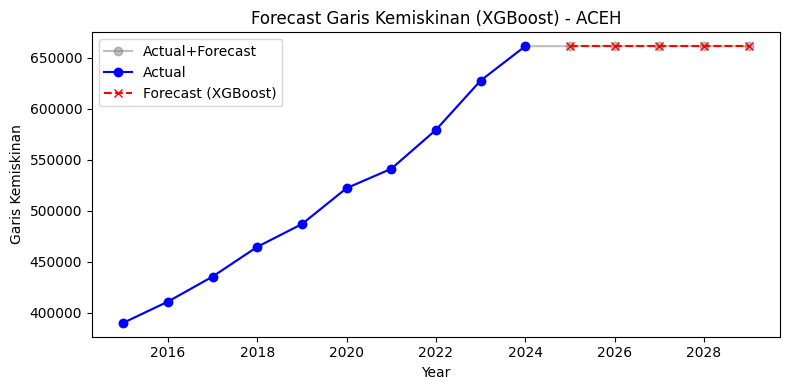

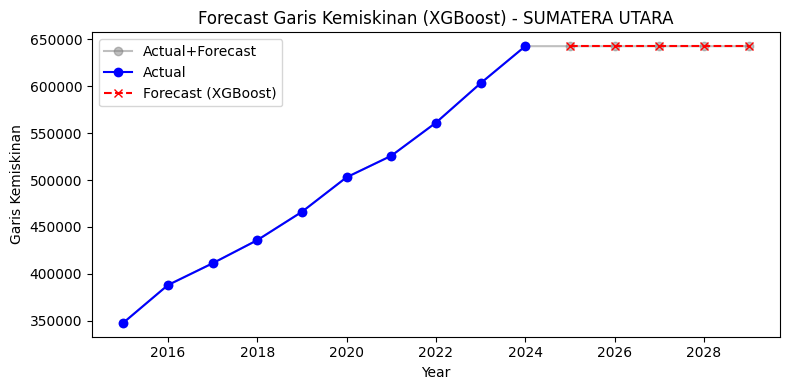

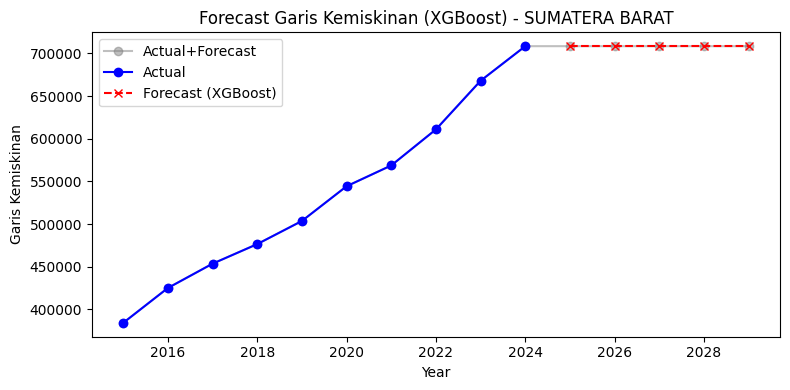

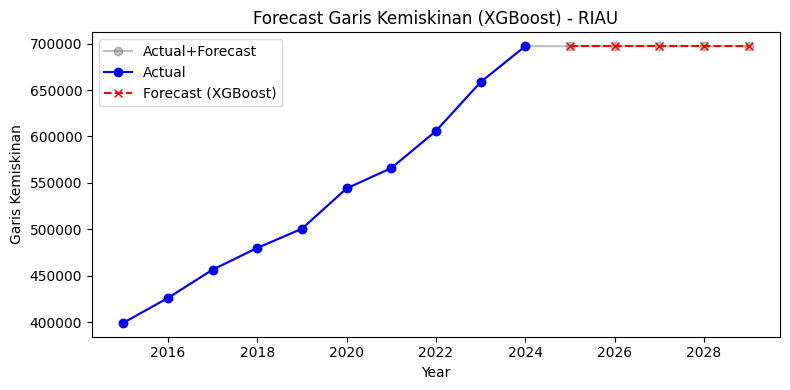

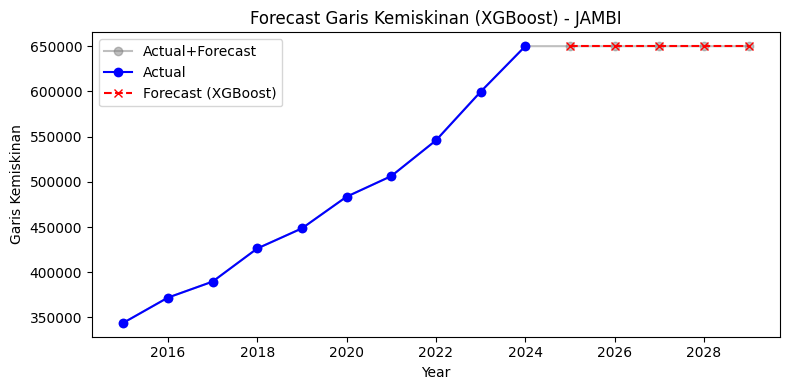

...

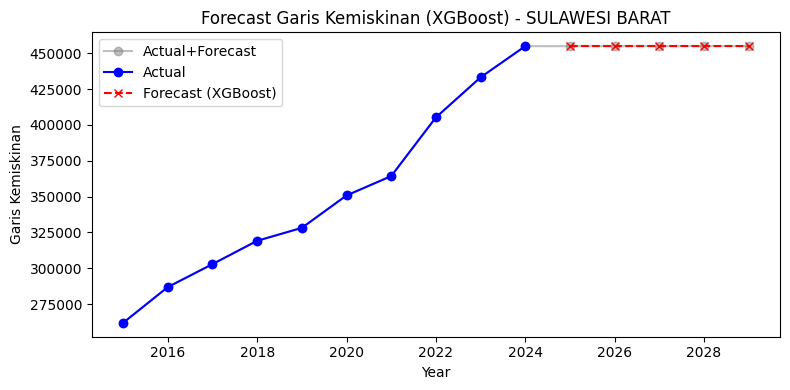

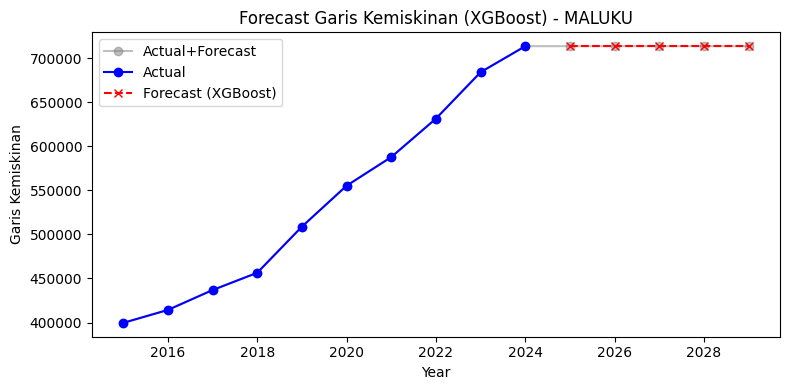

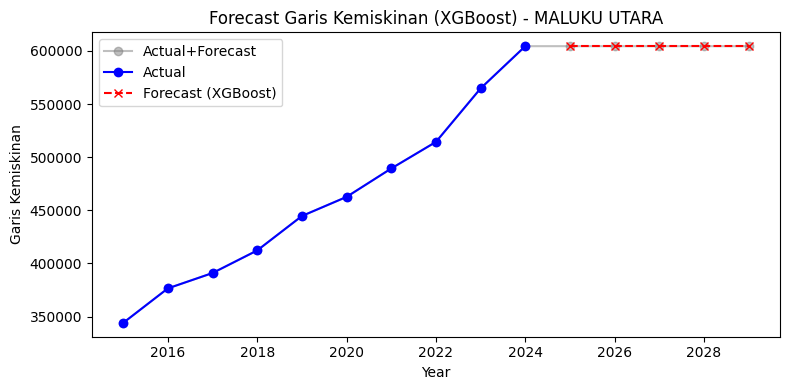

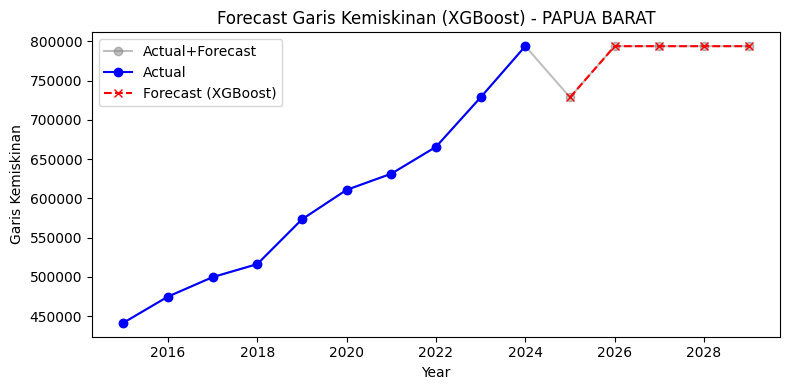

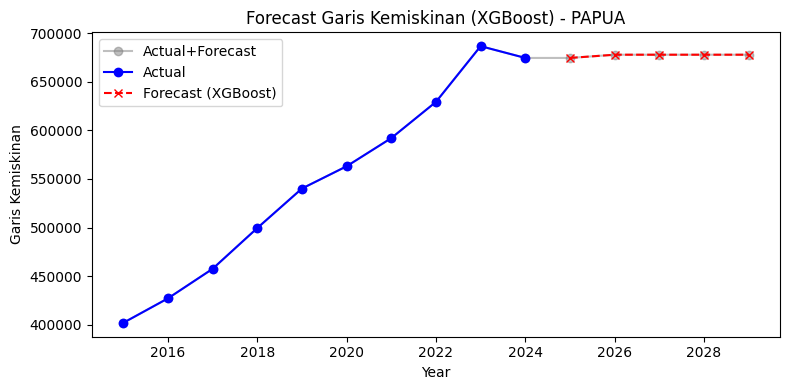

In [ ]:
from sklearn.ensemble import RandomForestRegressor


# 1. Add rows for years 2025-2029 for each province
all_years = list(range(2015, 2030))
all_provinces = used_df['Provinsi'].unique()
full_rows = []

for prov in all_provinces:
    for year in all_years:
        full_rows.append({'Provinsi': prov, 'Tahun': year})

full_df = pd.DataFrame(full_rows)
full_df = full_df.merge(used_df, on=['Provinsi', 'Tahun'], how='left')

# 2. Fill missing values for each column (except Garis Kemiskinan, Provinsi, Tahun) using Prophet per province
exclude_cols = ["Provinsi", "Tahun", "Garis Kemiskinan"]
num_cols = [col for col in used_df.columns if col not in exclude_cols]

for col in num_cols:
    for prov in all_provinces:
        # Select only available data (2015-2024) for training
        df_train = full_df[(full_df['Provinsi'] == prov) & (full_df['Tahun'] <= 2024)][['Tahun', col]].copy()
        df_train = df_train.rename(columns={'Tahun': 'ds', col: 'y'})
        # Prophet requires at least two non-NaN values
        if df_train['y'].notna().sum() > 2:
            model = Prophet(yearly_seasonality=False, daily_seasonality=False, weekly_seasonality=False)
            model.fit(df_train.dropna())
            # Forecast only for years 2025-2029
            future_years = np.arange(2025, 2030)
            future = pd.DataFrame({'ds': future_years})
            # Prophet expects datetime, so convert years to datetime
            future['ds'] = pd.to_datetime(future['ds'], format='%Y')
            forecast = model.predict(future)
            forecast_years = forecast['ds'].dt.year.values
            forecast_values = forecast['yhat'].values
            for i, year in enumerate(forecast_years):
                mask = (full_df['Provinsi'] == prov) & (full_df['Tahun'] == year)
                if np.isnan(full_df.loc[mask, col]).any():
                    full_df.loc[mask, col] = forecast_values[i]

# 3. Predict Garis Kemiskinan for 2025-2029 using XGBoost per province
from sklearn.model_selection import train_test_split

for prov in all_provinces:
    df_prov = full_df[full_df['Provinsi'] == prov].copy()
    # Use only rows with known Garis Kemiskinan for training
    train = df_prov[df_prov['Garis Kemiskinan'].notna()]
    test = df_prov[df_prov['Tahun'] >= 2025]
    features = [col for col in num_cols]
    features += ['Tahun']  # Optionally include year as a feature

    X_train = train[features]
    y_train = train['Garis Kemiskinan']
    X_test = test[features]

    model = XGBRegressor(n_estimators=100, random_state=42)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    # Update predictions in the dataframe
    full_df.loc[(full_df['Provinsi'] == prov) & (full_df['Tahun'] >= 2025), 'Garis Kemiskinan'] = y_pred

# 4. Visualization of the results
import matplotlib.pyplot as plt

for prov in all_provinces:
    df_prov = full_df[full_df['Provinsi'] == prov].sort_values('Tahun')
    tahun = df_prov['Tahun'].values
    garis = df_prov['Garis Kemiskinan'].values
    plt.figure(figsize=(8, 4))
    plt.plot(tahun, garis, marker='o', color='gray', alpha=0.5, label='Actual+Forecast')
    plt.plot(tahun[tahun <= 2024], garis[tahun <= 2024], marker='o', color='blue', label='Actual')
    plt.plot(tahun[tahun >= 2025], garis[tahun >= 2025], marker='x', linestyle='--', color='red', label='Forecast (XGBoost)')
    plt.title(f'Forecast Garis Kemiskinan (XGBoost) - {prov}')
    plt.xlabel('Year')
    plt.ylabel('Garis Kemiskinan')
    plt.legend()
    plt.tight_layout()
    plt.show()


In [ ]:
import pandas as pd
import numpy as np
from pmdarima import auto_arima
from sklearn.ensemble import RandomForestRegressor
import matplotlib.pyplot as plt

# --- 2. Add rows for years 2025-2029 for each province ---
all_years = list(range(2015, 2030))
all_provinces = used_df['Provinsi'].unique()
full_rows = []
for prov in all_provinces:
    for year in all_years:
        full_rows.append({'Provinsi': prov, 'Tahun': year})
full_df = pd.DataFrame(full_rows)
full_df = full_df.merge(used_df, on=['Provinsi', 'Tahun'], how='left')

# --- 3. Fill missing values in numeric features (2025-2029) with auto_arima forecast per provinsi ---
exclude_cols = ["Provinsi", "Tahun", "Garis Kemiskinan"]
num_cols = [col for col in used_df.columns if col not in exclude_cols]

for col in num_cols:
    for prov in all_provinces:
        df_train = full_df[(full_df['Provinsi'] == prov) & (full_df['Tahun'] <= 2024)]
        y = df_train[col].values
        tahun_train = df_train['Tahun'].values
        if np.sum(~np.isnan(y)) > 3:
            mask_notna = ~np.isnan(y)
            y_clean = y[mask_notna]
            if len(y_clean) > 3:
                model = auto_arima(y_clean, d=1, seasonal=False, suppress_warnings=True, stepwise=True)
                n_forecast = 2029 - 2024
                forecast = model.predict(n_periods=n_forecast)
                for i, year in enumerate(range(2025, 2030)):
                    mask = (full_df['Provinsi'] == prov) & (full_df['Tahun'] == year)
                    if full_df.loc[mask, col].isna().any():
                        full_df.loc[mask, col] = forecast[i]

# --- 4. Prepare features for Random Forest (original numeric features + Tahun) ---
feature_cols = num_cols + ['Tahun']

# --- 5. Predict Garis Kemiskinan for 2025-2029 using Random Forest per province ---
for prov in all_provinces:
    df_prov = full_df[full_df['Provinsi'] == prov].copy()
    train = df_prov[df_prov['Garis Kemiskinan'].notna()]
    test = df_prov[df_prov['Tahun'] >= 2025]
    X_train = train[feature_cols]
    y_train = train['Garis Kemiskinan']
    X_test = test[feature_cols]

    model = RandomForestRegressor(n_estimators=100, random_state=42)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    # Update predictions in the dataframe
    full_df.loc[(full_df['Provinsi'] == prov) & (full_df['Tahun'] >= 2025), 'Garis Kemiskinan'] = y_pred

# --- 6. Visualization of the results ---
for prov in all_provinces:
    df_prov = full_df[full_df['Provinsi'] == prov].sort_values('Tahun')
    tahun = df_prov['Tahun'].values
    garis = df_prov['Garis Kemiskinan'].values
    plt.figure(figsize=(8, 4))
    plt.plot(tahun, garis, marker='o', color='gray', alpha=0.5, label='Actual+Forecast')
    plt.plot(tahun[tahun <= 2024], garis[tahun <= 2024], marker='o', color='blue', label='Actual')
    plt.plot(tahun[tahun >= 2025], garis[tahun >= 2025], marker='x', linestyle='--', color='red', label='Forecast (Random Forest)')
    plt.title(f'Forecast Garis Kemiskinan (Random Forest) - {prov}')
    plt.xlabel('Year')
    plt.ylabel('Garis Kemiskinan')
    plt.legend()
    plt.tight_layout()
    plt.show()

/home/lenovo/anaconda3/envs/myenv/lib/python3.11/site-packages/pmdarima/arima/_auto_solvers.py:524: ModelFitWarning: Error fitting  ARIMA(1,1,2)(0,0,0)[0] intercept (if you do not want to see these warnings, run with error_action="ignore").
Traceback:
Traceback (most recent call last):
  File "/home/lenovo/anaconda3/envs/myenv/lib/python3.11/site-packages/pmdarima/arima/_auto_solvers.py", line 508, in _fit_candidate_model
    fit.fit(y, X=X, **fit_params)
  File "/home/lenovo/anaconda3/envs/myenv/lib/python3.11/site-packages/pmdarima/arima/arima.py", line 603, in fit
    self._fit(y, X, **fit_args)
  File "/home/lenovo/anaconda3/envs/myenv/lib/python3.11/site-packages/pmdarima/arima/arima.py", line 524, in _fit
    fit, self.arima_res_ = _fit_wrapper()
                           ^^^^^^^^^^^^^^
  File "/home/lenovo/anaconda3/envs/myenv/lib/python3.11/site-packages/pmdarima/arima/arima.py", line 510, in _fit_wrapper
    fitted = arima.fit(
             ^^^^^^^^^^
  File "/home/lenovo/ana

ValueError: Input contains NaN.

In [ ]:
# --- 1. Siapkan data hingga 2029 untuk setiap provinsi ---
all_years = list(range(2015, 2030))
all_provinces = used_df['Provinsi'].unique()
full_rows = []
for prov in all_provinces:
    for year in all_years:
        full_rows.append({'Provinsi': prov, 'Tahun': year})
full_df = pd.DataFrame(full_rows)
full_df = full_df.merge(used_df, on=['Provinsi', 'Tahun'], how='left')

In [ ]:
exclude_cols = ["Provinsi", "Tahun", "Garis Kemiskinan"]
num_cols = [col for col in used_df.columns if col not in exclude_cols]

for col in num_cols:
    for prov in all_provinces:
        df_train = full_df[(full_df['Provinsi'] == prov) & (full_df['Tahun'] <= 2024)]
        y = df_train[col].values
        if np.sum(~np.isnan(y)) > 3:
            y_clean = y[~np.isnan(y)]
            if len(y_clean) > 3:
                model = auto_arima(y_clean, d=1, seasonal=False, suppress_warnings=True, stepwise=True)
                n_forecast = 2029 - 2024
                forecast = model.predict(n_periods=n_forecast)
                for i, year in enumerate(range(2025, 2030)):
                    mask = (full_df['Provinsi'] == prov) & (full_df['Tahun'] == year)
                    if full_df.loc[mask, col].isna().any():
                        full_df.loc[mask, col] = forecast[i]

/home/lenovo/anaconda3/envs/myenv/lib/python3.11/site-packages/pmdarima/arima/_auto_solvers.py:524: ModelFitWarning: Error fitting  ARIMA(1,1,2)(0,0,0)[0] intercept (if you do not want to see these warnings, run with error_action="ignore").
Traceback:
Traceback (most recent call last):
  File "/home/lenovo/anaconda3/envs/myenv/lib/python3.11/site-packages/pmdarima/arima/_auto_solvers.py", line 508, in _fit_candidate_model
    fit.fit(y, X=X, **fit_params)
  File "/home/lenovo/anaconda3/envs/myenv/lib/python3.11/site-packages/pmdarima/arima/arima.py", line 603, in fit
    self._fit(y, X, **fit_args)
  File "/home/lenovo/anaconda3/envs/myenv/lib/python3.11/site-packages/pmdarima/arima/arima.py", line 524, in _fit
    fit, self.arima_res_ = _fit_wrapper()
                           ^^^^^^^^^^^^^^
  File "/home/lenovo/anaconda3/envs/myenv/lib/python3.11/site-packages/pmdarima/arima/arima.py", line 510, in _fit_wrapper
    fitted = arima.fit(
             ^^^^^^^^^^
  File "/home/lenovo/ana

ValueError: Input contains NaN.

In [ ]:
full_df.isnull().sum()

Provinsi                                           0
Tahun                                              0
Garis Kemiskinan                                 170
Garis Kemiskinan Makanan Perkotaan Semester 1      0
Garis Kemiskinan Makanan Perkotaan Semester 2      0
                                                ... 
PDRB Triwulan II                                 170
PDRB Triwulan III                                170
PDRB Triwulan IV                                 170
PDRB Tahunan                                     170
UMP                                              170
Length: 62, dtype: int64

In [ ]:
nan_rows = full_df[full_df.isnull().any(axis=1)]
print(nan_rows)

    Provinsi  Tahun  Garis Kemiskinan  \
10      ACEH   2025               NaN   
11      ACEH   2026               NaN   
12      ACEH   2027               NaN   
13      ACEH   2028               NaN   
14      ACEH   2029               NaN   
..       ...    ...               ...   
505    PAPUA   2025               NaN   
506    PAPUA   2026               NaN   
507    PAPUA   2027               NaN   
508    PAPUA   2028               NaN   
509    PAPUA   2029               NaN   

     Garis Kemiskinan Makanan Perkotaan Semester 1  \
10                                   544353.666667   
11                                   569419.333333   
12                                   594485.000000   
13                                   619550.666667   
14                                   644616.333333   
..                                             ...   
505                                  531297.222222   
506                                  555465.444444   
507                  

/home/lenovo/anaconda3/envs/myenv/lib/python3.11/site-packages/pmdarima/arima/_auto_solvers.py:524: ModelFitWarning: Error fitting  ARIMA(1,1,2)(0,0,0)[0] intercept (if you do not want to see these warnings, run with error_action="ignore").
Traceback:
Traceback (most recent call last):
  File "/home/lenovo/anaconda3/envs/myenv/lib/python3.11/site-packages/pmdarima/arima/_auto_solvers.py", line 508, in _fit_candidate_model
    fit.fit(y, X=X, **fit_params)
  File "/home/lenovo/anaconda3/envs/myenv/lib/python3.11/site-packages/pmdarima/arima/arima.py", line 603, in fit
    self._fit(y, X, **fit_args)
  File "/home/lenovo/anaconda3/envs/myenv/lib/python3.11/site-packages/pmdarima/arima/arima.py", line 524, in _fit
    fit, self.arima_res_ = _fit_wrapper()
                           ^^^^^^^^^^^^^^
  File "/home/lenovo/anaconda3/envs/myenv/lib/python3.11/site-packages/pmdarima/arima/arima.py", line 510, in _fit_wrapper
    fitted = arima.fit(
             ^^^^^^^^^^
  File "/home/lenovo/ana

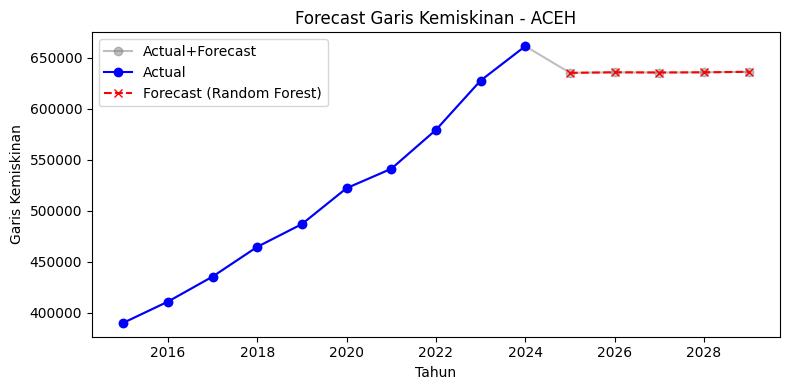

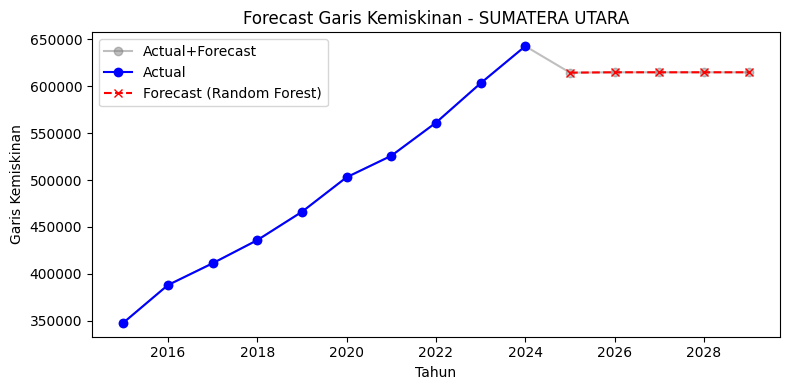

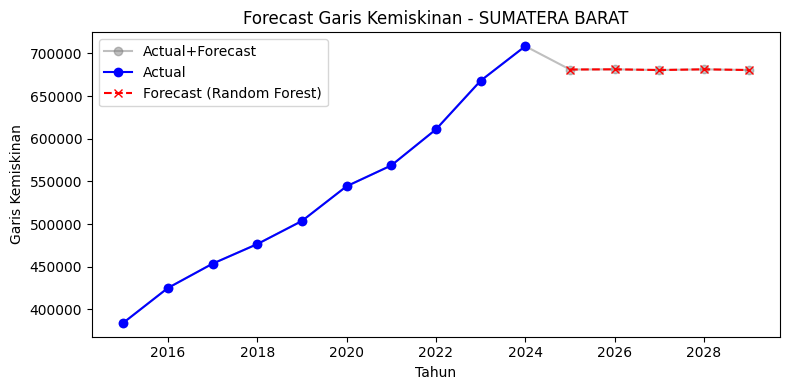

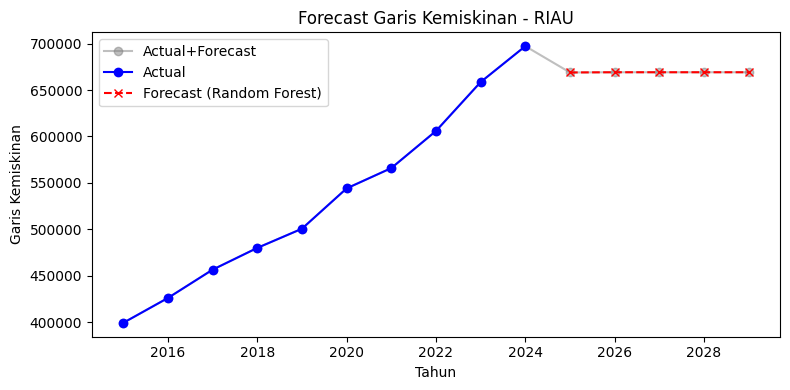

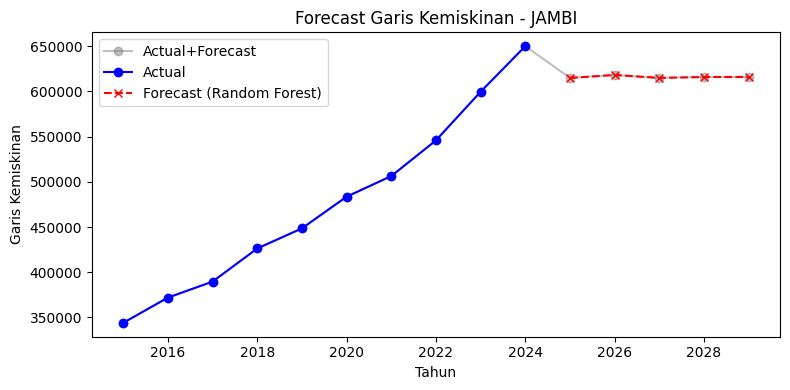

...

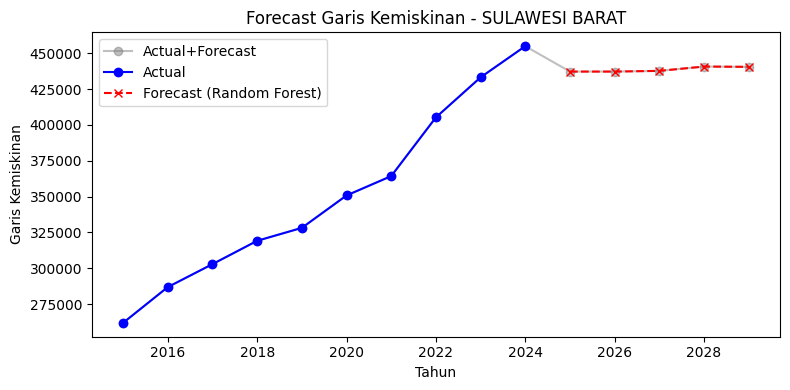

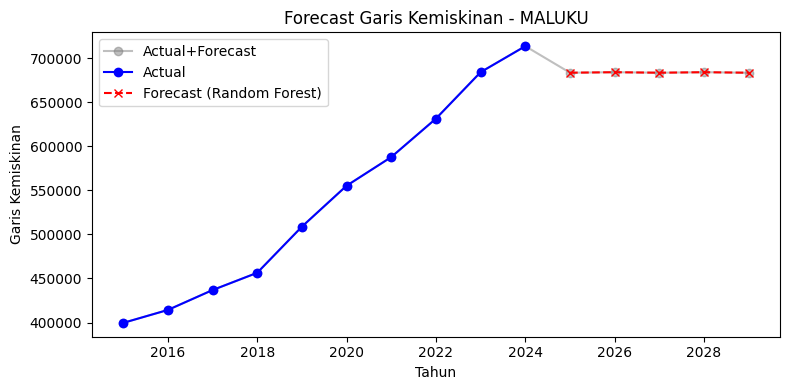

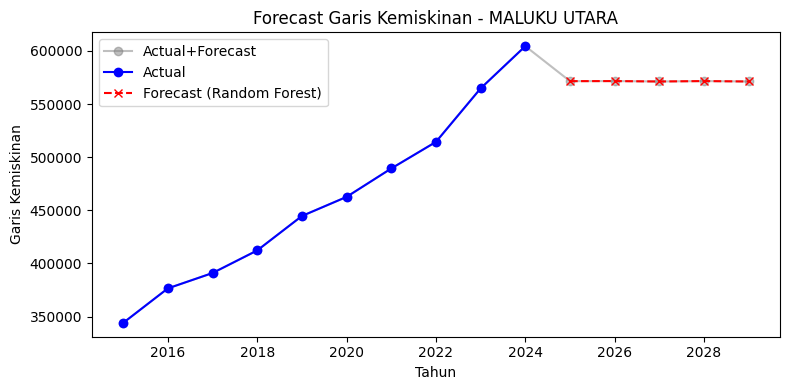

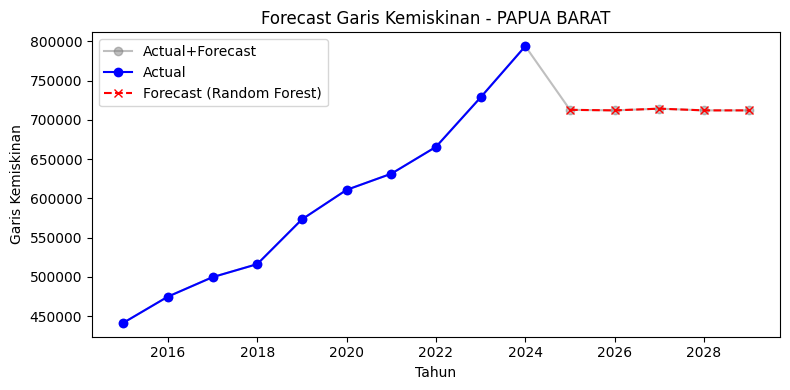

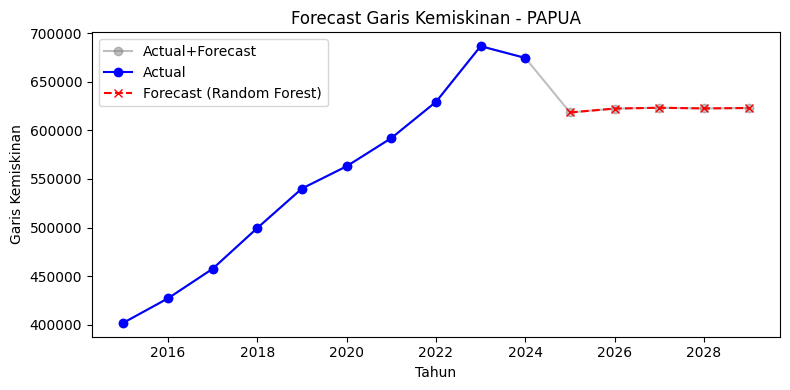

In [ ]:
import pandas as pd
import numpy as np
from pmdarima import auto_arima
from sklearn.ensemble import RandomForestRegressor
import matplotlib.pyplot as plt

# --- 1. Buat baris tahun 2015-2029 per provinsi ---
all_years = list(range(2015, 2030))
all_provinces = used_df['Provinsi'].unique()

full_rows = [{'Provinsi': prov, 'Tahun': year} for prov in all_provinces for year in all_years]
full_df = pd.DataFrame(full_rows)
full_df = full_df.merge(used_df, on=['Provinsi', 'Tahun'], how='left')

# --- 2. Forecast fitur numerik (selain Garis Kemiskinan) dengan auto_arima ---
exclude_cols = ["Provinsi", "Tahun", "Garis Kemiskinan"]
num_cols = [col for col in used_df.columns if col not in exclude_cols]

for col in num_cols:
    for prov in all_provinces:
        df_train = full_df[(full_df['Provinsi'] == prov) & (full_df['Tahun'] <= 2024)]
        y = df_train[col].values

        if np.sum(~np.isnan(y)) > 3:
            y_clean = y[~np.isnan(y)]
            try:
                model = auto_arima(y_clean, d=1, seasonal=False, suppress_warnings=True, stepwise=True)
                forecast = model.predict(n_periods=5)
                for i, year in enumerate(range(2025, 2030)):
                    mask = (full_df['Provinsi'] == prov) & (full_df['Tahun'] == year)
                    if pd.isna(full_df.loc[mask, col]).any():
                        full_df.loc[mask, col] = forecast[i]
            except:
                pass
        
        # --- Fallback jika masih ada NaN: isi pakai forward fill per provinsi ---
        mask_prov = (full_df['Provinsi'] == prov)
        full_df.loc[mask_prov, col] = full_df.loc[mask_prov, col].ffill().bfill()

# --- 3. Siapkan fitur untuk prediksi Garis Kemiskinan ---
feature_cols = num_cols + ['Tahun']

# --- 4. Prediksi Garis Kemiskinan (2025-2029) per provinsi ---
for prov in all_provinces:
    df_prov = full_df[full_df['Provinsi'] == prov].copy()

    train = df_prov[df_prov['Garis Kemiskinan'].notna()].dropna(subset=feature_cols)
    test = df_prov[(df_prov['Tahun'] >= 2025)].dropna(subset=feature_cols)

    if len(train) > 0 and len(test) > 0:
        X_train = train[feature_cols]
        y_train = train['Garis Kemiskinan']
        X_test = test[feature_cols]

        model = RandomForestRegressor(n_estimators=100, random_state=42)
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)

        full_df.loc[(full_df['Provinsi'] == prov) & (full_df['Tahun'] >= 2025), 'Garis Kemiskinan'] = y_pred

# --- 5. Visualisasi hasil ---
for prov in all_provinces:
    df_prov = full_df[full_df['Provinsi'] == prov].sort_values('Tahun')
    tahun = df_prov['Tahun'].values
    garis = df_prov['Garis Kemiskinan'].values

    plt.figure(figsize=(8, 4))
    plt.plot(tahun, garis, marker='o', color='gray', alpha=0.5, label='Actual+Forecast')
    plt.plot(tahun[tahun <= 2024], garis[tahun <= 2024], marker='o', color='blue', label='Actual')
    plt.plot(tahun[tahun >= 2025], garis[tahun >= 2025], marker='x', linestyle='--', color='red', label='Forecast (Random Forest)')
    plt.title(f'Forecast Garis Kemiskinan - {prov}')
    plt.xlabel('Tahun')
    plt.ylabel('Garis Kemiskinan')
    plt.legend()
    plt.tight_layout()
    plt.show()


In [ ]:
import warnings
warnings.filterwarnings('ignore')

# --- 1. Buat baris tahun 2015-2029 per provinsi ---
all_years = list(range(2015, 2030))
all_provinces = used_df['Provinsi'].unique()

full_rows = [{'Provinsi': prov, 'Tahun': year} for prov in all_provinces for year in all_years]
full_df = pd.DataFrame(full_rows)
full_df = full_df.merge(used_df, on=['Provinsi', 'Tahun'], how='left')

# --- 2. Forecast fitur numerik (selain Garis Kemiskinan) dengan auto_arima ---
exclude_cols = ["Provinsi", "Tahun", "Garis Kemiskinan"]
num_cols = [col for col in used_df.columns if col not in exclude_cols]

for col in num_cols:
    for prov in all_provinces:
        df_train = full_df[(full_df['Provinsi'] == prov) & (full_df['Tahun'] <= 2024)].copy()
        y = df_train[col].values

        if np.sum(~np.isnan(y)) > 3:
            # Hanya gunakan data non-NaN untuk training
            mask_notna = ~np.isnan(y)
            y_clean = y[mask_notna]
            try:
                model = auto_arima(y_clean, d=1, seasonal=False, suppress_warnings=True, stepwise=True)
                forecast = model.predict(n_periods=5)
                # Assign hasil forecast ke tahun 2025–2029
                for i, year in enumerate(range(2025, 2030)):
                    row_idx = (full_df['Provinsi'] == prov) & (full_df['Tahun'] == year)
                    full_df.loc[row_idx, col] = forecast[i]
            except Exception as e:
                print(f"ARIMA gagal untuk {prov} - {col}: {e}")
        else:
            print(f"Data terlalu sedikit untuk ARIMA: {prov} - {col}")

# --- 3. Siapkan fitur untuk prediksi Garis Kemiskinan ---
feature_cols = num_cols + ['Tahun']

ARIMA gagal untuk BENGKULU - Pengeluaran Konsumsi Rumah Tangga Tahunan: Input contains NaN.
ARIMA gagal untuk MALUKU - Pengeluaran Konsumsi Rumah Tangga Tahunan: Input contains NaN.


In [ ]:
import warnings
warnings.filterwarnings('ignore')

# --- 1. Buat baris tahun 2015-2029 per provinsi ---
all_years = list(range(2015, 2030))
all_provinces = used_df['Provinsi'].unique()

full_rows = [{'Provinsi': prov, 'Tahun': year} for prov in all_provinces for year in all_years]
full_df = pd.DataFrame(full_rows)
full_df = full_df.merge(used_df, on=['Provinsi', 'Tahun'], how='left')

# --- 2. Forecast fitur numerik (selain Garis Kemiskinan) dengan auto_arima ---
exclude_cols = ["Provinsi", "Tahun", "Garis Kemiskinan"]
num_cols = [col for col in used_df.columns if col not in exclude_cols]

for col in num_cols:
    for prov in all_provinces:
        df_train = full_df[(full_df['Provinsi'] == prov) & (full_df['Tahun'] <= 2024)].copy()
        y = df_train[col].values

        # Gunakan hanya data non-NaN dan tahun-nya
        mask_notna = ~np.isnan(y)
        y_clean = y[mask_notna]
        tahun_clean = df_train['Tahun'].values[mask_notna]

        if len(y_clean) > 3:
            try:
                model = auto_arima(y_clean, d=1, seasonal=False, suppress_warnings=True, stepwise=True)
                forecast = model.predict(n_periods=5)
                # Assign hasil forecast ke tahun 2025–2029
                for i, year in enumerate(range(2025, 2030)):
                    row_idx = (full_df['Provinsi'] == prov) & (full_df['Tahun'] == year)
                    full_df.loc[row_idx, col] = forecast[i]
            except Exception as e:
                print(f"ARIMA gagal untuk {prov} - {col}: {e}")
        else:
            print(f"Data terlalu sedikit untuk ARIMA: {prov} - {col}")

# --- 3. Siapkan fitur untuk prediksi Garis Kemiskinan ---
feature_cols = num_cols + ['Tahun']

ARIMA gagal untuk BENGKULU - Pengeluaran Konsumsi Rumah Tangga Tahunan: Input contains NaN.
ARIMA gagal untuk MALUKU - Pengeluaran Konsumsi Rumah Tangga Tahunan: Input contains NaN.


In [ ]:
for prov in ['BENGKULU', 'MALUKU']:
    print(full_df[(full_df['Provinsi'] == prov) & (full_df['Tahun'] <= 2024)][['Tahun', 'Pengeluaran Konsumsi Rumah Tangga Tahunan']])

    Tahun  Pengeluaran Konsumsi Rumah Tangga Tahunan
90   2015                                   33165.08
91   2016                                   25403.93
92   2017                                   39301.82
93   2018                                   42192.93
94   2019                                   45559.12
95   2020                                   46310.87
96   2021                                   48151.63
97   2022                                   53229.38
98   2023                                   58301.65
99   2024                                   62588.46
     Tahun  Pengeluaran Konsumsi Rumah Tangga Tahunan
450   2015                                   24048.41
451   2016                                   17597.74
452   2017                                   28656.67
453   2018                                   30096.58
454   2019                                   32462.53
455   2020                                   32914.31
456   2021                             

In [ ]:
print(full_df[full_df.duplicated(subset=['Provinsi', 'Tahun'], keep=False)])

Empty DataFrame
Columns: [Provinsi, Tahun, Garis Kemiskinan, Garis Kemiskinan Makanan Perkotaan Semester 1, Garis Kemiskinan Makanan Perkotaan Semester 2, Garis Kemiskinan Makanan Perdesaan Semester 1, Garis Kemiskinan Makanan Perdesaan Semester 2, Garis Kemiskinan Makanan Total Semester 1, Garis Kemiskinan Makanan Total Semester 2, Garis Kemiskinan Non Makanan Perkotaan Semester 1, Garis Kemiskinan Non Makanan Perkotaan Semester 2, Garis Kemiskinan Non Makanan Perdesaan Semester 1, Garis Kemiskinan Non Makanan Perdesaan Semester 2, Garis Kemiskinan Non Makanan Total Semester 1, Garis Kemiskinan Non Makanan Total Semester 2, Gini Ratio Perkotaan Semester 1, Gini Ratio Perkotaan Semester 2, Gini Ratio Perdesaan Semester 1, Gini Ratio Total Semester 1, Gini Ratio Total Semester 2, Indeks Keparahan Perkotaan Semester 1, Indeks Keparahan Perkotaan Semester 2, Indeks Keparahan Perdesaan Semester 1, Indeks Keparahan Perdesaan Semester 2, Indeks Keparahan Total Semester 1, Indeks Keparahan To

In [ ]:
for prov in ['BENGKULU', 'MALUKU']:
    print(full_df[(full_df['Provinsi'] == prov) & (full_df['Tahun'] <= 2024) & (full_df['Pengeluaran Konsumsi Rumah Tangga Tahunan'].isna())])

Empty DataFrame
Columns: [Provinsi, Tahun, Garis Kemiskinan, Garis Kemiskinan Makanan Perkotaan Semester 1, Garis Kemiskinan Makanan Perkotaan Semester 2, Garis Kemiskinan Makanan Perdesaan Semester 1, Garis Kemiskinan Makanan Perdesaan Semester 2, Garis Kemiskinan Makanan Total Semester 1, Garis Kemiskinan Makanan Total Semester 2, Garis Kemiskinan Non Makanan Perkotaan Semester 1, Garis Kemiskinan Non Makanan Perkotaan Semester 2, Garis Kemiskinan Non Makanan Perdesaan Semester 1, Garis Kemiskinan Non Makanan Perdesaan Semester 2, Garis Kemiskinan Non Makanan Total Semester 1, Garis Kemiskinan Non Makanan Total Semester 2, Gini Ratio Perkotaan Semester 1, Gini Ratio Perkotaan Semester 2, Gini Ratio Perdesaan Semester 1, Gini Ratio Total Semester 1, Gini Ratio Total Semester 2, Indeks Keparahan Perkotaan Semester 1, Indeks Keparahan Perkotaan Semester 2, Indeks Keparahan Perdesaan Semester 1, Indeks Keparahan Perdesaan Semester 2, Indeks Keparahan Total Semester 1, Indeks Keparahan To

In [ ]:
print(full_df.groupby(['Provinsi', 'Tahun']).size().value_counts())

1    510
Name: count, dtype: int64


In [ ]:
full_df = full_df.drop_duplicates(subset=['Provinsi', 'Tahun'])

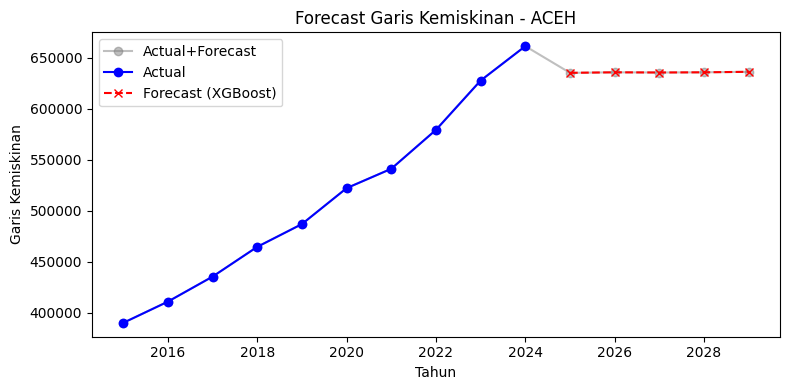

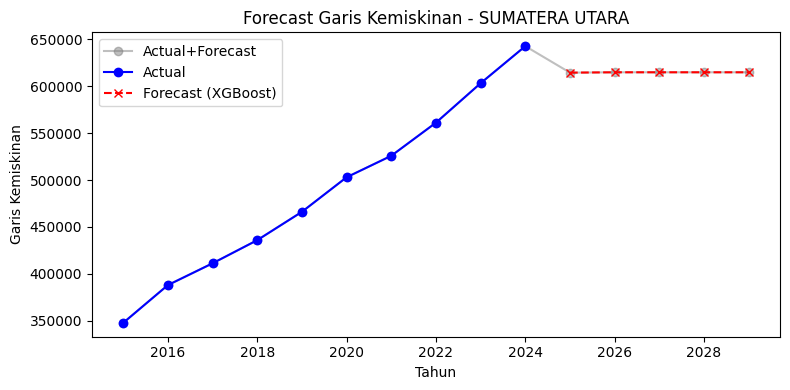

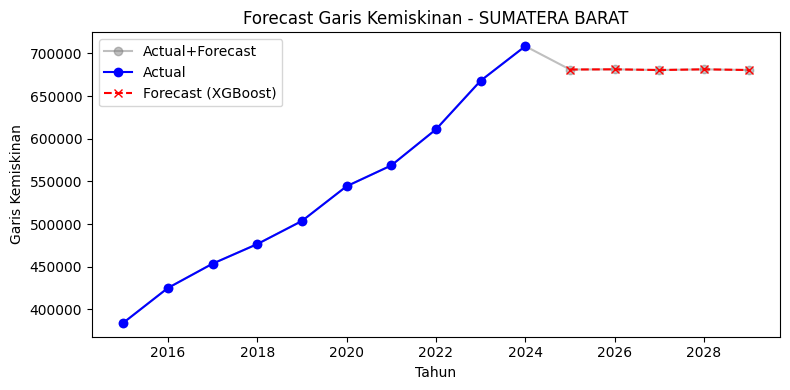

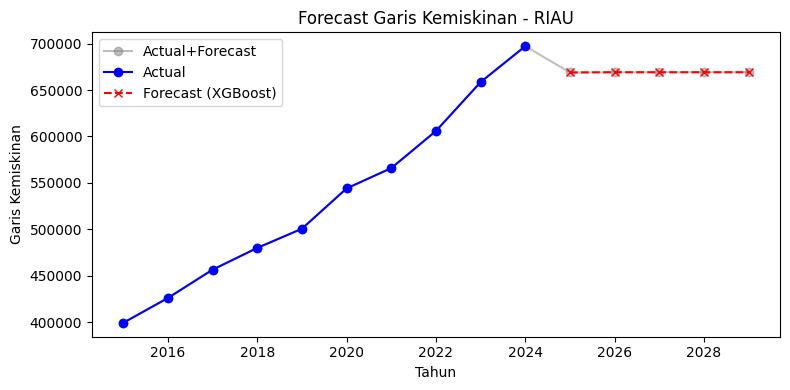

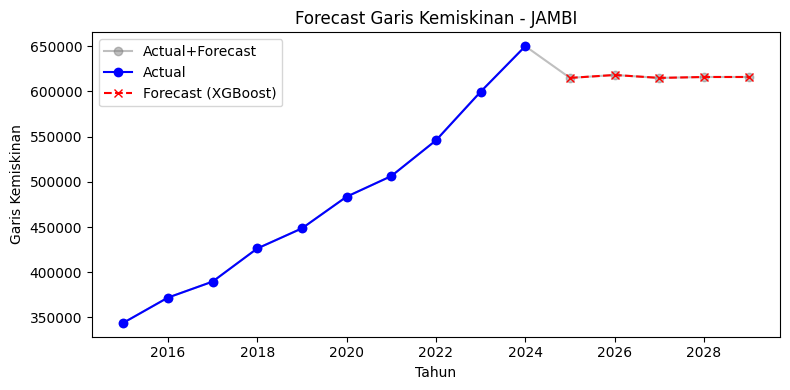

...

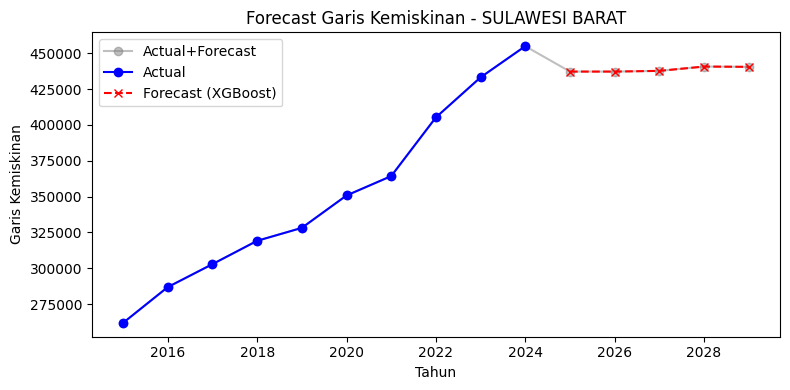

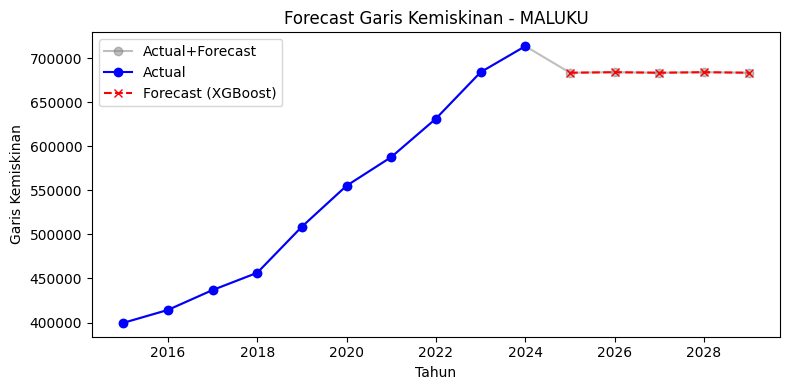

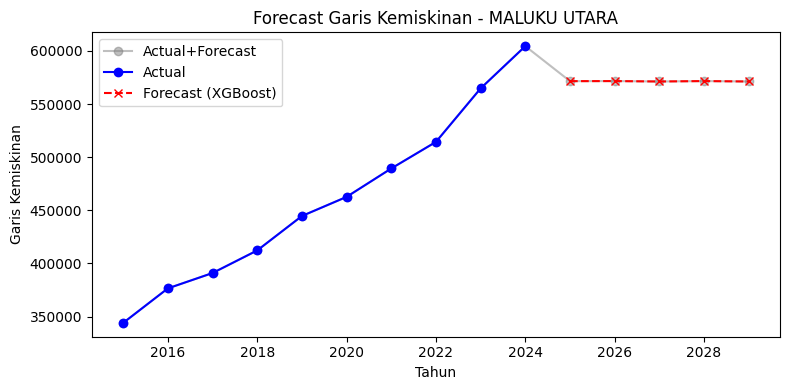

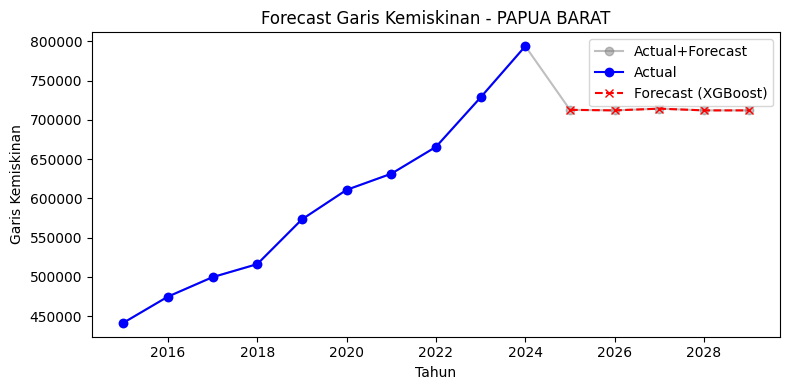

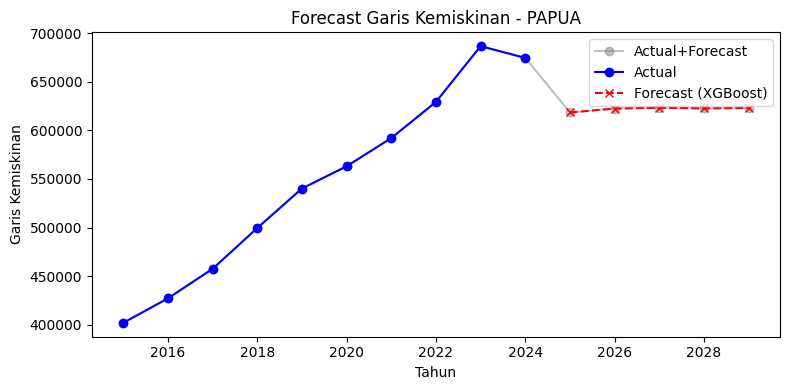

In [ ]:
from xgboost import XGBRegressor

# --- 4. Prediksi Garis Kemiskinan (2025-2029) per provinsi menggunakan XGBoost ---
for prov in all_provinces:
    df_prov = full_df[full_df['Provinsi'] == prov].copy()

    train = df_prov[df_prov['Garis Kemiskinan'].notna()].dropna(subset=feature_cols)
    test = df_prov[(df_prov['Tahun'] >= 2025)].dropna(subset=feature_cols)

    if len(train) > 0 and len(test) > 0:
        X_train = train[feature_cols]
        y_train = train['Garis Kemiskinan']
        X_test = test[feature_cols]

        model = XGBRegressor(n_estimators=100, random_state=42, objective='reg:squarederror')
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)

        full_df.loc[(full_df['Provinsi'] == prov) & (full_df['Tahun'] >= 2025), 'Garis Kemiskinan'] = y_pred

# --- 5. Visualisasi hasil ---
for prov in all_provinces:
    df_prov = full_df[full_df['Provinsi'] == prov].sort_values('Tahun')
    tahun = df_prov['Tahun'].values
    garis = df_prov['Garis Kemiskinan'].values

    plt.figure(figsize=(8, 4))
    plt.plot(tahun, garis, marker='o', color='gray', alpha=0.5, label='Actual+Forecast')
    plt.plot(tahun[tahun <= 2024], garis[tahun <= 2024], marker='o', color='blue', label='Actual')
    plt.plot(tahun[tahun >= 2025], garis[tahun >= 2025], marker='x', linestyle='--', color='red', label='Forecast (XGBoost)')
    plt.title(f'Forecast Garis Kemiskinan - {prov}')
    plt.xlabel('Tahun')
    plt.ylabel('Garis Kemiskinan')
    plt.legend()
    plt.tight_layout()
    plt.show()


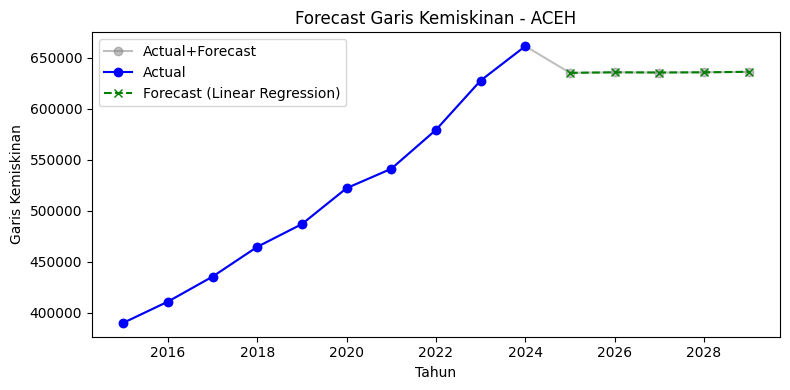

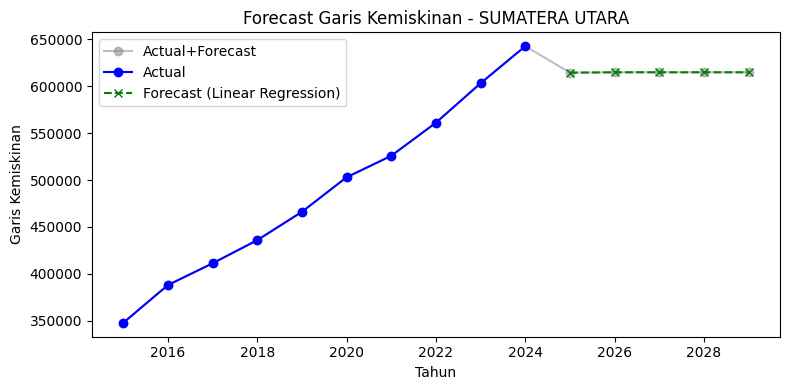

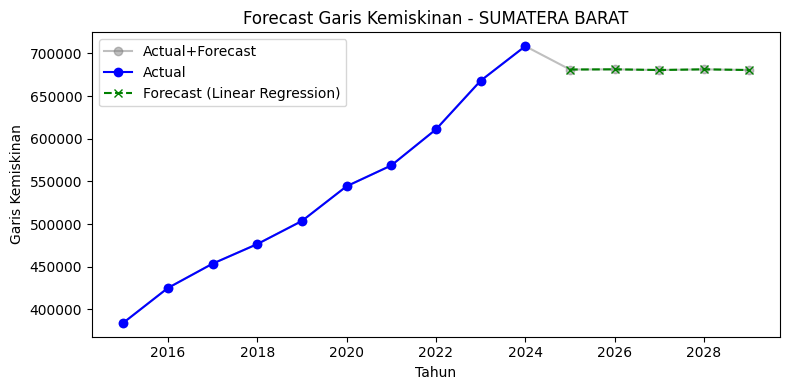

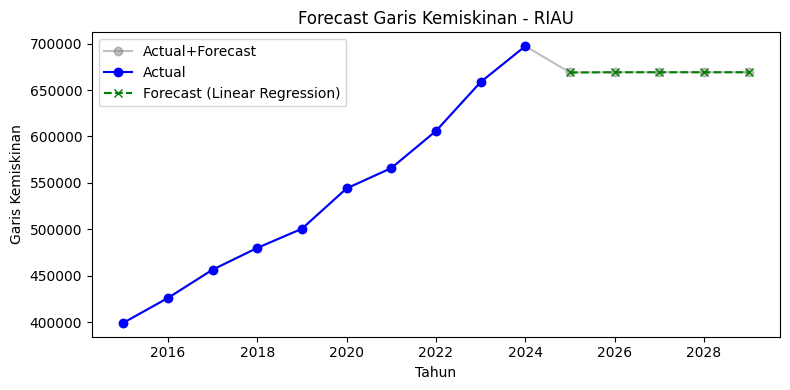

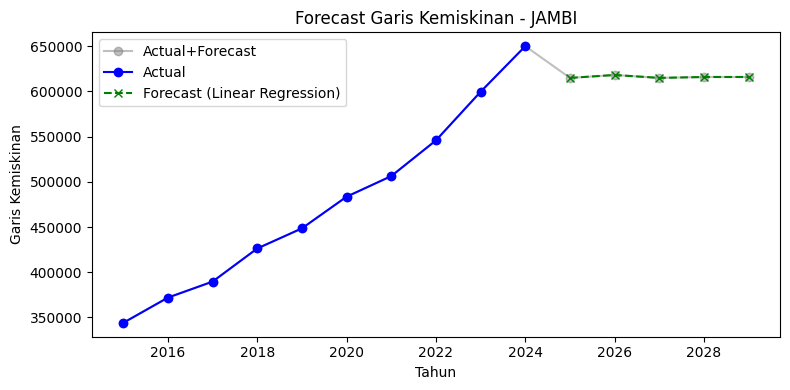

...

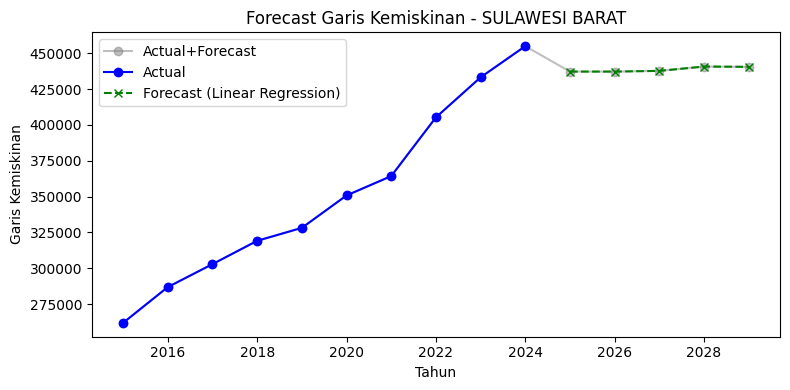

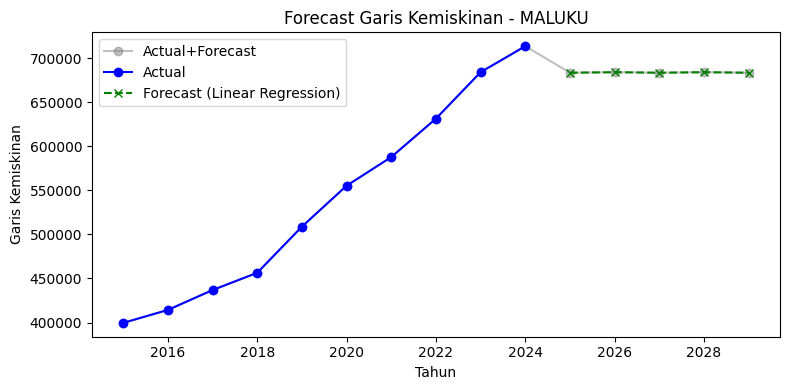

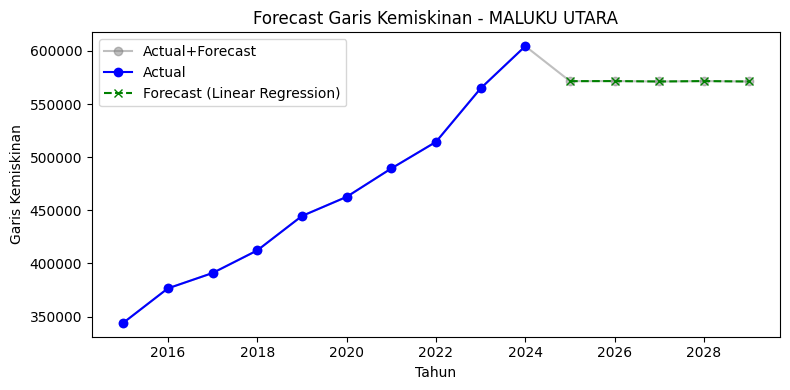

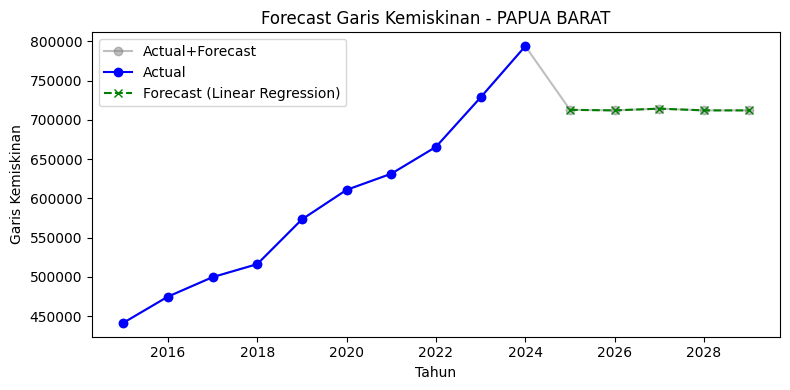

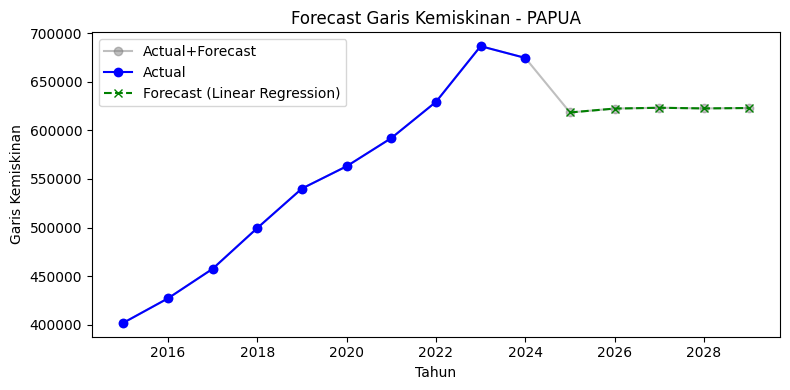

In [ ]:
from sklearn.linear_model import LinearRegression

# --- 4. Prediksi Garis Kemiskinan (2025-2029) per provinsi menggunakan Linear Regression ---
for prov in all_provinces:
    df_prov = full_df[full_df['Provinsi'] == prov].copy()

    train = df_prov[df_prov['Garis Kemiskinan'].notna()].dropna(subset=feature_cols)
    test = df_prov[(df_prov['Tahun'] >= 2025)].dropna(subset=feature_cols)

    if len(train) > 0 and len(test) > 0:
        X_train = train[feature_cols]
        y_train = train['Garis Kemiskinan']
        X_test = test[feature_cols]

        model = LinearRegression()
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)

        full_df.loc[(full_df['Provinsi'] == prov) & (full_df['Tahun'] >= 2025), 'Garis Kemiskinan'] = y_pred

# --- 5. Visualisasi hasil ---
for prov in all_provinces:
    df_prov = full_df[full_df['Provinsi'] == prov].sort_values('Tahun')
    tahun = df_prov['Tahun'].values
    garis = df_prov['Garis Kemiskinan'].values

    plt.figure(figsize=(8, 4))
    plt.plot(tahun, garis, marker='o', color='gray', alpha=0.5, label='Actual+Forecast')
    plt.plot(tahun[tahun <= 2024], garis[tahun <= 2024], marker='o', color='blue', label='Actual')
    plt.plot(tahun[tahun >= 2025], garis[tahun >= 2025], marker='x', linestyle='--', color='green', label='Forecast (Linear Regression)')
    plt.title(f'Forecast Garis Kemiskinan - {prov}')
    plt.xlabel('Tahun')
    plt.ylabel('Garis Kemiskinan')
    plt.legend()
    plt.tight_layout()
    plt.show()


In [ ]:
full_df.tail()

,Provinsi,Tahun,Garis Kemiskinan,Garis Kemiskinan Makanan Perkotaan Semester 1,Garis Kemiskinan Makanan Perkotaan Semester 2,Garis Kemiskinan Makanan Perdesaan Semester 1,Garis Kemiskinan Makanan Perdesaan Semester 2,Garis Kemiskinan Makanan Total Semester 1,Garis Kemiskinan Makanan Total Semester 2,Garis Kemiskinan Non Makanan Perkotaan Semester 1,...,Net Ekspor Triwulan II,Net Ekspor Triwulan III,Net Ekspor Triwulan IV,Net Ekspor Tahunan,PDRB Triwulan I,PDRB Triwulan II,PDRB Triwulan III,PDRB Triwulan IV,PDRB Tahunan,UMP
505,PAPUA,2025,618326.1875,531297.222222,559945.333333,404318.0,413604.0,480233.666667,504056.777778,252707.555556,...,-6384.22,-7536.75,-7689.32,-27963.63,20803.9,21435.14,21500.84,22174.45,85914.33,4840400.0
506,PAPUA,2026,622337.5000,555465.444444,586868.666667,404318.0,413604.0,497976.333333,523904.555556,262870.111111,...,-6384.22,-7536.75,-7689.32,-27963.63,20803.9,21435.14,21500.84,22174.45,85914.33,5105140.0
507,PAPUA,2027,623152.3125,579633.666667,613792.000000,404318.0,413604.0,515719.000000,543752.333333,273032.666667,...,-6384.22,-7536.75,-7689.32,-27963.63,20803.9,21435.14,21500.84,22174.45,85914.33,5369880.0
508,PAPUA,2028,622493.0625,603801.888889,640715.333333,404318.0,413604.0,533461.666667,563600.111111,283195.222222,...,-6384.22,-7536.75,-7689.32,-27963.63,20803.9,21435.14,21500.84,22174.45,85914.33,5634620.0
509,PAPUA,2029,622900.8750,627970.111111,667638.666667,404318.0,413604.0,551204.333333,583447.888889,293357.777778,...,-6384.22,-7536.75,-7689.32,-27963.63,20803.9,21435.14,21500.84,22174.45,85914.33,5899360.0


# Forecasting 14 Features

In [ ]:
from prophet import Prophet
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    mask = y_true != 0
    return np.mean(np.abs((y_true[mask] - y_pred[mask]) / y_true[mask])) * 100

all_years = list(range(2015, 2030))
all_provinces = used_df['Provinsi'].unique()
full_rows = [{'Provinsi': prov, 'Tahun': year} for prov in all_provinces for year in all_years]
full_df = pd.DataFrame(full_rows)
full_df = full_df.merge(used_df, on=['Provinsi', 'Tahun'], how='left')

fitur = [
    'Garis Kemiskinan Makanan Perkotaan Semester 1',
    'Garis Kemiskinan Makanan Perkotaan Semester 2',
    'Garis Kemiskinan Makanan Perdesaan Semester 1',
    'Garis Kemiskinan Makanan Perdesaan Semester 2',
    'Garis Kemiskinan Non Makanan Perdesaan Semester 1',
    'Garis Kemiskinan Non Makanan Perdesaan Semester 2',
    'Pengeluaran Konsumsi Rumah Tangga Tahunan',
    'Pengeluaran Konsumsi LNPRT Tahunan',
    'Pengeluaran Konsumsi Pemerintah Tahunan',
    'Pembentukan Modal Tetap Bruto Tahunan',
    'Perubahan Inventori Tahunan',
    'Net Ekspor Tahunan',
    'PDRB Tahunan',
    'UMP'
]

# Forecast fitur eksternal dengan Prophet
for col in fitur:
    for prov in all_provinces:
        df_train = full_df[(full_df['Provinsi'] == prov) & (full_df['Tahun'] <= 2024)][['Tahun', col]].copy()
        df_train = df_train.rename(columns={'Tahun': 'ds', col: 'y'})
        if df_train['y'].notna().sum() > 2:
            df_train = df_train.dropna()
            df_train['ds'] = pd.to_datetime(df_train['ds'], format='%Y')
            model = Prophet(yearly_seasonality=False, daily_seasonality=False, weekly_seasonality=False)
            model.fit(df_train)
            future = pd.DataFrame({'ds': pd.to_datetime(range(2025, 2030), format='%Y')})
            forecast = model.predict(future)
            forecast_values = forecast['yhat'].values
            for i, year in enumerate(range(2025, 2030)):
                row_idx = (full_df['Provinsi'] == prov) & (full_df['Tahun'] == year)
                full_df.loc[row_idx, col] = forecast_values[i]

# Forecast Garis Kemiskinan dengan Linear Regression
forecast_results = {}

for prov in all_provinces:
    df_prov = full_df[full_df['Provinsi'] == prov].copy()
    train = df_prov[df_prov['Tahun'] <= 2024].dropna(subset=fitur + ['Garis Kemiskinan'])
    test = df_prov[df_prov['Tahun'] >= 2025].dropna(subset=fitur)
    if len(train) > 0 and len(test) > 0:
        X_train = train[fitur]
        y_train = train['Garis Kemiskinan']
        X_test = test[fitur]
        model = LinearRegression()
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        full_df.loc[(full_df['Provinsi'] == prov) & (full_df['Tahun'] >= 2025), 'Garis Kemiskinan'] = y_pred
        forecast_results[prov] = list(zip(test['Tahun'], y_pred))

# Simpan hasil forecast ke TXT
with open("forecast_gariskemiskinan_lrprophet.txt", "w") as f:
    for prov, hasil in forecast_results.items():
        for tahun, pred in hasil:
            f.write(f"{prov} {tahun} = {pred:.2f}\n")

# Evaluasi MAE, RMSE, MAPE per provinsi (train: <=2022, test: >=2023)
mae_list, rmse_list, mape_list = [], [], []

for prov in all_provinces:
    df_prov = full_df[full_df['Provinsi'] == prov].copy()
    train = df_prov[df_prov['Tahun'] <= 2022].dropna(subset=fitur + ['Garis Kemiskinan'])
    test = df_prov[df_prov['Tahun'] >= 2023].dropna(subset=fitur + ['Garis Kemiskinan'])
    if len(train) > 0 and len(test) > 0:
        X_train = train[fitur]
        y_train = train['Garis Kemiskinan']
        X_test = test[fitur]
        y_test = test['Garis Kemiskinan']
        model = LinearRegression()
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        mae = mean_absolute_error(y_test, y_pred)
        rmse = mean_squared_error(y_test, y_pred, squared=False)
        mape = mean_absolute_percentage_error(y_test, y_pred)
        mae_list.append(mae)
        rmse_list.append(rmse)
        mape_list.append(mape)
        print(f"{prov}: MAE={mae:.2f}, RMSE={rmse:.2f}, MAPE={mape:.2f}%")

print(f"\nRata-rata MAE: {np.mean(mae_list):.2f}")
print(f"Rata-rata RMSE: {np.mean(rmse_list):.2f}")
print(f"Rata-rata MAPE: {np.mean(mape_list):.2f}%")

NameError: name 'used_df' is not defined

## Visualization

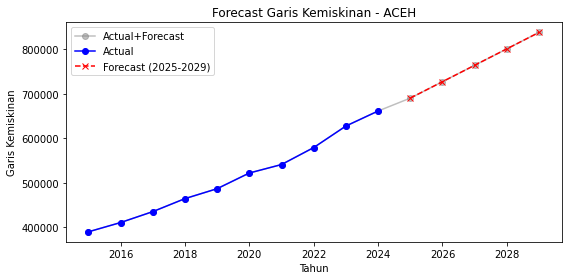

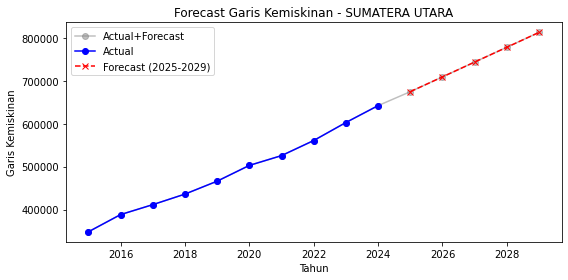

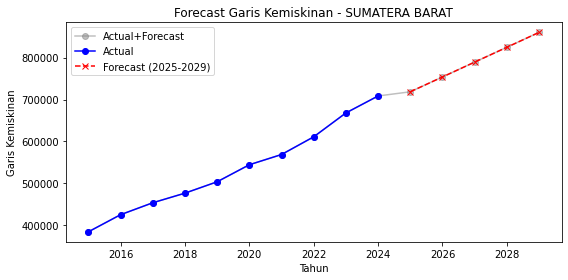

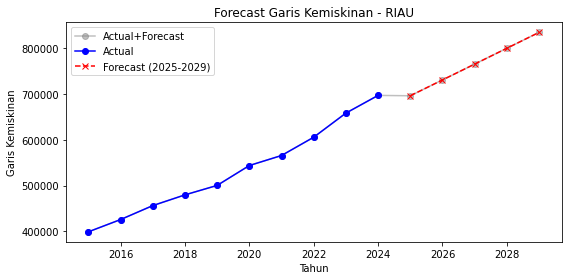

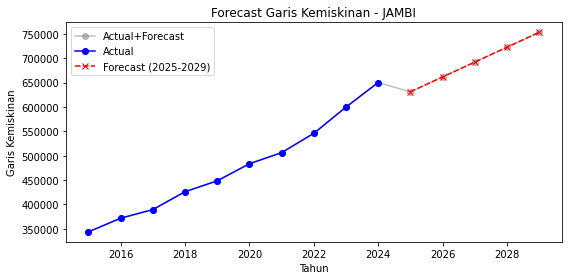

...

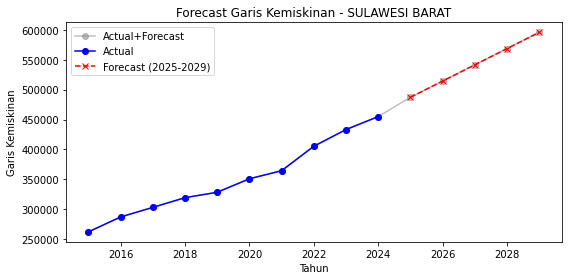

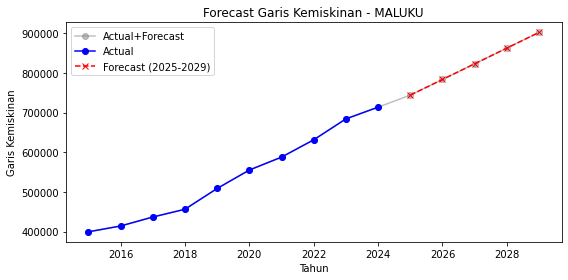

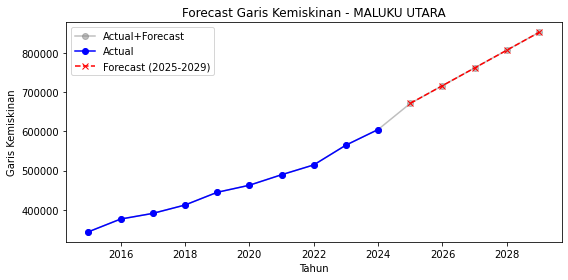

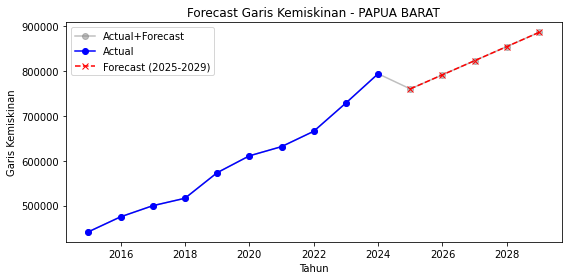

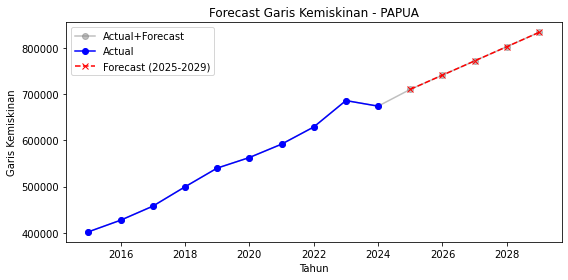

In [ ]:
import matplotlib.pyplot as plt

for prov in all_provinces:
    df_prov = full_df[full_df['Provinsi'] == prov].sort_values('Tahun')
    tahun = df_prov['Tahun'].values
    garis = df_prov['Garis Kemiskinan'].values

    plt.figure(figsize=(8, 4))
    plt.plot(tahun, garis, marker='o', color='gray', alpha=0.5, label='Actual+Forecast')
    plt.plot(tahun[tahun <= 2024], garis[tahun <= 2024], marker='o', color='blue', label='Actual')
    plt.plot(tahun[tahun >= 2025], garis[tahun >= 2025], marker='x', linestyle='--', color='red', label='Forecast (2025-2029)')
    plt.title(f'Forecast Garis Kemiskinan - {prov}')
    plt.xlabel('Tahun')
    plt.ylabel('Garis Kemiskinan')
    plt.legend()
    plt.tight_layout()
    plt.show()

# Correlation

In [ ]:
pip install seaborn


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.2 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


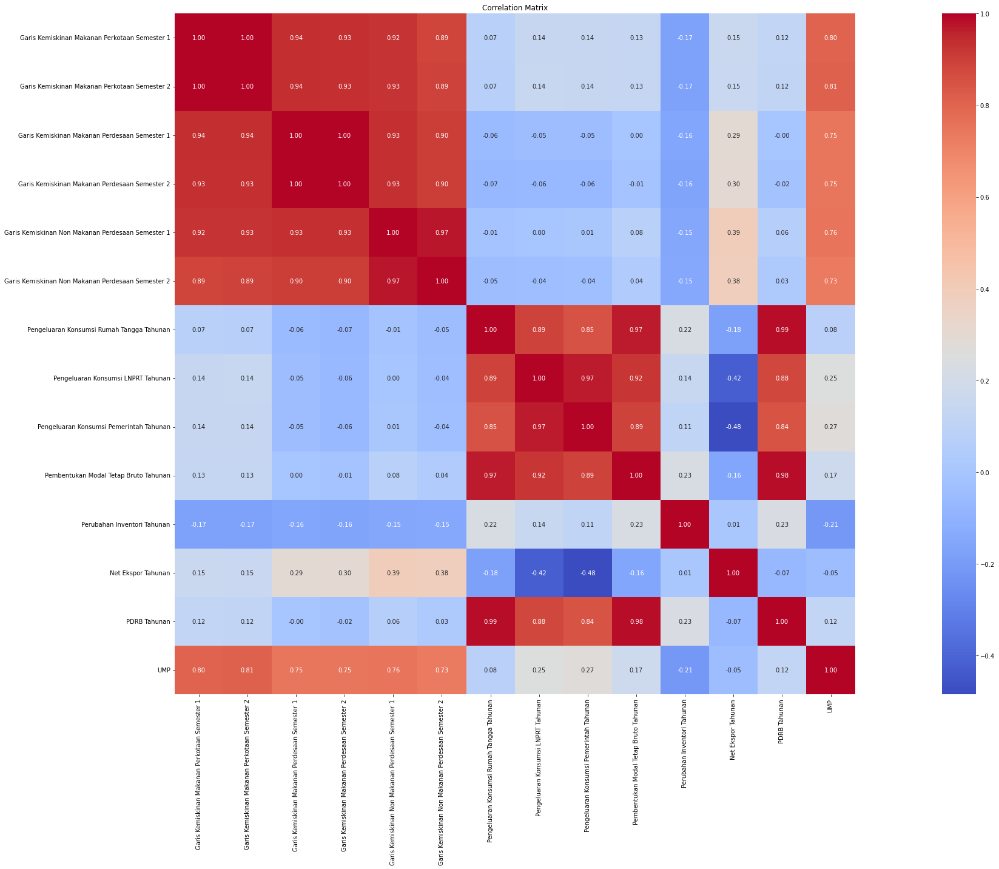

In [ ]:
import seaborn as sns

selected_columns = [
    'Garis Kemiskinan Makanan Perkotaan Semester 1',
    'Garis Kemiskinan Makanan Perkotaan Semester 2',
    'Garis Kemiskinan Makanan Perdesaan Semester 1',
    'Garis Kemiskinan Makanan Perdesaan Semester 2',
    'Garis Kemiskinan Non Makanan Perdesaan Semester 1',
    'Garis Kemiskinan Non Makanan Perdesaan Semester 2',
    'Pengeluaran Konsumsi Rumah Tangga Tahunan',
    'Pengeluaran Konsumsi LNPRT Tahunan',
    'Pengeluaran Konsumsi Pemerintah Tahunan',
    'Pembentukan Modal Tetap Bruto Tahunan',
    'Perubahan Inventori Tahunan',
    'Net Ekspor Tahunan',
    'PDRB Tahunan',
    'UMP'
]

correlation_matrix = full_df[selected_columns].corr()

plt.figure(figsize=(40,20))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", square=True)
plt.title('Correlation Matrix')
plt.tight_layout()
plt.show()

In [39]:
import seaborn as sns
import matplotlib.pyplot as plt

# Hitung korelasi
correlation_matrix = full_df[selected_columns].corr()

plt.figure(figsize=(40, 20))
sns.heatmap(
    correlation_matrix,
    annot=True,
    cmap='coolwarm',
    fmt=".2f",
    square=True,
    annot_kws={"size": 16}  # Ukuran font angka dalam kotak
)

# Perbesar label kolom (x dan y axis)
plt.xticks(fontsize=16, rotation=45, ha='right')
plt.yticks(fontsize=16)

# Perbesar judul
plt.title('Correlation Matrix', fontsize=24, pad=20)

plt.tight_layout()
plt.show()


NameError: name 'selected_columns' is not defined

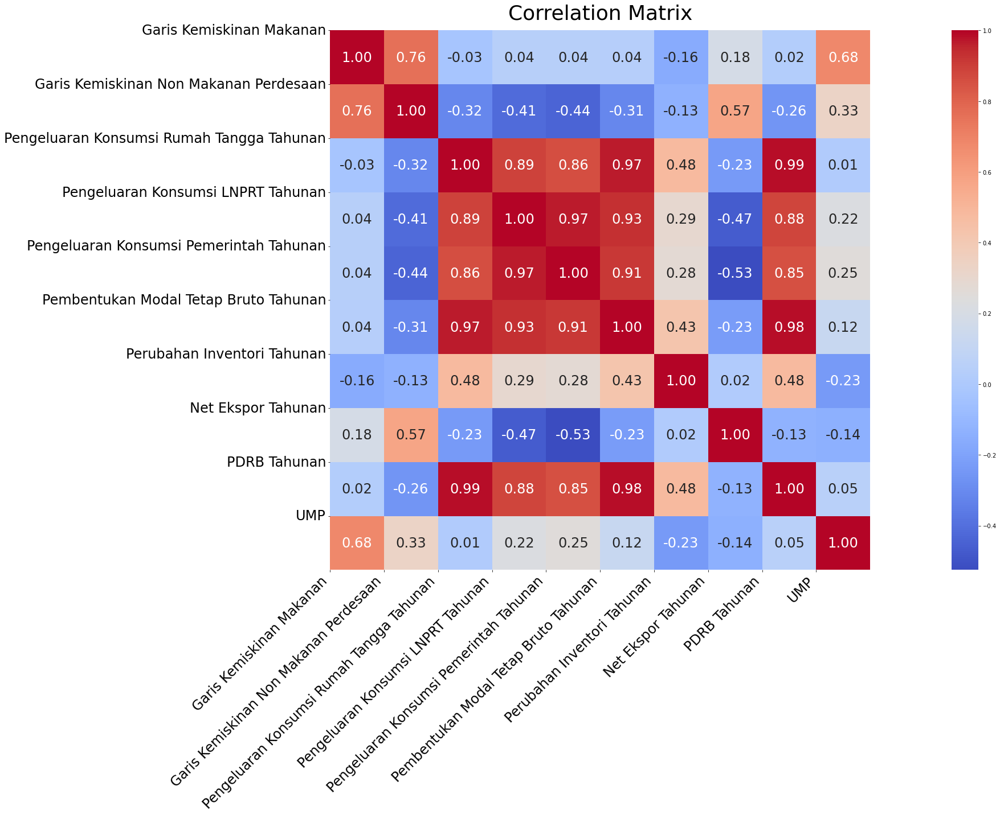

In [50]:


full_df['Garis Kemiskinan Makanan'] = full_df[
    [
        'Garis Kemiskinan Makanan Perkotaan Semester 1',
        'Garis Kemiskinan Makanan Perdesaan Semester 1',
        'Garis Kemiskinan Makanan Perkotaan Semester 2',
        'Garis Kemiskinan Makanan Perdesaan Semester 2'
    ]
].mean(axis=1)       

full_df['Garis Kemiskinan Non Makanan Perdesaan'] = full_df[
    [
        'Garis Kemiskinan Non Makanan Perdesaan Semester 1',
        'Garis Kemiskinan Non Makanan Perdesaan Semester 2'
    ]
].mean(axis=1)      


selected_columns = [
    'Garis Kemiskinan Makanan',
    'Garis Kemiskinan Non Makanan Perdesaan',
    'Pengeluaran Konsumsi Rumah Tangga Tahunan',
    'Pengeluaran Konsumsi LNPRT Tahunan',
    'Pengeluaran Konsumsi Pemerintah Tahunan',
    'Pembentukan Modal Tetap Bruto Tahunan',
    'Perubahan Inventori Tahunan',
    'Net Ekspor Tahunan',
    'PDRB Tahunan',
    'UMP'
]


correlation_matrix = full_df[selected_columns].corr()

plt.figure(figsize=(40, 20))
sns.heatmap(
    correlation_matrix,
    annot=True,
    cmap='coolwarm',
    fmt=".2f",
    square=True,
    annot_kws={"size": 24}
)

# Perbesar dan atur label sumbu x
plt.xticks(
    ticks=range(len(selected_columns)),
    labels=selected_columns,
    fontsize=24,
    rotation=45,
    ha='right'
)

# Perbesar dan atur label sumbu y
plt.yticks(
    ticks=range(len(selected_columns)),
    labels=selected_columns,
    fontsize=24,
    rotation=0
)

plt.title('Correlation Matrix', fontsize=36, pad=20)
plt.tight_layout()
plt.show()